<a href="https://colab.research.google.com/github/zzackkk/Fashion-Clothes-Generation-using-GANS/blob/main/Fashion_clothes_(GANS).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [90]:
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf


In [91]:
from tensorflow.keras.optimizers import Adam

In [92]:
from tensorflow.keras import Sequential, Model
from tensorflow.keras.layers import Flatten, Dense,  Input, Activation,Dropout,LeakyReLU
import tensorflow.keras.datasets
from tensorflow.keras.layers import Reshape
from tensorflow.keras import datasets

In [93]:
def build_discriminator(img_shape=(28,28,1), summary=True):
  model = Sequential()
  model.add(Input(shape=img_shape))
  model.add(Flatten())
  model.add(Dense(512))
  model.add(LeakyReLU(0.3))
  model.add(Dense(256))
  model.add(LeakyReLU(0.3))
  model.add(Dense(1, activation = 'sigmoid'))

  if summary:
    model.summary()
    return model



In [95]:
def build_generator(z_dim=(100), output_shape=(28,28,1), summary=True):
  model= Sequential()
  model.add(Input(shape=z_dim))
  model.add(Dense(256))
  model.add(LeakyReLU(0.3))
  model.add(BatchNormalization(momentum= 0.8))
  model.add(Dense(512))
  model.add(LeakyReLU(0.3))
  model.add(BatchNormalization(momentum= 0.8))
  model.add(Dense(1024))
  model.add(LeakyReLU(0.3))
  model.add(BatchNormalization(momentum= 0.8))
  model.add(Dense(np.prod(output_shape), activation = 'tanh'))
  model.add(Reshape(output_shape))
  if summary:
    model.summary()
    return model



Model: "sequential_17"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_54 (Dense)            (None, 256)               25856     
                                                                 
 leaky_re_lu_39 (LeakyReLU)  (None, 256)               0         
                                                                 
 batch_normalization_27 (Bat  (None, 256)              1024      
 chNormalization)                                                
                                                                 
 dense_55 (Dense)            (None, 512)               131584    
                                                                 
 leaky_re_lu_40 (LeakyReLU)  (None, 512)               0         
                                                                 
 batch_normalization_28 (Bat  (None, 512)              2048      
 chNormalization)                                    

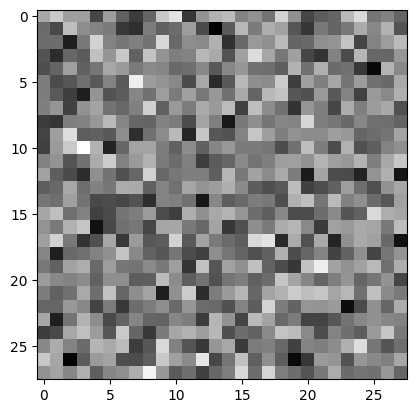

In [96]:
generator = build_generator()

noise= tf.random.normal([1, 100])
generated_image = generator(noise, training= False)

plt.imshow(generated_image[0, :, :, 0], cmap='gray')

Training part ;)

In [97]:
def train(generator=None,discriminator=None,gan_model=None,
          epochs=1000, batch_size=128, sample_interval=50,
          z_dim=100):
    (X_train, _), (_, _) = datasets.fashion_mnist.load_data()
    X_train = X_train / 127.5 - 1
    real_y = np.ones((batch_size, 1))
    fake_y = np.zeros((batch_size, 1))

    for epoch in range(epochs):
        idx = np.random.randint(0, X_train.shape[0], batch_size)
        real_imgs = X_train[idx]
        noise = np.random.normal(0, 1, (batch_size, z_dim))
        fake_imgs = generator.predict(noise)
        disc_loss_real = discriminator.train_on_batch(real_imgs, real_y)
        disc_loss_fake = discriminator.train_on_batch(fake_imgs, fake_y)
        discriminator_loss = 0.5 * np.add(disc_loss_real, disc_loss_fake)
        noise = np.random.normal(0, 1, (batch_size, z_dim))
        gen_loss = gan_model.train_on_batch(noise, real_y)
        print ("%d [Discriminator loss: %f, acc.: %.2f%%] [Generator loss: %f]" % (epoch, discriminator_loss[0], 100*discriminator_loss[1], gen_loss))
        if epoch % sample_interval == 0:
            sample_images(epoch,generator)





label

In [98]:
discriminator = build_discriminator()
discriminator.compile(loss='binary_crossentropy',optimizer=Adam(0.0002, 0.5),metrics=['accuracy'])


Model: "sequential_18"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 flatten_6 (Flatten)         (None, 784)               0         
                                                                 
 dense_58 (Dense)            (None, 512)               401920    
                                                                 
 leaky_re_lu_42 (LeakyReLU)  (None, 512)               0         
                                                                 
 dense_59 (Dense)            (None, 256)               131328    
                                                                 
 leaky_re_lu_43 (LeakyReLU)  (None, 256)               0         
                                                                 
 dense_60 (Dense)            (None, 1)                 257       
                                                                 
Total params: 533,505
Trainable params: 533,505
Non-t

In [99]:
generator=build_generator()

Model: "sequential_19"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_61 (Dense)            (None, 256)               25856     
                                                                 
 leaky_re_lu_44 (LeakyReLU)  (None, 256)               0         
                                                                 
 batch_normalization_30 (Bat  (None, 256)              1024      
 chNormalization)                                                
                                                                 
 dense_62 (Dense)            (None, 512)               131584    
                                                                 
 leaky_re_lu_45 (LeakyReLU)  (None, 512)               0         
                                                                 
 batch_normalization_31 (Bat  (None, 512)              2048      
 chNormalization)                                    

In [100]:
# Noise for generator
z_dim = 100
z = Input(shape=(z_dim,))
img = generator(z)

# Fix the discriminator
discriminator.trainable = False

# Get discriminator output
validity = discriminator(img)

# Stack discriminator on top of generator
gan_model = Model(z, validity)
gan_model.compile(loss='binary_crossentropy', optimizer=Adam(0.0001, 0.5))
gan_model.summary()


Model: "model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_23 (InputLayer)       [(None, 100)]             0         
                                                                 
 sequential_19 (Sequential)  (None, 28, 28, 1)         1493520   
                                                                 
 sequential_18 (Sequential)  (None, 1)                 533505    
                                                                 
Total params: 2,027,025
Trainable params: 1,489,936
Non-trainable params: 537,089
_________________________________________________________________


In [101]:
def sample_images(epoch, generator, z_dim=100,
                  save_output=True,
                  output_dir="/content/drive/MyDrive"):


    r, c = 5, 5
    noise = np.random.normal(0, 1, (r * c, z_dim))
    gen_imgs = generator.predict(noise)

    # Rescale images 0 - 1
    gen_imgs = 0.5 * gen_imgs + 0.5

    # get output shape
    output_shape = len(generator.output_shape)

    fig, axs = plt.subplots(r, c)
    cnt = 0
    for i in range(r):
        for j in range(c):
            if output_shape == 3:
                axs[i, j].imshow(gen_imgs[cnt, :, :], cmap='gray')
            else:
                axs[i, j].imshow(gen_imgs[cnt, :, :, 0], cmap='gray')
            # if model_type == 'cgan':
            #     axs[i, j].set_title("Label: %d" % sampled_labels[cnt])
            axs[i, j].axis('off')
            cnt += 1
    plt.show()
    if save_output:
        fig.savefig("{}/{}.png".format(output_dir, epoch))
    plt.close()




1/1 [==============================] - 0s 18ms/step
0 [Discriminator loss: 0.377762, acc.: 73.44%] [Generator loss: 0.626156]
1/1 [==============================] - 0s 19ms/step


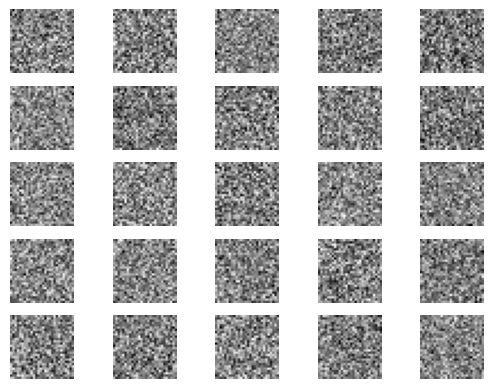

1/1 [==============================] - 0s 20ms/step
1 [Discriminator loss: 0.339171, acc.: 81.25%] [Generator loss: 0.678331]
1/1 [==============================] - 0s 18ms/step
2 [Discriminator loss: 0.347757, acc.: 82.81%] [Generator loss: 0.781277]
1/1 [==============================] - 0s 19ms/step
3 [Discriminator loss: 0.319540, acc.: 82.81%] [Generator loss: 0.897169]
1/1 [==============================] - 0s 23ms/step
4 [Discriminator loss: 0.272233, acc.: 93.75%] [Generator loss: 0.993907]
1/1 [==============================] - 0s 26ms/step
5 [Discriminator loss: 0.240988, acc.: 95.31%] [Generator loss: 1.125351]
1/1 [==============================] - 0s 20ms/step
6 [Discriminator loss: 0.207149, acc.: 100.00%] [Generator loss: 1.341439]
1/1 [==============================] - 0s 35ms/step
7 [Discriminator loss: 0.186926, acc.: 100.00%] [Generator loss: 1.418579]
1/1 [==============================] - 0s 51ms/step
8 [Discriminator loss: 0.179440, acc.: 98.44%] [Generator loss: 

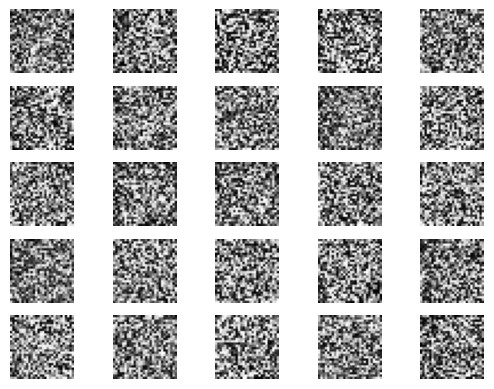

1/1 [==============================] - 0s 18ms/step
201 [Discriminator loss: 0.006321, acc.: 100.00%] [Generator loss: 5.355414]
1/1 [==============================] - 0s 17ms/step
202 [Discriminator loss: 0.006229, acc.: 100.00%] [Generator loss: 5.330160]
1/1 [==============================] - 0s 23ms/step
203 [Discriminator loss: 0.007202, acc.: 100.00%] [Generator loss: 5.237453]
1/1 [==============================] - 0s 18ms/step
204 [Discriminator loss: 0.037997, acc.: 98.44%] [Generator loss: 5.360231]
1/1 [==============================] - 0s 21ms/step
205 [Discriminator loss: 0.098444, acc.: 96.88%] [Generator loss: 4.814370]
1/1 [==============================] - 0s 18ms/step
206 [Discriminator loss: 0.011244, acc.: 100.00%] [Generator loss: 4.767155]
1/1 [==============================] - 0s 25ms/step
207 [Discriminator loss: 0.022338, acc.: 100.00%] [Generator loss: 4.900240]
1/1 [==============================] - 0s 24ms/step
208 [Discriminator loss: 0.028091, acc.: 98.44%

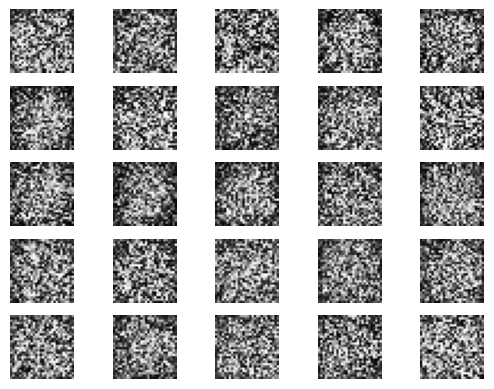

1/1 [==============================] - 0s 28ms/step
401 [Discriminator loss: 0.024157, acc.: 100.00%] [Generator loss: 5.853892]
1/1 [==============================] - 0s 30ms/step
402 [Discriminator loss: 0.072329, acc.: 96.88%] [Generator loss: 4.621062]
1/1 [==============================] - 0s 26ms/step
403 [Discriminator loss: 0.102108, acc.: 96.88%] [Generator loss: 4.131481]
1/1 [==============================] - 0s 30ms/step
404 [Discriminator loss: 0.121399, acc.: 93.75%] [Generator loss: 5.077745]
1/1 [==============================] - 0s 25ms/step
405 [Discriminator loss: 0.017588, acc.: 100.00%] [Generator loss: 5.938616]
1/1 [==============================] - 0s 30ms/step
406 [Discriminator loss: 0.075520, acc.: 98.44%] [Generator loss: 4.578795]
1/1 [==============================] - 0s 30ms/step
407 [Discriminator loss: 0.041707, acc.: 100.00%] [Generator loss: 4.445738]
1/1 [==============================] - 0s 38ms/step
408 [Discriminator loss: 0.049585, acc.: 98.44%] 

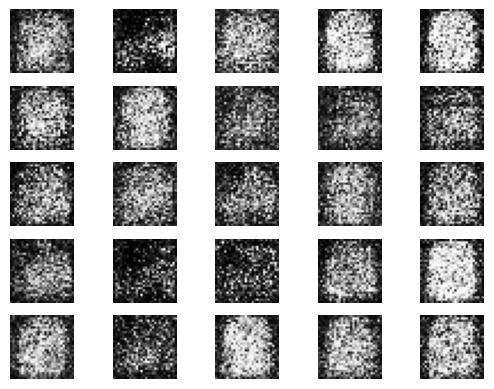

1/1 [==============================] - 0s 23ms/step
601 [Discriminator loss: 0.129058, acc.: 98.44%] [Generator loss: 2.949301]
1/1 [==============================] - 0s 20ms/step
602 [Discriminator loss: 0.539679, acc.: 79.69%] [Generator loss: 2.318137]
1/1 [==============================] - 0s 19ms/step
603 [Discriminator loss: 0.403336, acc.: 84.38%] [Generator loss: 2.039268]
1/1 [==============================] - 0s 22ms/step
604 [Discriminator loss: 0.232334, acc.: 95.31%] [Generator loss: 2.590440]
1/1 [==============================] - 0s 21ms/step
605 [Discriminator loss: 0.461182, acc.: 82.81%] [Generator loss: 2.288588]
1/1 [==============================] - 0s 30ms/step
606 [Discriminator loss: 0.215259, acc.: 93.75%] [Generator loss: 2.543521]
1/1 [==============================] - 0s 37ms/step
607 [Discriminator loss: 0.238093, acc.: 95.31%] [Generator loss: 2.682491]
1/1 [==============================] - 0s 19ms/step
608 [Discriminator loss: 0.509955, acc.: 73.44%] [Ge

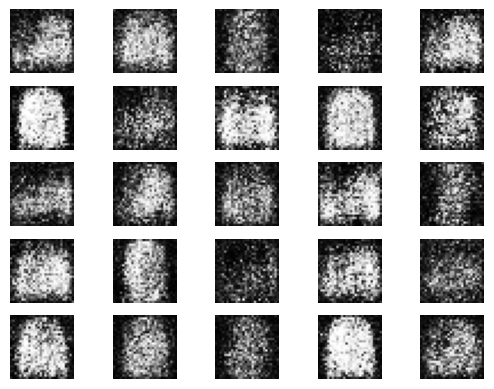

1/1 [==============================] - 0s 28ms/step
801 [Discriminator loss: 0.379946, acc.: 89.06%] [Generator loss: 1.553776]
1/1 [==============================] - 0s 33ms/step
802 [Discriminator loss: 0.443882, acc.: 85.94%] [Generator loss: 1.619609]
1/1 [==============================] - 0s 26ms/step
803 [Discriminator loss: 0.390444, acc.: 73.44%] [Generator loss: 1.788076]
1/1 [==============================] - 0s 36ms/step
804 [Discriminator loss: 0.466835, acc.: 82.81%] [Generator loss: 1.470299]
1/1 [==============================] - 0s 39ms/step
805 [Discriminator loss: 0.482394, acc.: 79.69%] [Generator loss: 1.584211]
1/1 [==============================] - 0s 43ms/step
806 [Discriminator loss: 0.716287, acc.: 67.19%] [Generator loss: 1.133706]
1/1 [==============================] - 0s 39ms/step
807 [Discriminator loss: 0.519366, acc.: 76.56%] [Generator loss: 1.078512]
1/1 [==============================] - 0s 34ms/step
808 [Discriminator loss: 0.486406, acc.: 76.56%] [Ge

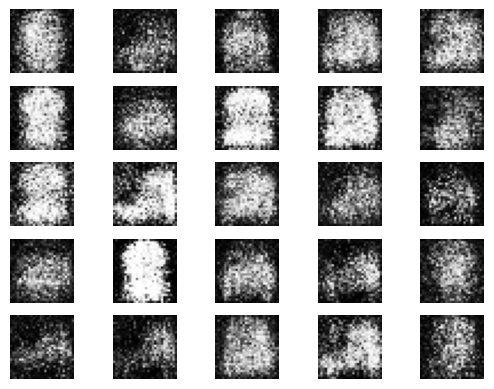

1/1 [==============================] - 0s 20ms/step
1001 [Discriminator loss: 0.419348, acc.: 78.12%] [Generator loss: 1.301569]
1/1 [==============================] - 0s 20ms/step
1002 [Discriminator loss: 0.419530, acc.: 79.69%] [Generator loss: 1.482241]
1/1 [==============================] - 0s 19ms/step
1003 [Discriminator loss: 0.570181, acc.: 71.88%] [Generator loss: 1.180457]
1/1 [==============================] - 0s 20ms/step
1004 [Discriminator loss: 0.504741, acc.: 82.81%] [Generator loss: 1.373605]
1/1 [==============================] - 0s 25ms/step
1005 [Discriminator loss: 0.406863, acc.: 85.94%] [Generator loss: 1.360159]
1/1 [==============================] - 0s 18ms/step
1006 [Discriminator loss: 0.466478, acc.: 79.69%] [Generator loss: 1.318762]
1/1 [==============================] - 0s 28ms/step
1007 [Discriminator loss: 0.557196, acc.: 75.00%] [Generator loss: 1.200769]
1/1 [==============================] - 0s 22ms/step
1008 [Discriminator loss: 0.484410, acc.: 82.

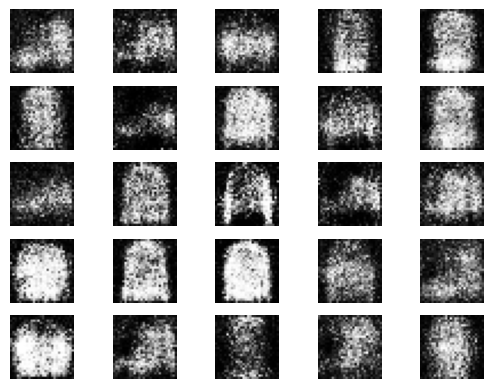

1/1 [==============================] - 0s 26ms/step
1201 [Discriminator loss: 0.533902, acc.: 73.44%] [Generator loss: 1.477407]
1/1 [==============================] - 0s 30ms/step
1202 [Discriminator loss: 0.556752, acc.: 76.56%] [Generator loss: 1.201513]
1/1 [==============================] - 0s 24ms/step
1203 [Discriminator loss: 0.471247, acc.: 78.12%] [Generator loss: 1.209428]
1/1 [==============================] - 0s 44ms/step
1204 [Discriminator loss: 0.375877, acc.: 85.94%] [Generator loss: 1.466398]
1/1 [==============================] - 0s 44ms/step
1205 [Discriminator loss: 0.490812, acc.: 79.69%] [Generator loss: 1.338929]
1/1 [==============================] - 0s 31ms/step
1206 [Discriminator loss: 0.414554, acc.: 82.81%] [Generator loss: 1.429746]
1/1 [==============================] - 0s 36ms/step
1207 [Discriminator loss: 0.525451, acc.: 71.88%] [Generator loss: 1.500086]
1/1 [==============================] - 0s 23ms/step
1208 [Discriminator loss: 0.516302, acc.: 76.

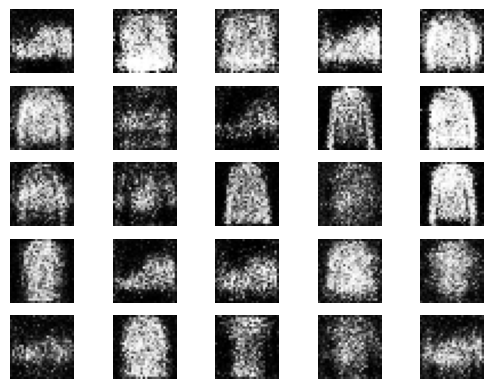

1/1 [==============================] - 0s 21ms/step
1401 [Discriminator loss: 0.471545, acc.: 78.12%] [Generator loss: 1.433286]
1/1 [==============================] - 0s 19ms/step
1402 [Discriminator loss: 0.428055, acc.: 81.25%] [Generator loss: 1.544426]
1/1 [==============================] - 0s 19ms/step
1403 [Discriminator loss: 0.447881, acc.: 84.38%] [Generator loss: 1.404052]
1/1 [==============================] - 0s 19ms/step
1404 [Discriminator loss: 0.457344, acc.: 78.12%] [Generator loss: 1.305080]
1/1 [==============================] - 0s 21ms/step
1405 [Discriminator loss: 0.369381, acc.: 89.06%] [Generator loss: 1.627458]
1/1 [==============================] - 0s 24ms/step
1406 [Discriminator loss: 0.387347, acc.: 82.81%] [Generator loss: 1.541063]
1/1 [==============================] - 0s 19ms/step
1407 [Discriminator loss: 0.423389, acc.: 85.94%] [Generator loss: 1.421444]
1/1 [==============================] - 0s 18ms/step
1408 [Discriminator loss: 0.383079, acc.: 82.

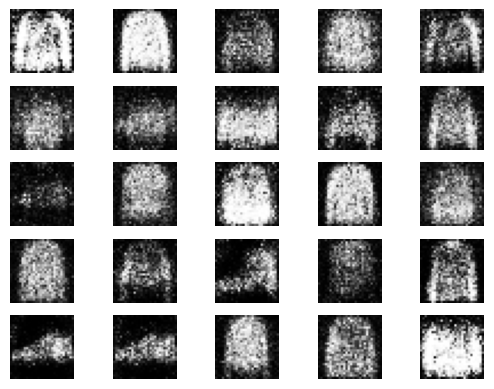

1/1 [==============================] - 0s 29ms/step
1601 [Discriminator loss: 0.596140, acc.: 70.31%] [Generator loss: 1.355014]
1/1 [==============================] - 0s 17ms/step
1602 [Discriminator loss: 0.550323, acc.: 67.19%] [Generator loss: 1.379973]
1/1 [==============================] - 0s 23ms/step
1603 [Discriminator loss: 0.467295, acc.: 79.69%] [Generator loss: 1.286840]
1/1 [==============================] - 0s 19ms/step
1604 [Discriminator loss: 0.496149, acc.: 75.00%] [Generator loss: 1.308823]
1/1 [==============================] - 0s 21ms/step
1605 [Discriminator loss: 0.434162, acc.: 81.25%] [Generator loss: 1.388155]
1/1 [==============================] - 0s 23ms/step
1606 [Discriminator loss: 0.463045, acc.: 82.81%] [Generator loss: 1.526341]
1/1 [==============================] - 0s 27ms/step
1607 [Discriminator loss: 0.516112, acc.: 73.44%] [Generator loss: 1.378833]
1/1 [==============================] - 0s 30ms/step
1608 [Discriminator loss: 0.505594, acc.: 71.

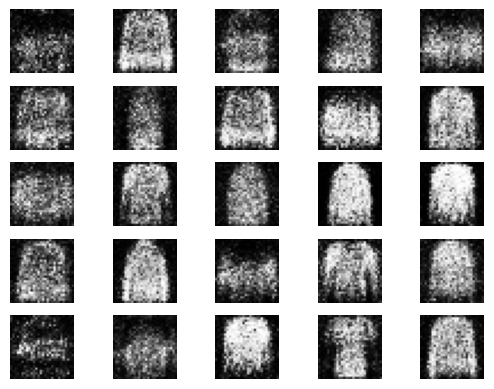

1/1 [==============================] - 0s 27ms/step
1801 [Discriminator loss: 0.506924, acc.: 71.88%] [Generator loss: 1.166634]
1/1 [==============================] - 0s 31ms/step
1802 [Discriminator loss: 0.540656, acc.: 76.56%] [Generator loss: 1.170388]
1/1 [==============================] - 0s 32ms/step
1803 [Discriminator loss: 0.591572, acc.: 67.19%] [Generator loss: 1.247751]
1/1 [==============================] - 0s 28ms/step
1804 [Discriminator loss: 0.582624, acc.: 65.62%] [Generator loss: 1.372876]
1/1 [==============================] - 0s 30ms/step
1805 [Discriminator loss: 0.528150, acc.: 76.56%] [Generator loss: 1.260178]
1/1 [==============================] - 0s 32ms/step
1806 [Discriminator loss: 0.518612, acc.: 75.00%] [Generator loss: 1.314421]
1/1 [==============================] - 0s 38ms/step
1807 [Discriminator loss: 0.479456, acc.: 76.56%] [Generator loss: 1.417255]
1/1 [==============================] - 0s 24ms/step
1808 [Discriminator loss: 0.569802, acc.: 73.

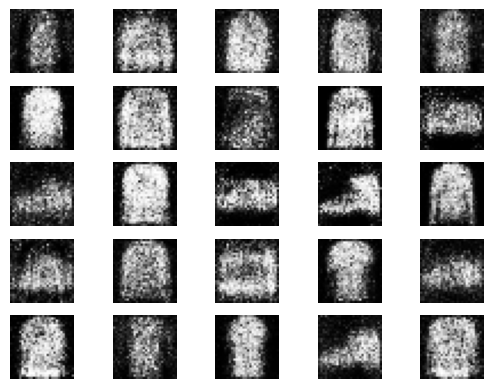

1/1 [==============================] - 0s 19ms/step
2001 [Discriminator loss: 0.529114, acc.: 67.19%] [Generator loss: 1.142261]
1/1 [==============================] - 0s 34ms/step
2002 [Discriminator loss: 0.618802, acc.: 64.06%] [Generator loss: 1.207484]
1/1 [==============================] - 0s 19ms/step
2003 [Discriminator loss: 0.536469, acc.: 73.44%] [Generator loss: 1.267963]
1/1 [==============================] - 0s 23ms/step
2004 [Discriminator loss: 0.548674, acc.: 71.88%] [Generator loss: 1.310493]
1/1 [==============================] - 0s 18ms/step
2005 [Discriminator loss: 0.491524, acc.: 79.69%] [Generator loss: 1.312951]
1/1 [==============================] - 0s 30ms/step
2006 [Discriminator loss: 0.504374, acc.: 79.69%] [Generator loss: 1.165409]
1/1 [==============================] - 0s 21ms/step
2007 [Discriminator loss: 0.620491, acc.: 65.62%] [Generator loss: 1.066388]
1/1 [==============================] - 0s 20ms/step
2008 [Discriminator loss: 0.459651, acc.: 78.

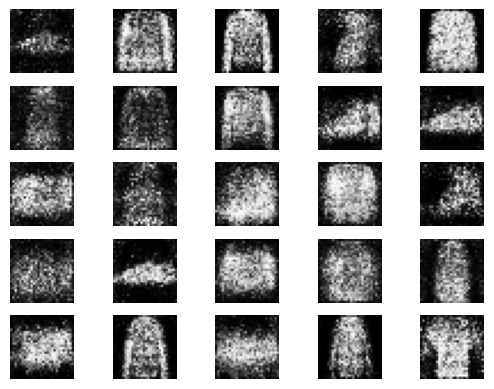

1/1 [==============================] - 0s 29ms/step
2201 [Discriminator loss: 0.496385, acc.: 76.56%] [Generator loss: 1.295231]
1/1 [==============================] - 0s 31ms/step
2202 [Discriminator loss: 0.498593, acc.: 76.56%] [Generator loss: 1.245016]
1/1 [==============================] - 0s 26ms/step
2203 [Discriminator loss: 0.536142, acc.: 79.69%] [Generator loss: 1.238719]
1/1 [==============================] - 0s 39ms/step
2204 [Discriminator loss: 0.574971, acc.: 78.12%] [Generator loss: 1.027813]
1/1 [==============================] - 0s 33ms/step
2205 [Discriminator loss: 0.543824, acc.: 71.88%] [Generator loss: 1.158309]
1/1 [==============================] - 0s 30ms/step
2206 [Discriminator loss: 0.566959, acc.: 73.44%] [Generator loss: 1.073814]
1/1 [==============================] - 0s 31ms/step
2207 [Discriminator loss: 0.494085, acc.: 73.44%] [Generator loss: 1.181679]
1/1 [==============================] - 0s 26ms/step
2208 [Discriminator loss: 0.474115, acc.: 76.

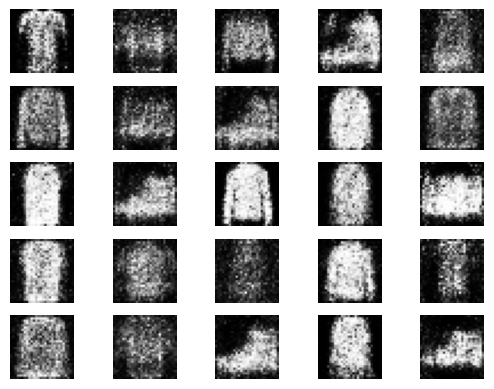

1/1 [==============================] - 0s 22ms/step
2401 [Discriminator loss: 0.525257, acc.: 71.88%] [Generator loss: 1.210372]
1/1 [==============================] - 0s 18ms/step
2402 [Discriminator loss: 0.546178, acc.: 73.44%] [Generator loss: 1.204493]
1/1 [==============================] - 0s 23ms/step
2403 [Discriminator loss: 0.493431, acc.: 75.00%] [Generator loss: 1.083206]
1/1 [==============================] - 0s 19ms/step
2404 [Discriminator loss: 0.484472, acc.: 78.12%] [Generator loss: 1.238323]
1/1 [==============================] - 0s 26ms/step
2405 [Discriminator loss: 0.517578, acc.: 75.00%] [Generator loss: 1.235477]
1/1 [==============================] - 0s 28ms/step
2406 [Discriminator loss: 0.464877, acc.: 81.25%] [Generator loss: 1.320984]
1/1 [==============================] - 0s 23ms/step
2407 [Discriminator loss: 0.551245, acc.: 67.19%] [Generator loss: 1.378536]
1/1 [==============================] - 0s 18ms/step
2408 [Discriminator loss: 0.531942, acc.: 73.

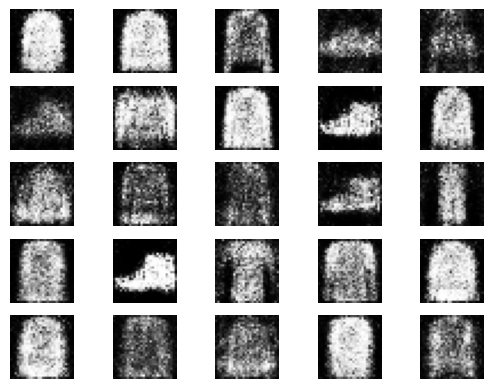

1/1 [==============================] - 0s 29ms/step
2601 [Discriminator loss: 0.528220, acc.: 76.56%] [Generator loss: 1.235091]
1/1 [==============================] - 0s 29ms/step
2602 [Discriminator loss: 0.534677, acc.: 75.00%] [Generator loss: 1.243094]
1/1 [==============================] - 0s 33ms/step
2603 [Discriminator loss: 0.525246, acc.: 70.31%] [Generator loss: 1.135043]
1/1 [==============================] - 0s 32ms/step
2604 [Discriminator loss: 0.575517, acc.: 70.31%] [Generator loss: 1.193344]
1/1 [==============================] - 0s 36ms/step
2605 [Discriminator loss: 0.592757, acc.: 64.06%] [Generator loss: 1.143542]
1/1 [==============================] - 0s 35ms/step
2606 [Discriminator loss: 0.404919, acc.: 87.50%] [Generator loss: 1.156885]
1/1 [==============================] - 0s 34ms/step
2607 [Discriminator loss: 0.563821, acc.: 65.62%] [Generator loss: 1.250395]
1/1 [==============================] - 0s 37ms/step
2608 [Discriminator loss: 0.476988, acc.: 76.

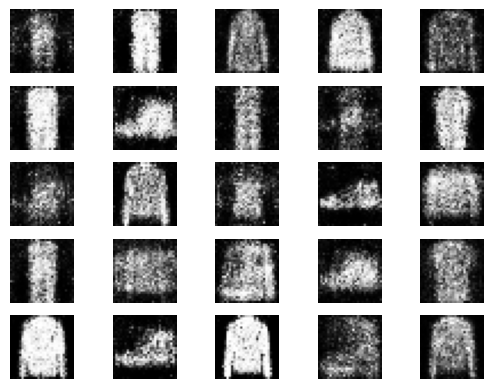

1/1 [==============================] - 0s 30ms/step
2801 [Discriminator loss: 0.538207, acc.: 78.12%] [Generator loss: 1.115749]
1/1 [==============================] - 0s 28ms/step
2802 [Discriminator loss: 0.514850, acc.: 76.56%] [Generator loss: 1.203867]
1/1 [==============================] - 0s 34ms/step
2803 [Discriminator loss: 0.546756, acc.: 73.44%] [Generator loss: 1.202518]
1/1 [==============================] - 0s 31ms/step
2804 [Discriminator loss: 0.453158, acc.: 79.69%] [Generator loss: 1.135386]
1/1 [==============================] - 0s 35ms/step
2805 [Discriminator loss: 0.611490, acc.: 64.06%] [Generator loss: 1.194911]
1/1 [==============================] - 0s 28ms/step
2806 [Discriminator loss: 0.433408, acc.: 82.81%] [Generator loss: 1.150613]
1/1 [==============================] - 0s 28ms/step
2807 [Discriminator loss: 0.494308, acc.: 71.88%] [Generator loss: 1.223968]
1/1 [==============================] - 0s 32ms/step
2808 [Discriminator loss: 0.510218, acc.: 76.

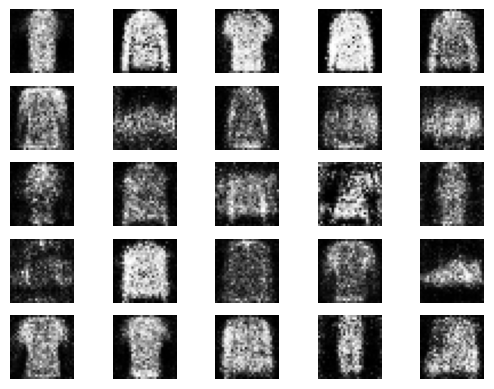

1/1 [==============================] - 0s 31ms/step
3001 [Discriminator loss: 0.573068, acc.: 73.44%] [Generator loss: 1.216536]
1/1 [==============================] - 0s 26ms/step
3002 [Discriminator loss: 0.513881, acc.: 71.88%] [Generator loss: 1.247481]
1/1 [==============================] - 0s 42ms/step
3003 [Discriminator loss: 0.561294, acc.: 73.44%] [Generator loss: 1.262281]
1/1 [==============================] - 0s 30ms/step
3004 [Discriminator loss: 0.542853, acc.: 67.19%] [Generator loss: 1.148826]
1/1 [==============================] - 0s 32ms/step
3005 [Discriminator loss: 0.515032, acc.: 78.12%] [Generator loss: 1.214690]
1/1 [==============================] - 0s 32ms/step
3006 [Discriminator loss: 0.499046, acc.: 81.25%] [Generator loss: 1.430410]
1/1 [==============================] - 0s 40ms/step
3007 [Discriminator loss: 0.544064, acc.: 73.44%] [Generator loss: 1.046234]
1/1 [==============================] - 0s 36ms/step
3008 [Discriminator loss: 0.552372, acc.: 67.

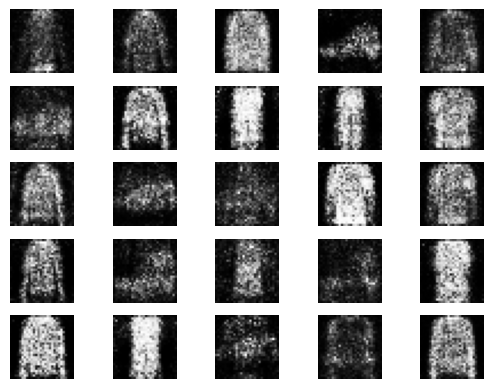

1/1 [==============================] - 0s 20ms/step
3201 [Discriminator loss: 0.566927, acc.: 70.31%] [Generator loss: 1.188108]
1/1 [==============================] - 0s 19ms/step
3202 [Discriminator loss: 0.521405, acc.: 73.44%] [Generator loss: 1.220042]
1/1 [==============================] - 0s 21ms/step
3203 [Discriminator loss: 0.538724, acc.: 70.31%] [Generator loss: 1.300363]
1/1 [==============================] - 0s 26ms/step
3204 [Discriminator loss: 0.497348, acc.: 75.00%] [Generator loss: 1.167787]
1/1 [==============================] - 0s 19ms/step
3205 [Discriminator loss: 0.532694, acc.: 79.69%] [Generator loss: 1.172611]
1/1 [==============================] - 0s 18ms/step
3206 [Discriminator loss: 0.512253, acc.: 70.31%] [Generator loss: 1.223537]
1/1 [==============================] - 0s 20ms/step
3207 [Discriminator loss: 0.541295, acc.: 71.88%] [Generator loss: 1.283006]
1/1 [==============================] - 0s 27ms/step
3208 [Discriminator loss: 0.592507, acc.: 64.

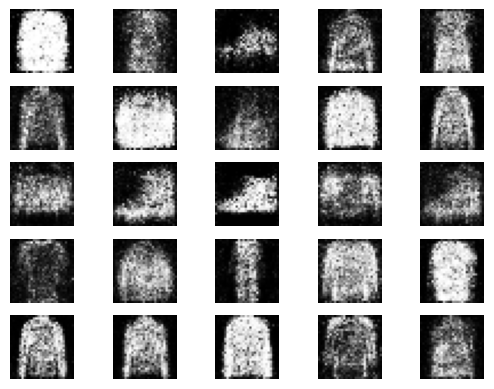

1/1 [==============================] - 0s 38ms/step
3401 [Discriminator loss: 0.614752, acc.: 62.50%] [Generator loss: 1.179368]
1/1 [==============================] - 0s 34ms/step
3402 [Discriminator loss: 0.550672, acc.: 70.31%] [Generator loss: 1.120119]
1/1 [==============================] - 0s 34ms/step
3403 [Discriminator loss: 0.527797, acc.: 76.56%] [Generator loss: 1.231067]
1/1 [==============================] - 0s 34ms/step
3404 [Discriminator loss: 0.541837, acc.: 65.62%] [Generator loss: 1.303593]
1/1 [==============================] - 0s 34ms/step
3405 [Discriminator loss: 0.603765, acc.: 68.75%] [Generator loss: 1.162911]
1/1 [==============================] - 0s 39ms/step
3406 [Discriminator loss: 0.612721, acc.: 67.19%] [Generator loss: 1.108000]
1/1 [==============================] - 0s 35ms/step
3407 [Discriminator loss: 0.552029, acc.: 67.19%] [Generator loss: 1.274299]
1/1 [==============================] - 0s 56ms/step
3408 [Discriminator loss: 0.574788, acc.: 64.

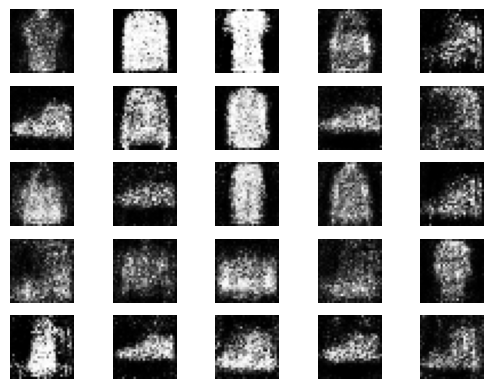

1/1 [==============================] - 0s 24ms/step
3601 [Discriminator loss: 0.516168, acc.: 76.56%] [Generator loss: 1.086629]
1/1 [==============================] - 0s 24ms/step
3602 [Discriminator loss: 0.646316, acc.: 59.38%] [Generator loss: 1.227584]
1/1 [==============================] - 0s 24ms/step
3603 [Discriminator loss: 0.632089, acc.: 67.19%] [Generator loss: 1.109301]
1/1 [==============================] - 0s 24ms/step
3604 [Discriminator loss: 0.505216, acc.: 78.12%] [Generator loss: 1.196137]
1/1 [==============================] - 0s 26ms/step
3605 [Discriminator loss: 0.556134, acc.: 71.88%] [Generator loss: 1.267308]
1/1 [==============================] - 0s 35ms/step
3606 [Discriminator loss: 0.554241, acc.: 67.19%] [Generator loss: 1.292452]
1/1 [==============================] - 0s 27ms/step
3607 [Discriminator loss: 0.627269, acc.: 59.38%] [Generator loss: 1.205588]
1/1 [==============================] - 0s 23ms/step
3608 [Discriminator loss: 0.611477, acc.: 65.

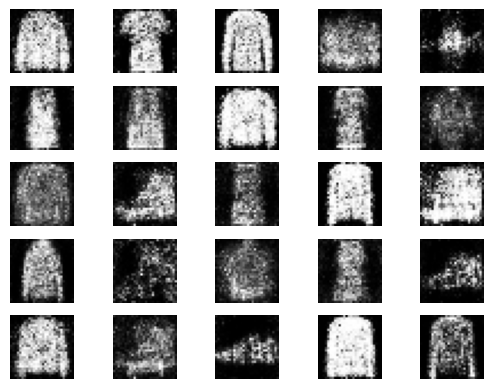

1/1 [==============================] - 0s 24ms/step
3801 [Discriminator loss: 0.526464, acc.: 76.56%] [Generator loss: 1.192238]
1/1 [==============================] - 0s 27ms/step
3802 [Discriminator loss: 0.481319, acc.: 82.81%] [Generator loss: 1.244112]
1/1 [==============================] - 0s 46ms/step
3803 [Discriminator loss: 0.633014, acc.: 62.50%] [Generator loss: 1.093191]
1/1 [==============================] - 0s 26ms/step
3804 [Discriminator loss: 0.628922, acc.: 68.75%] [Generator loss: 1.052379]
1/1 [==============================] - 0s 24ms/step
3805 [Discriminator loss: 0.542626, acc.: 75.00%] [Generator loss: 1.064579]
1/1 [==============================] - 0s 23ms/step
3806 [Discriminator loss: 0.510476, acc.: 76.56%] [Generator loss: 1.381471]
1/1 [==============================] - 0s 24ms/step
3807 [Discriminator loss: 0.572454, acc.: 70.31%] [Generator loss: 1.180356]
1/1 [==============================] - 0s 30ms/step
3808 [Discriminator loss: 0.557439, acc.: 67.

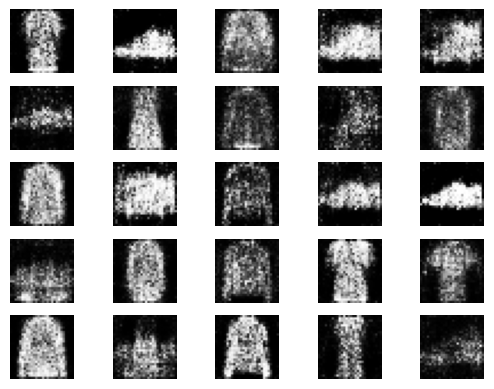

1/1 [==============================] - 0s 25ms/step
4001 [Discriminator loss: 0.559457, acc.: 68.75%] [Generator loss: 1.187137]
1/1 [==============================] - 0s 27ms/step
4002 [Discriminator loss: 0.600516, acc.: 64.06%] [Generator loss: 1.130166]
1/1 [==============================] - 0s 29ms/step
4003 [Discriminator loss: 0.534057, acc.: 68.75%] [Generator loss: 1.210780]
1/1 [==============================] - 0s 34ms/step
4004 [Discriminator loss: 0.639991, acc.: 65.62%] [Generator loss: 1.090459]
1/1 [==============================] - 0s 38ms/step
4005 [Discriminator loss: 0.567945, acc.: 68.75%] [Generator loss: 1.203548]
1/1 [==============================] - 0s 46ms/step
4006 [Discriminator loss: 0.536116, acc.: 73.44%] [Generator loss: 1.291215]
1/1 [==============================] - 0s 42ms/step
4007 [Discriminator loss: 0.615346, acc.: 53.12%] [Generator loss: 1.370128]
1/1 [==============================] - 0s 42ms/step
4008 [Discriminator loss: 0.490307, acc.: 73.

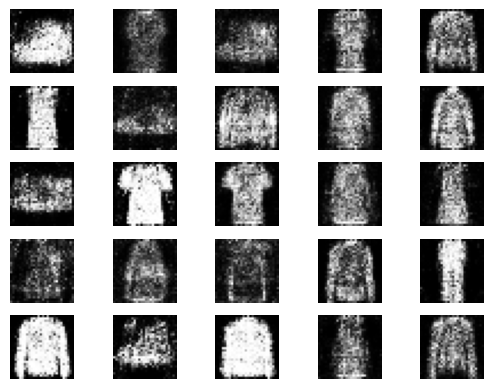

1/1 [==============================] - 0s 57ms/step
4201 [Discriminator loss: 0.565370, acc.: 67.19%] [Generator loss: 1.129972]
1/1 [==============================] - 0s 47ms/step
4202 [Discriminator loss: 0.525248, acc.: 71.88%] [Generator loss: 1.219133]
1/1 [==============================] - 0s 27ms/step
4203 [Discriminator loss: 0.668132, acc.: 62.50%] [Generator loss: 1.272161]
1/1 [==============================] - 0s 30ms/step
4204 [Discriminator loss: 0.591284, acc.: 62.50%] [Generator loss: 1.217615]
1/1 [==============================] - 0s 27ms/step
4205 [Discriminator loss: 0.585055, acc.: 64.06%] [Generator loss: 1.231160]
1/1 [==============================] - 0s 29ms/step
4206 [Discriminator loss: 0.550696, acc.: 71.88%] [Generator loss: 1.247414]
1/1 [==============================] - 0s 26ms/step
4207 [Discriminator loss: 0.628647, acc.: 68.75%] [Generator loss: 1.324653]
1/1 [==============================] - 0s 24ms/step
4208 [Discriminator loss: 0.472524, acc.: 73.

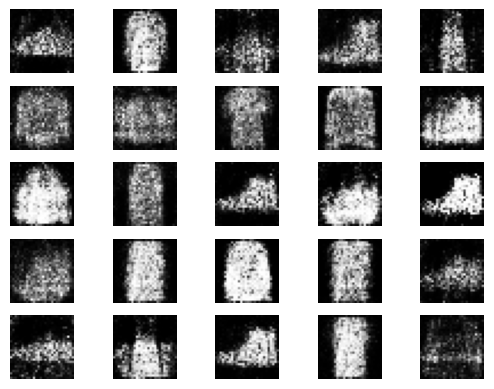

1/1 [==============================] - 0s 48ms/step
4401 [Discriminator loss: 0.503048, acc.: 76.56%] [Generator loss: 1.156777]
1/1 [==============================] - 0s 39ms/step
4402 [Discriminator loss: 0.650134, acc.: 60.94%] [Generator loss: 1.173409]
1/1 [==============================] - 0s 38ms/step
4403 [Discriminator loss: 0.614222, acc.: 62.50%] [Generator loss: 1.116951]
1/1 [==============================] - 0s 29ms/step
4404 [Discriminator loss: 0.521562, acc.: 81.25%] [Generator loss: 1.159494]
1/1 [==============================] - 0s 50ms/step
4405 [Discriminator loss: 0.519190, acc.: 76.56%] [Generator loss: 1.097470]
1/1 [==============================] - 0s 33ms/step
4406 [Discriminator loss: 0.538574, acc.: 75.00%] [Generator loss: 1.240072]
1/1 [==============================] - 0s 42ms/step
4407 [Discriminator loss: 0.565630, acc.: 68.75%] [Generator loss: 1.087367]
1/1 [==============================] - 0s 40ms/step
4408 [Discriminator loss: 0.530271, acc.: 68.

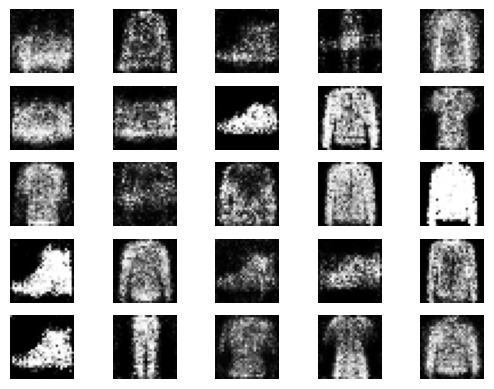

1/1 [==============================] - 0s 27ms/step
4601 [Discriminator loss: 0.464391, acc.: 79.69%] [Generator loss: 1.216256]
1/1 [==============================] - 0s 28ms/step
4602 [Discriminator loss: 0.530108, acc.: 71.88%] [Generator loss: 1.183388]
1/1 [==============================] - 0s 23ms/step
4603 [Discriminator loss: 0.635618, acc.: 62.50%] [Generator loss: 1.147084]
1/1 [==============================] - 0s 32ms/step
4604 [Discriminator loss: 0.611258, acc.: 67.19%] [Generator loss: 1.223025]
1/1 [==============================] - 0s 26ms/step
4605 [Discriminator loss: 0.547045, acc.: 71.88%] [Generator loss: 1.099196]
1/1 [==============================] - 0s 37ms/step
4606 [Discriminator loss: 0.576246, acc.: 64.06%] [Generator loss: 1.162757]
1/1 [==============================] - 0s 25ms/step
4607 [Discriminator loss: 0.530879, acc.: 73.44%] [Generator loss: 1.281039]
1/1 [==============================] - 0s 29ms/step
4608 [Discriminator loss: 0.544501, acc.: 75.

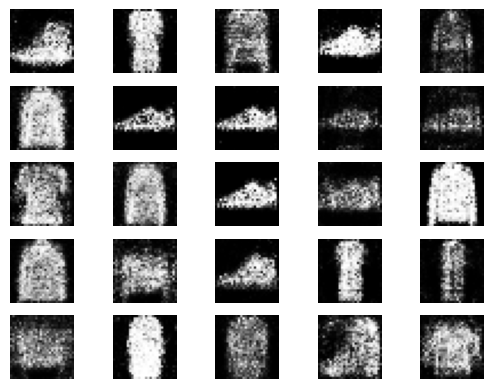

1/1 [==============================] - 0s 30ms/step
4801 [Discriminator loss: 0.629798, acc.: 59.38%] [Generator loss: 1.018882]
1/1 [==============================] - 0s 29ms/step
4802 [Discriminator loss: 0.552328, acc.: 70.31%] [Generator loss: 1.106431]
1/1 [==============================] - 0s 37ms/step
4803 [Discriminator loss: 0.558376, acc.: 70.31%] [Generator loss: 1.276872]
1/1 [==============================] - 0s 30ms/step
4804 [Discriminator loss: 0.573487, acc.: 71.88%] [Generator loss: 1.125513]
1/1 [==============================] - 0s 29ms/step
4805 [Discriminator loss: 0.569222, acc.: 71.88%] [Generator loss: 1.150776]
1/1 [==============================] - 0s 37ms/step
4806 [Discriminator loss: 0.557240, acc.: 67.19%] [Generator loss: 1.146435]
1/1 [==============================] - 0s 44ms/step
4807 [Discriminator loss: 0.543139, acc.: 73.44%] [Generator loss: 1.177258]
1/1 [==============================] - 0s 53ms/step
4808 [Discriminator loss: 0.562109, acc.: 65.

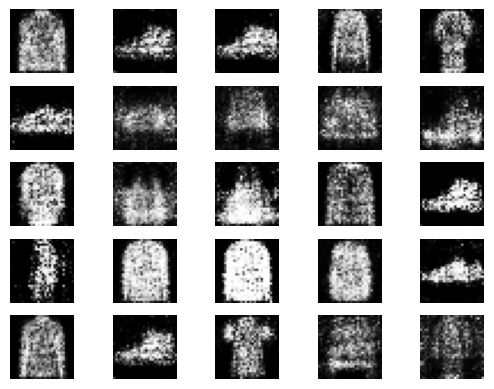

1/1 [==============================] - 0s 33ms/step
5001 [Discriminator loss: 0.651517, acc.: 59.38%] [Generator loss: 1.157445]
1/1 [==============================] - 0s 24ms/step
5002 [Discriminator loss: 0.489034, acc.: 78.12%] [Generator loss: 1.241243]
1/1 [==============================] - 0s 28ms/step
5003 [Discriminator loss: 0.544407, acc.: 73.44%] [Generator loss: 1.201797]
1/1 [==============================] - 0s 26ms/step
5004 [Discriminator loss: 0.546794, acc.: 71.88%] [Generator loss: 1.359205]
1/1 [==============================] - 0s 28ms/step
5005 [Discriminator loss: 0.503807, acc.: 70.31%] [Generator loss: 1.306957]
1/1 [==============================] - 0s 30ms/step
5006 [Discriminator loss: 0.555124, acc.: 73.44%] [Generator loss: 1.179235]
1/1 [==============================] - 0s 37ms/step
5007 [Discriminator loss: 0.554295, acc.: 64.06%] [Generator loss: 1.144091]
1/1 [==============================] - 0s 30ms/step
5008 [Discriminator loss: 0.506833, acc.: 75.

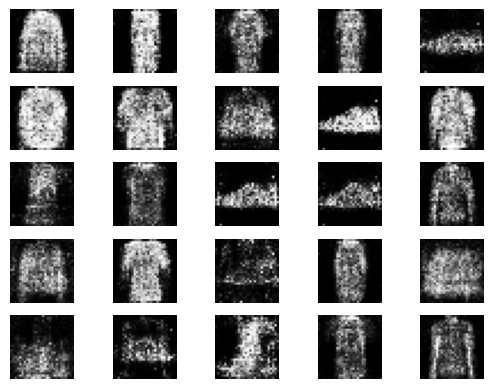

1/1 [==============================] - 0s 37ms/step
5201 [Discriminator loss: 0.611928, acc.: 71.88%] [Generator loss: 0.993558]
1/1 [==============================] - 0s 31ms/step
5202 [Discriminator loss: 0.509012, acc.: 78.12%] [Generator loss: 1.251494]
1/1 [==============================] - 0s 36ms/step
5203 [Discriminator loss: 0.571105, acc.: 65.62%] [Generator loss: 1.068574]
1/1 [==============================] - 0s 35ms/step
5204 [Discriminator loss: 0.523239, acc.: 73.44%] [Generator loss: 1.272044]
1/1 [==============================] - 0s 34ms/step
5205 [Discriminator loss: 0.582627, acc.: 67.19%] [Generator loss: 1.206859]
1/1 [==============================] - 0s 34ms/step
5206 [Discriminator loss: 0.573644, acc.: 65.62%] [Generator loss: 1.124757]
1/1 [==============================] - 0s 30ms/step
5207 [Discriminator loss: 0.577486, acc.: 67.19%] [Generator loss: 1.173115]
1/1 [==============================] - 0s 32ms/step
5208 [Discriminator loss: 0.551379, acc.: 73.

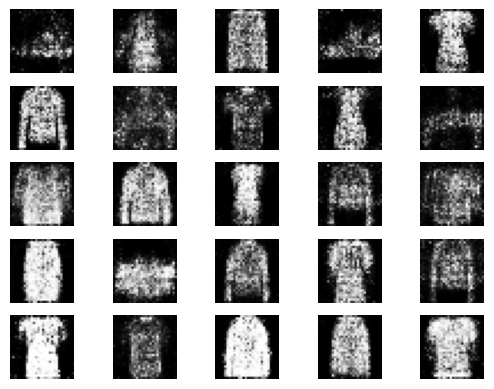

1/1 [==============================] - 0s 25ms/step
5401 [Discriminator loss: 0.654260, acc.: 60.94%] [Generator loss: 1.150418]
1/1 [==============================] - 0s 26ms/step
5402 [Discriminator loss: 0.606630, acc.: 68.75%] [Generator loss: 1.227469]
1/1 [==============================] - 0s 26ms/step
5403 [Discriminator loss: 0.614086, acc.: 64.06%] [Generator loss: 1.066078]
1/1 [==============================] - 0s 30ms/step
5404 [Discriminator loss: 0.596955, acc.: 71.88%] [Generator loss: 1.185591]
1/1 [==============================] - 0s 29ms/step
5405 [Discriminator loss: 0.564694, acc.: 76.56%] [Generator loss: 1.125874]
1/1 [==============================] - 0s 23ms/step
5406 [Discriminator loss: 0.483612, acc.: 78.12%] [Generator loss: 1.171323]
1/1 [==============================] - 0s 29ms/step
5407 [Discriminator loss: 0.484602, acc.: 84.38%] [Generator loss: 1.107440]
1/1 [==============================] - 0s 30ms/step
5408 [Discriminator loss: 0.607680, acc.: 62.

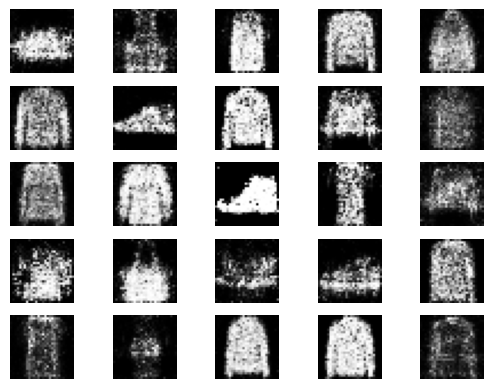

1/1 [==============================] - 0s 30ms/step
5601 [Discriminator loss: 0.563565, acc.: 70.31%] [Generator loss: 1.097885]
1/1 [==============================] - 0s 37ms/step
5602 [Discriminator loss: 0.632657, acc.: 64.06%] [Generator loss: 1.129336]
1/1 [==============================] - 0s 43ms/step
5603 [Discriminator loss: 0.473246, acc.: 82.81%] [Generator loss: 1.084342]
1/1 [==============================] - 0s 30ms/step
5604 [Discriminator loss: 0.583641, acc.: 68.75%] [Generator loss: 1.219072]
1/1 [==============================] - 0s 35ms/step
5605 [Discriminator loss: 0.584846, acc.: 73.44%] [Generator loss: 1.168506]
1/1 [==============================] - 0s 33ms/step
5606 [Discriminator loss: 0.605632, acc.: 67.19%] [Generator loss: 1.139517]
1/1 [==============================] - 0s 32ms/step
5607 [Discriminator loss: 0.561844, acc.: 75.00%] [Generator loss: 1.193024]
1/1 [==============================] - 0s 32ms/step
5608 [Discriminator loss: 0.553383, acc.: 73.

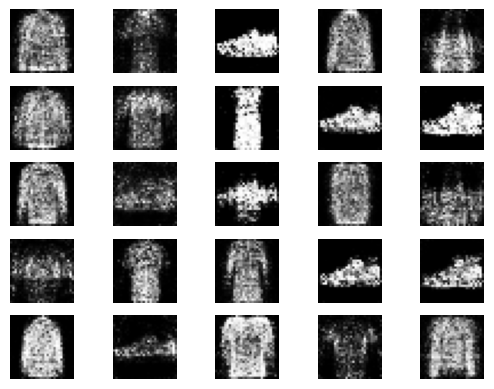

1/1 [==============================] - 0s 28ms/step
5801 [Discriminator loss: 0.574759, acc.: 64.06%] [Generator loss: 1.288334]
1/1 [==============================] - 0s 24ms/step
5802 [Discriminator loss: 0.557541, acc.: 73.44%] [Generator loss: 1.301038]
1/1 [==============================] - 0s 29ms/step
5803 [Discriminator loss: 0.608527, acc.: 64.06%] [Generator loss: 1.193026]
1/1 [==============================] - 0s 29ms/step
5804 [Discriminator loss: 0.575194, acc.: 73.44%] [Generator loss: 1.193853]
1/1 [==============================] - 0s 29ms/step
5805 [Discriminator loss: 0.627612, acc.: 65.62%] [Generator loss: 1.263922]
1/1 [==============================] - 0s 31ms/step
5806 [Discriminator loss: 0.547723, acc.: 65.62%] [Generator loss: 1.161798]
1/1 [==============================] - 0s 26ms/step
5807 [Discriminator loss: 0.578151, acc.: 67.19%] [Generator loss: 1.092546]
1/1 [==============================] - 0s 23ms/step
5808 [Discriminator loss: 0.531464, acc.: 73.

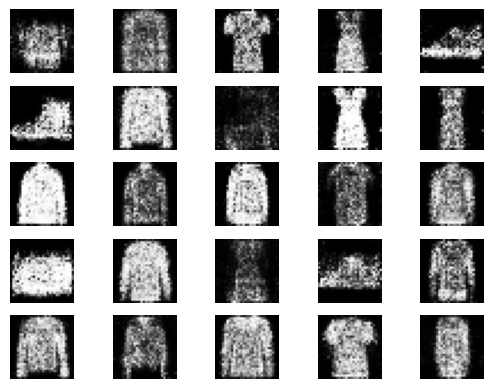

1/1 [==============================] - 0s 29ms/step
6001 [Discriminator loss: 0.480143, acc.: 78.12%] [Generator loss: 1.083951]
1/1 [==============================] - 0s 66ms/step
6002 [Discriminator loss: 0.603910, acc.: 67.19%] [Generator loss: 1.099890]
1/1 [==============================] - 0s 41ms/step
6003 [Discriminator loss: 0.529237, acc.: 68.75%] [Generator loss: 1.096765]
1/1 [==============================] - 0s 27ms/step
6004 [Discriminator loss: 0.566836, acc.: 70.31%] [Generator loss: 1.176276]
1/1 [==============================] - 0s 28ms/step
6005 [Discriminator loss: 0.662214, acc.: 64.06%] [Generator loss: 1.152419]
1/1 [==============================] - 0s 34ms/step
6006 [Discriminator loss: 0.657764, acc.: 64.06%] [Generator loss: 0.908832]
1/1 [==============================] - 0s 28ms/step
6007 [Discriminator loss: 0.548318, acc.: 70.31%] [Generator loss: 1.149536]
1/1 [==============================] - 0s 31ms/step
6008 [Discriminator loss: 0.524386, acc.: 71.

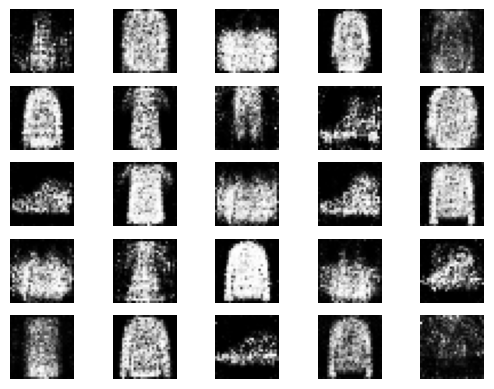

1/1 [==============================] - 0s 25ms/step
6201 [Discriminator loss: 0.664308, acc.: 64.06%] [Generator loss: 1.038123]
1/1 [==============================] - 0s 24ms/step
6202 [Discriminator loss: 0.593519, acc.: 67.19%] [Generator loss: 0.972249]
1/1 [==============================] - 0s 32ms/step
6203 [Discriminator loss: 0.561740, acc.: 65.62%] [Generator loss: 1.114779]
1/1 [==============================] - 0s 40ms/step
6204 [Discriminator loss: 0.645052, acc.: 64.06%] [Generator loss: 1.218449]
1/1 [==============================] - 0s 27ms/step
6205 [Discriminator loss: 0.538244, acc.: 75.00%] [Generator loss: 0.986007]
1/1 [==============================] - 0s 36ms/step
6206 [Discriminator loss: 0.539950, acc.: 71.88%] [Generator loss: 1.146959]
1/1 [==============================] - 0s 39ms/step
6207 [Discriminator loss: 0.487943, acc.: 73.44%] [Generator loss: 1.232192]
1/1 [==============================] - 0s 44ms/step
6208 [Discriminator loss: 0.650767, acc.: 60.

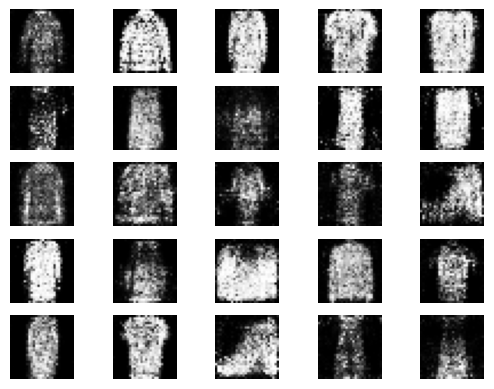

1/1 [==============================] - 0s 25ms/step
6401 [Discriminator loss: 0.624223, acc.: 64.06%] [Generator loss: 1.158364]
1/1 [==============================] - 0s 29ms/step
6402 [Discriminator loss: 0.578303, acc.: 65.62%] [Generator loss: 1.170824]
1/1 [==============================] - 0s 27ms/step
6403 [Discriminator loss: 0.612070, acc.: 67.19%] [Generator loss: 1.184950]
1/1 [==============================] - 0s 27ms/step
6404 [Discriminator loss: 0.577579, acc.: 73.44%] [Generator loss: 1.173103]
1/1 [==============================] - 0s 32ms/step
6405 [Discriminator loss: 0.546994, acc.: 73.44%] [Generator loss: 1.240866]
1/1 [==============================] - 0s 28ms/step
6406 [Discriminator loss: 0.544156, acc.: 76.56%] [Generator loss: 1.317083]
1/1 [==============================] - 0s 24ms/step
6407 [Discriminator loss: 0.586755, acc.: 70.31%] [Generator loss: 1.229278]
1/1 [==============================] - 0s 27ms/step
6408 [Discriminator loss: 0.551976, acc.: 67.

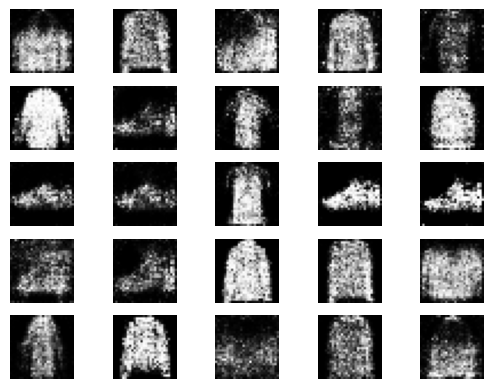

1/1 [==============================] - 0s 34ms/step
6601 [Discriminator loss: 0.599260, acc.: 65.62%] [Generator loss: 1.075569]
1/1 [==============================] - 0s 32ms/step
6602 [Discriminator loss: 0.652035, acc.: 59.38%] [Generator loss: 1.000947]
1/1 [==============================] - 0s 32ms/step
6603 [Discriminator loss: 0.560290, acc.: 73.44%] [Generator loss: 1.017475]
1/1 [==============================] - 0s 53ms/step
6604 [Discriminator loss: 0.525302, acc.: 73.44%] [Generator loss: 1.166459]
1/1 [==============================] - 0s 37ms/step
6605 [Discriminator loss: 0.659587, acc.: 56.25%] [Generator loss: 1.113266]
1/1 [==============================] - 0s 34ms/step
6606 [Discriminator loss: 0.559666, acc.: 76.56%] [Generator loss: 1.297302]
1/1 [==============================] - 0s 32ms/step
6607 [Discriminator loss: 0.527738, acc.: 75.00%] [Generator loss: 1.229021]
1/1 [==============================] - 0s 32ms/step
6608 [Discriminator loss: 0.521674, acc.: 76.

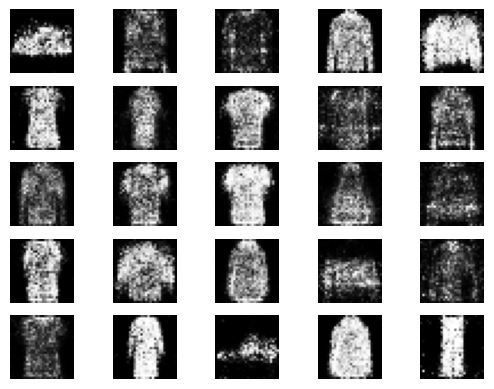

1/1 [==============================] - 0s 24ms/step
6801 [Discriminator loss: 0.565938, acc.: 71.88%] [Generator loss: 1.118009]
1/1 [==============================] - 0s 23ms/step
6802 [Discriminator loss: 0.602092, acc.: 67.19%] [Generator loss: 1.050356]
1/1 [==============================] - 0s 30ms/step
6803 [Discriminator loss: 0.581218, acc.: 68.75%] [Generator loss: 1.200491]
1/1 [==============================] - 0s 28ms/step
6804 [Discriminator loss: 0.549662, acc.: 70.31%] [Generator loss: 1.103496]
1/1 [==============================] - 0s 42ms/step
6805 [Discriminator loss: 0.657673, acc.: 57.81%] [Generator loss: 1.031757]
1/1 [==============================] - 0s 26ms/step
6806 [Discriminator loss: 0.547329, acc.: 75.00%] [Generator loss: 1.107651]
1/1 [==============================] - 0s 23ms/step
6807 [Discriminator loss: 0.592647, acc.: 67.19%] [Generator loss: 1.196186]
1/1 [==============================] - 0s 25ms/step
6808 [Discriminator loss: 0.633066, acc.: 67.

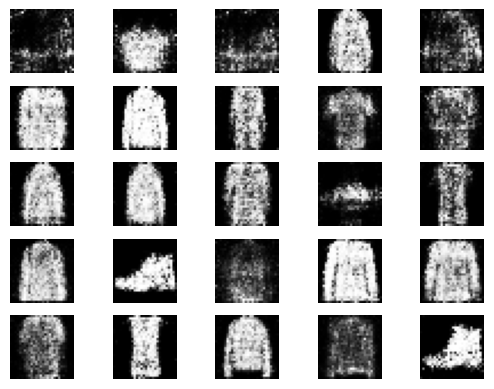

1/1 [==============================] - 0s 29ms/step
7001 [Discriminator loss: 0.587581, acc.: 67.19%] [Generator loss: 1.158199]
1/1 [==============================] - 0s 34ms/step
7002 [Discriminator loss: 0.587897, acc.: 65.62%] [Generator loss: 1.009524]
1/1 [==============================] - 0s 32ms/step
7003 [Discriminator loss: 0.665828, acc.: 62.50%] [Generator loss: 1.083339]
1/1 [==============================] - 0s 32ms/step
7004 [Discriminator loss: 0.597601, acc.: 59.38%] [Generator loss: 1.087582]
1/1 [==============================] - 0s 34ms/step
7005 [Discriminator loss: 0.579994, acc.: 73.44%] [Generator loss: 1.037112]
1/1 [==============================] - 0s 36ms/step
7006 [Discriminator loss: 0.617333, acc.: 60.94%] [Generator loss: 1.128630]
1/1 [==============================] - 0s 33ms/step
7007 [Discriminator loss: 0.537778, acc.: 73.44%] [Generator loss: 1.129885]
1/1 [==============================] - 0s 33ms/step
7008 [Discriminator loss: 0.517990, acc.: 73.

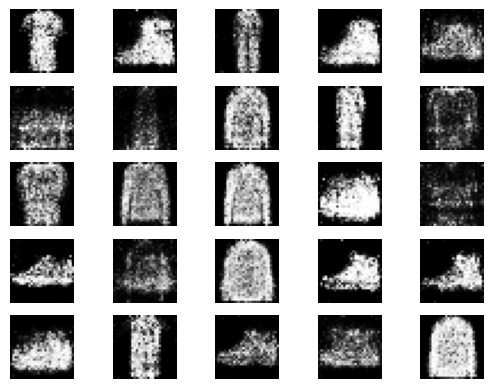

1/1 [==============================] - 0s 27ms/step
7201 [Discriminator loss: 0.596338, acc.: 60.94%] [Generator loss: 1.218248]
1/1 [==============================] - 0s 27ms/step
7202 [Discriminator loss: 0.581966, acc.: 65.62%] [Generator loss: 1.001747]
1/1 [==============================] - 0s 32ms/step
7203 [Discriminator loss: 0.618864, acc.: 62.50%] [Generator loss: 0.996065]
1/1 [==============================] - 0s 33ms/step
7204 [Discriminator loss: 0.560751, acc.: 76.56%] [Generator loss: 1.068539]
1/1 [==============================] - 0s 31ms/step
7205 [Discriminator loss: 0.542590, acc.: 71.88%] [Generator loss: 1.132542]
1/1 [==============================] - 0s 26ms/step
7206 [Discriminator loss: 0.553181, acc.: 73.44%] [Generator loss: 1.109359]
1/1 [==============================] - 0s 27ms/step
7207 [Discriminator loss: 0.639225, acc.: 59.38%] [Generator loss: 1.108114]
1/1 [==============================] - 0s 31ms/step
7208 [Discriminator loss: 0.616417, acc.: 65.

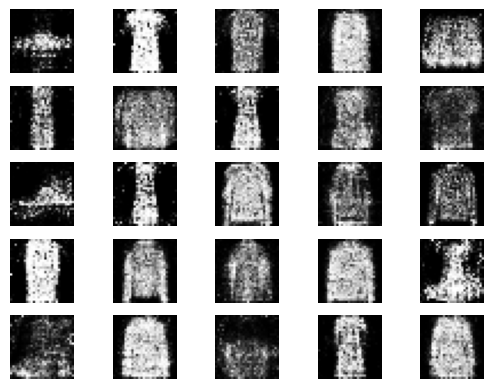

1/1 [==============================] - 0s 29ms/step
7401 [Discriminator loss: 0.502087, acc.: 73.44%] [Generator loss: 1.079013]
1/1 [==============================] - 0s 34ms/step
7402 [Discriminator loss: 0.581660, acc.: 70.31%] [Generator loss: 1.174364]
1/1 [==============================] - 0s 36ms/step
7403 [Discriminator loss: 0.601913, acc.: 67.19%] [Generator loss: 1.137776]
1/1 [==============================] - 0s 29ms/step
7404 [Discriminator loss: 0.533521, acc.: 79.69%] [Generator loss: 1.138034]
1/1 [==============================] - 0s 33ms/step
7405 [Discriminator loss: 0.499836, acc.: 71.88%] [Generator loss: 1.078686]
1/1 [==============================] - 0s 30ms/step
7406 [Discriminator loss: 0.609010, acc.: 62.50%] [Generator loss: 1.076203]
1/1 [==============================] - 0s 44ms/step
7407 [Discriminator loss: 0.643947, acc.: 64.06%] [Generator loss: 1.116687]
1/1 [==============================] - 0s 30ms/step
7408 [Discriminator loss: 0.513711, acc.: 78.

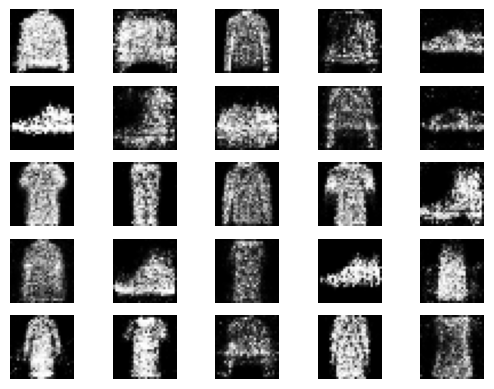

1/1 [==============================] - 0s 25ms/step
7601 [Discriminator loss: 0.614504, acc.: 59.38%] [Generator loss: 1.206291]
1/1 [==============================] - 0s 32ms/step
7602 [Discriminator loss: 0.573852, acc.: 68.75%] [Generator loss: 1.092875]
1/1 [==============================] - 0s 30ms/step
7603 [Discriminator loss: 0.613905, acc.: 62.50%] [Generator loss: 1.007936]
1/1 [==============================] - 0s 28ms/step
7604 [Discriminator loss: 0.519780, acc.: 73.44%] [Generator loss: 0.986913]
1/1 [==============================] - 0s 24ms/step
7605 [Discriminator loss: 0.600877, acc.: 71.88%] [Generator loss: 1.071995]
1/1 [==============================] - 0s 24ms/step
7606 [Discriminator loss: 0.556501, acc.: 76.56%] [Generator loss: 1.078626]
1/1 [==============================] - 0s 25ms/step
7607 [Discriminator loss: 0.531585, acc.: 75.00%] [Generator loss: 1.080907]
1/1 [==============================] - 0s 27ms/step
7608 [Discriminator loss: 0.590737, acc.: 67.

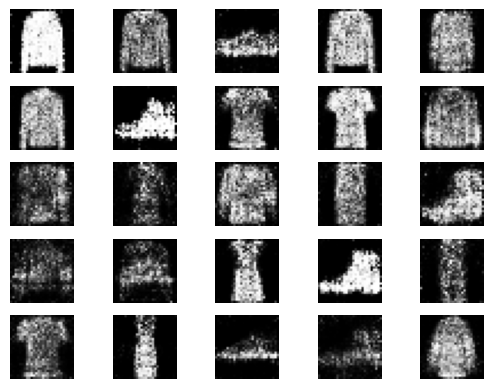

1/1 [==============================] - 0s 36ms/step
7801 [Discriminator loss: 0.592876, acc.: 67.19%] [Generator loss: 1.043561]
1/1 [==============================] - 0s 37ms/step
7802 [Discriminator loss: 0.552030, acc.: 68.75%] [Generator loss: 1.120789]
1/1 [==============================] - 0s 35ms/step
7803 [Discriminator loss: 0.616430, acc.: 64.06%] [Generator loss: 1.228562]
1/1 [==============================] - 0s 33ms/step
7804 [Discriminator loss: 0.561797, acc.: 71.88%] [Generator loss: 1.188496]
1/1 [==============================] - 0s 43ms/step
7805 [Discriminator loss: 0.621515, acc.: 62.50%] [Generator loss: 1.073753]
1/1 [==============================] - 0s 31ms/step
7806 [Discriminator loss: 0.636463, acc.: 64.06%] [Generator loss: 1.019259]
1/1 [==============================] - 0s 30ms/step
7807 [Discriminator loss: 0.540556, acc.: 73.44%] [Generator loss: 1.161713]
1/1 [==============================] - 0s 25ms/step
7808 [Discriminator loss: 0.588892, acc.: 68.

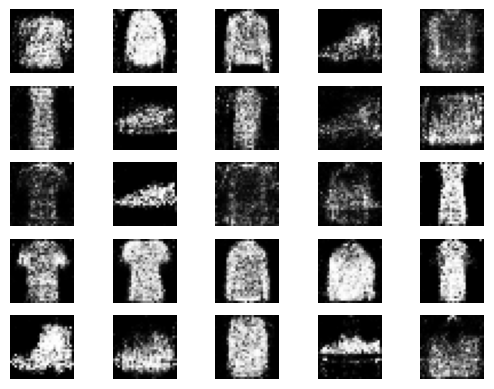

1/1 [==============================] - 0s 24ms/step
8001 [Discriminator loss: 0.646714, acc.: 64.06%] [Generator loss: 1.138943]
1/1 [==============================] - 0s 26ms/step
8002 [Discriminator loss: 0.588055, acc.: 70.31%] [Generator loss: 1.154703]
1/1 [==============================] - 0s 33ms/step
8003 [Discriminator loss: 0.570604, acc.: 65.62%] [Generator loss: 1.277509]
1/1 [==============================] - 0s 25ms/step
8004 [Discriminator loss: 0.630385, acc.: 65.62%] [Generator loss: 1.117190]
1/1 [==============================] - 0s 30ms/step
8005 [Discriminator loss: 0.504448, acc.: 76.56%] [Generator loss: 1.224103]
1/1 [==============================] - 0s 26ms/step
8006 [Discriminator loss: 0.555031, acc.: 65.62%] [Generator loss: 1.190288]
1/1 [==============================] - 0s 31ms/step
8007 [Discriminator loss: 0.680033, acc.: 54.69%] [Generator loss: 1.062842]
1/1 [==============================] - 0s 27ms/step
8008 [Discriminator loss: 0.575810, acc.: 68.

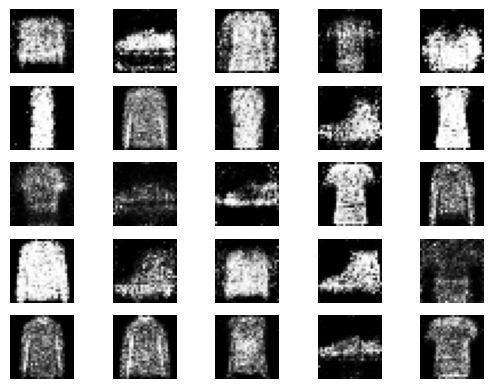

1/1 [==============================] - 0s 27ms/step
8201 [Discriminator loss: 0.565174, acc.: 73.44%] [Generator loss: 1.056648]
1/1 [==============================] - 0s 24ms/step
8202 [Discriminator loss: 0.531023, acc.: 70.31%] [Generator loss: 1.181636]
1/1 [==============================] - 0s 24ms/step
8203 [Discriminator loss: 0.636020, acc.: 64.06%] [Generator loss: 1.100916]
1/1 [==============================] - 0s 23ms/step
8204 [Discriminator loss: 0.562935, acc.: 70.31%] [Generator loss: 1.225452]
1/1 [==============================] - 0s 28ms/step
8205 [Discriminator loss: 0.603149, acc.: 62.50%] [Generator loss: 1.205532]
1/1 [==============================] - 0s 30ms/step
8206 [Discriminator loss: 0.588731, acc.: 68.75%] [Generator loss: 1.232013]
1/1 [==============================] - 0s 28ms/step
8207 [Discriminator loss: 0.577648, acc.: 65.62%] [Generator loss: 1.174067]
1/1 [==============================] - 0s 27ms/step
8208 [Discriminator loss: 0.549331, acc.: 71.

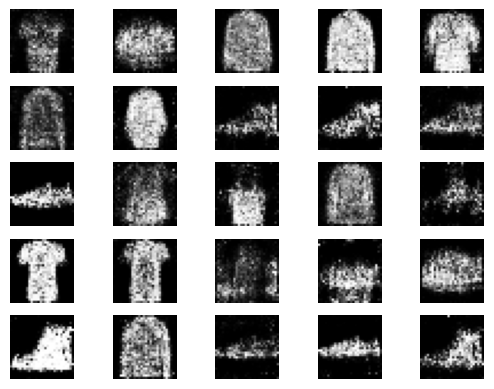

1/1 [==============================] - 0s 37ms/step
8401 [Discriminator loss: 0.558770, acc.: 68.75%] [Generator loss: 1.145485]
1/1 [==============================] - 0s 30ms/step
8402 [Discriminator loss: 0.493172, acc.: 79.69%] [Generator loss: 1.282042]
1/1 [==============================] - 0s 30ms/step
8403 [Discriminator loss: 0.552247, acc.: 68.75%] [Generator loss: 1.173737]
1/1 [==============================] - 0s 34ms/step
8404 [Discriminator loss: 0.605490, acc.: 67.19%] [Generator loss: 1.207463]
1/1 [==============================] - 0s 33ms/step
8405 [Discriminator loss: 0.633509, acc.: 67.19%] [Generator loss: 1.220553]
1/1 [==============================] - 0s 34ms/step
8406 [Discriminator loss: 0.649463, acc.: 62.50%] [Generator loss: 1.159186]
1/1 [==============================] - 0s 35ms/step
8407 [Discriminator loss: 0.541899, acc.: 78.12%] [Generator loss: 1.227984]
1/1 [==============================] - 0s 30ms/step
8408 [Discriminator loss: 0.600359, acc.: 64.

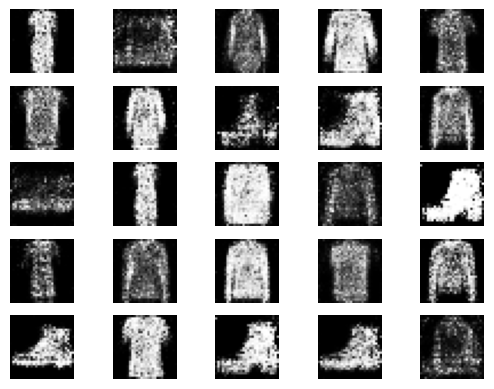

1/1 [==============================] - 0s 28ms/step
8601 [Discriminator loss: 0.471803, acc.: 75.00%] [Generator loss: 1.203731]
1/1 [==============================] - 0s 26ms/step
8602 [Discriminator loss: 0.586908, acc.: 59.38%] [Generator loss: 1.101062]
1/1 [==============================] - 0s 32ms/step
8603 [Discriminator loss: 0.420704, acc.: 82.81%] [Generator loss: 1.114386]
1/1 [==============================] - 0s 24ms/step
8604 [Discriminator loss: 0.655744, acc.: 64.06%] [Generator loss: 1.304267]
1/1 [==============================] - 0s 23ms/step
8605 [Discriminator loss: 0.633439, acc.: 65.62%] [Generator loss: 1.086681]
1/1 [==============================] - 0s 25ms/step
8606 [Discriminator loss: 0.568532, acc.: 76.56%] [Generator loss: 1.085094]
1/1 [==============================] - 0s 24ms/step
8607 [Discriminator loss: 0.497302, acc.: 71.88%] [Generator loss: 1.081960]
1/1 [==============================] - 0s 24ms/step
8608 [Discriminator loss: 0.564983, acc.: 70.

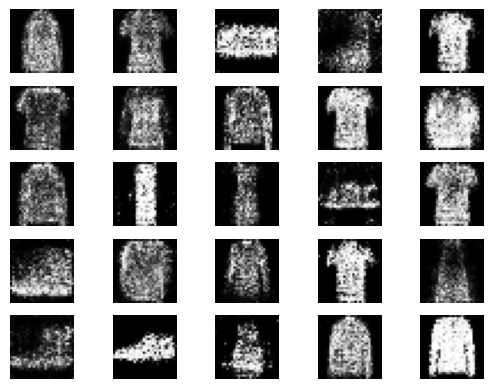

1/1 [==============================] - 0s 33ms/step
8801 [Discriminator loss: 0.611602, acc.: 68.75%] [Generator loss: 1.104793]
1/1 [==============================] - 0s 37ms/step
8802 [Discriminator loss: 0.616098, acc.: 65.62%] [Generator loss: 1.151830]
1/1 [==============================] - 0s 32ms/step
8803 [Discriminator loss: 0.538905, acc.: 65.62%] [Generator loss: 1.129222]
1/1 [==============================] - 0s 37ms/step
8804 [Discriminator loss: 0.646767, acc.: 62.50%] [Generator loss: 1.081036]
1/1 [==============================] - 0s 33ms/step
8805 [Discriminator loss: 0.505173, acc.: 82.81%] [Generator loss: 1.117197]
1/1 [==============================] - 0s 34ms/step
8806 [Discriminator loss: 0.531210, acc.: 76.56%] [Generator loss: 1.170368]
1/1 [==============================] - 0s 42ms/step
8807 [Discriminator loss: 0.597714, acc.: 68.75%] [Generator loss: 1.228023]
1/1 [==============================] - 0s 32ms/step
8808 [Discriminator loss: 0.534059, acc.: 76.

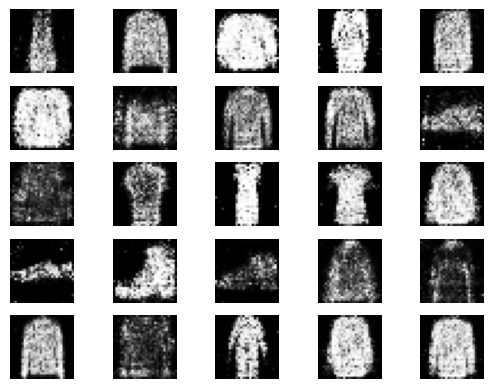

1/1 [==============================] - 0s 26ms/step
9001 [Discriminator loss: 0.595117, acc.: 67.19%] [Generator loss: 1.099010]
1/1 [==============================] - 0s 29ms/step
9002 [Discriminator loss: 0.614539, acc.: 68.75%] [Generator loss: 1.210523]
1/1 [==============================] - 0s 27ms/step
9003 [Discriminator loss: 0.618061, acc.: 67.19%] [Generator loss: 1.216676]
1/1 [==============================] - 0s 25ms/step
9004 [Discriminator loss: 0.506076, acc.: 79.69%] [Generator loss: 1.234222]
1/1 [==============================] - 0s 29ms/step
9005 [Discriminator loss: 0.495738, acc.: 70.31%] [Generator loss: 1.399082]
1/1 [==============================] - 0s 40ms/step
9006 [Discriminator loss: 0.631274, acc.: 62.50%] [Generator loss: 1.247972]
1/1 [==============================] - 0s 25ms/step
9007 [Discriminator loss: 0.535996, acc.: 70.31%] [Generator loss: 1.178198]
1/1 [==============================] - 0s 29ms/step
9008 [Discriminator loss: 0.570263, acc.: 73.

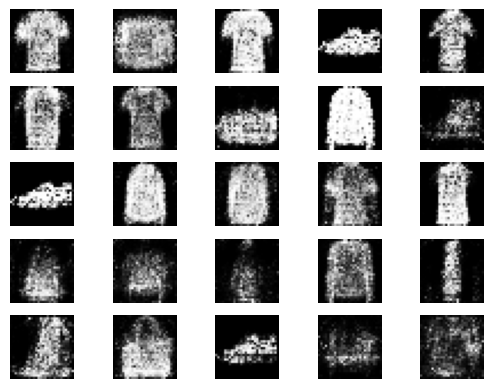

1/1 [==============================] - 0s 49ms/step
9201 [Discriminator loss: 0.542668, acc.: 71.88%] [Generator loss: 1.117650]
1/1 [==============================] - 0s 34ms/step
9202 [Discriminator loss: 0.596846, acc.: 67.19%] [Generator loss: 1.028949]
1/1 [==============================] - 0s 37ms/step
9203 [Discriminator loss: 0.577219, acc.: 73.44%] [Generator loss: 1.071655]
1/1 [==============================] - 0s 47ms/step
9204 [Discriminator loss: 0.557882, acc.: 78.12%] [Generator loss: 1.150715]
1/1 [==============================] - 0s 33ms/step
9205 [Discriminator loss: 0.600650, acc.: 67.19%] [Generator loss: 1.172387]
1/1 [==============================] - 0s 31ms/step
9206 [Discriminator loss: 0.588802, acc.: 67.19%] [Generator loss: 1.158610]
1/1 [==============================] - 0s 46ms/step
9207 [Discriminator loss: 0.684036, acc.: 59.38%] [Generator loss: 1.260293]
1/1 [==============================] - 0s 40ms/step
9208 [Discriminator loss: 0.565431, acc.: 68.

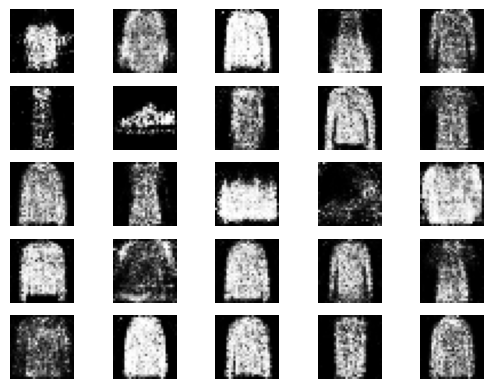

1/1 [==============================] - 0s 25ms/step
9401 [Discriminator loss: 0.580551, acc.: 68.75%] [Generator loss: 1.199545]
1/1 [==============================] - 0s 36ms/step
9402 [Discriminator loss: 0.469372, acc.: 81.25%] [Generator loss: 1.148565]
1/1 [==============================] - 0s 29ms/step
9403 [Discriminator loss: 0.615690, acc.: 65.62%] [Generator loss: 1.145751]
1/1 [==============================] - 0s 27ms/step
9404 [Discriminator loss: 0.520213, acc.: 70.31%] [Generator loss: 1.186684]
1/1 [==============================] - 0s 23ms/step
9405 [Discriminator loss: 0.539289, acc.: 73.44%] [Generator loss: 1.134744]
1/1 [==============================] - 0s 24ms/step
9406 [Discriminator loss: 0.637140, acc.: 62.50%] [Generator loss: 1.202086]
1/1 [==============================] - 0s 24ms/step
9407 [Discriminator loss: 0.578826, acc.: 71.88%] [Generator loss: 1.047216]
1/1 [==============================] - 0s 39ms/step
9408 [Discriminator loss: 0.522883, acc.: 73.

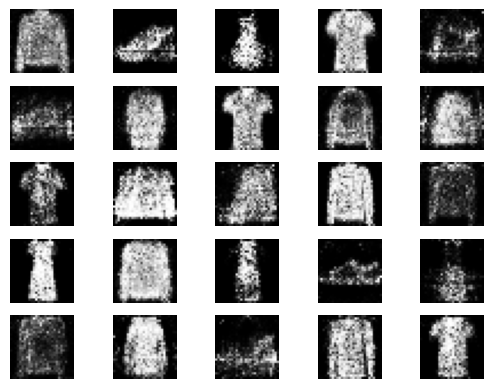

1/1 [==============================] - 0s 34ms/step
9601 [Discriminator loss: 0.635252, acc.: 65.62%] [Generator loss: 1.036121]
1/1 [==============================] - 0s 31ms/step
9602 [Discriminator loss: 0.691590, acc.: 60.94%] [Generator loss: 1.129909]
1/1 [==============================] - 0s 35ms/step
9603 [Discriminator loss: 0.614591, acc.: 70.31%] [Generator loss: 1.180226]
1/1 [==============================] - 0s 39ms/step
9604 [Discriminator loss: 0.545618, acc.: 79.69%] [Generator loss: 1.133452]
1/1 [==============================] - 0s 37ms/step
9605 [Discriminator loss: 0.577771, acc.: 67.19%] [Generator loss: 1.134665]
1/1 [==============================] - 0s 43ms/step
9606 [Discriminator loss: 0.501782, acc.: 73.44%] [Generator loss: 1.101812]
1/1 [==============================] - 0s 32ms/step
9607 [Discriminator loss: 0.615999, acc.: 60.94%] [Generator loss: 1.258437]
1/1 [==============================] - 0s 73ms/step
9608 [Discriminator loss: 0.598273, acc.: 64.

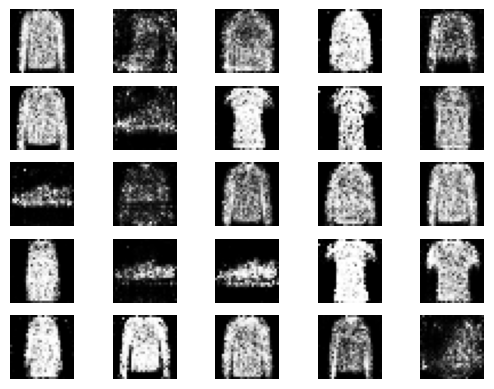

1/1 [==============================] - 0s 27ms/step
9801 [Discriminator loss: 0.548239, acc.: 73.44%] [Generator loss: 1.125036]
1/1 [==============================] - 0s 24ms/step
9802 [Discriminator loss: 0.583151, acc.: 67.19%] [Generator loss: 1.077633]
1/1 [==============================] - 0s 32ms/step
9803 [Discriminator loss: 0.633403, acc.: 60.94%] [Generator loss: 1.219203]
1/1 [==============================] - 0s 27ms/step
9804 [Discriminator loss: 0.521727, acc.: 71.88%] [Generator loss: 1.178139]
1/1 [==============================] - 0s 29ms/step
9805 [Discriminator loss: 0.562046, acc.: 67.19%] [Generator loss: 1.232317]
1/1 [==============================] - 0s 25ms/step
9806 [Discriminator loss: 0.463195, acc.: 78.12%] [Generator loss: 1.489701]
1/1 [==============================] - 0s 35ms/step
9807 [Discriminator loss: 0.661721, acc.: 60.94%] [Generator loss: 1.130674]
1/1 [==============================] - 0s 26ms/step
9808 [Discriminator loss: 0.614084, acc.: 64.

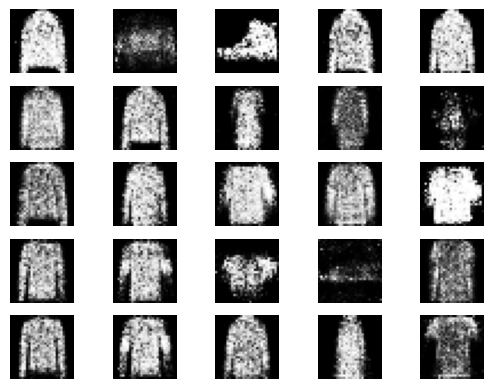

1/1 [==============================] - 0s 27ms/step
10001 [Discriminator loss: 0.557520, acc.: 73.44%] [Generator loss: 1.094312]
1/1 [==============================] - 0s 27ms/step
10002 [Discriminator loss: 0.581331, acc.: 71.88%] [Generator loss: 1.051082]
1/1 [==============================] - 0s 29ms/step
10003 [Discriminator loss: 0.541703, acc.: 68.75%] [Generator loss: 1.202913]
1/1 [==============================] - 0s 38ms/step
10004 [Discriminator loss: 0.621220, acc.: 64.06%] [Generator loss: 1.224049]
1/1 [==============================] - 0s 25ms/step
10005 [Discriminator loss: 0.560094, acc.: 71.88%] [Generator loss: 1.283322]
1/1 [==============================] - 0s 31ms/step
10006 [Discriminator loss: 0.597331, acc.: 71.88%] [Generator loss: 1.266545]
1/1 [==============================] - 0s 42ms/step
10007 [Discriminator loss: 0.482246, acc.: 75.00%] [Generator loss: 1.238918]
1/1 [==============================] - 0s 29ms/step
10008 [Discriminator loss: 0.483167, a

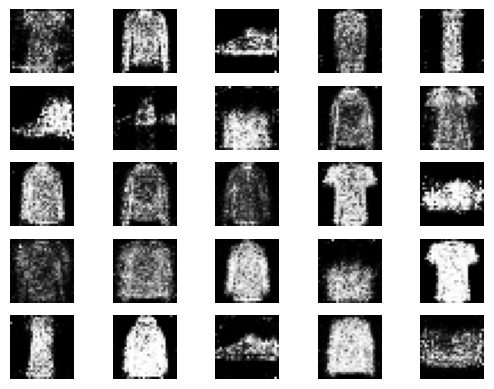

1/1 [==============================] - 0s 24ms/step
10201 [Discriminator loss: 0.717010, acc.: 56.25%] [Generator loss: 1.151000]
1/1 [==============================] - 0s 25ms/step
10202 [Discriminator loss: 0.553729, acc.: 70.31%] [Generator loss: 1.145447]
1/1 [==============================] - 0s 22ms/step
10203 [Discriminator loss: 0.487731, acc.: 75.00%] [Generator loss: 1.154859]
1/1 [==============================] - 0s 24ms/step
10204 [Discriminator loss: 0.572264, acc.: 71.88%] [Generator loss: 1.097569]
1/1 [==============================] - 0s 42ms/step
10205 [Discriminator loss: 0.547154, acc.: 70.31%] [Generator loss: 1.175819]
1/1 [==============================] - 0s 25ms/step
10206 [Discriminator loss: 0.623570, acc.: 64.06%] [Generator loss: 1.198683]
1/1 [==============================] - 0s 25ms/step
10207 [Discriminator loss: 0.584322, acc.: 71.88%] [Generator loss: 0.999237]
1/1 [==============================] - 0s 27ms/step
10208 [Discriminator loss: 0.635816, a

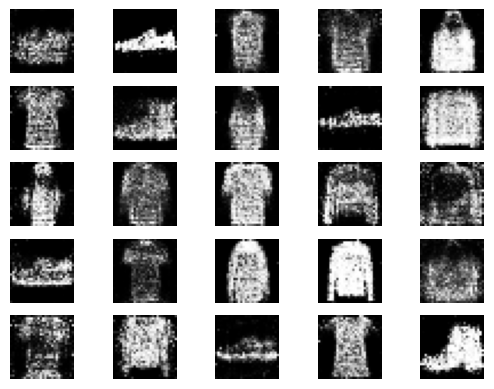

1/1 [==============================] - 0s 25ms/step
10401 [Discriminator loss: 0.574203, acc.: 68.75%] [Generator loss: 1.146783]
1/1 [==============================] - 0s 25ms/step
10402 [Discriminator loss: 0.525655, acc.: 71.88%] [Generator loss: 1.197716]
1/1 [==============================] - 0s 25ms/step
10403 [Discriminator loss: 0.511230, acc.: 75.00%] [Generator loss: 1.288369]
1/1 [==============================] - 0s 28ms/step
10404 [Discriminator loss: 0.460039, acc.: 82.81%] [Generator loss: 1.291874]
1/1 [==============================] - 0s 26ms/step
10405 [Discriminator loss: 0.604369, acc.: 59.38%] [Generator loss: 1.267073]
1/1 [==============================] - 0s 26ms/step
10406 [Discriminator loss: 0.510153, acc.: 81.25%] [Generator loss: 1.243384]
1/1 [==============================] - 0s 24ms/step
10407 [Discriminator loss: 0.607177, acc.: 65.62%] [Generator loss: 1.331053]
1/1 [==============================] - 0s 28ms/step
10408 [Discriminator loss: 0.536273, a

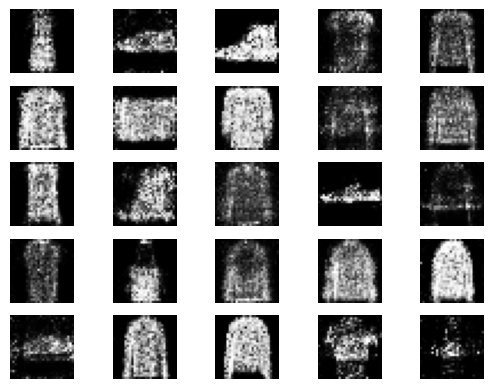

1/1 [==============================] - 0s 42ms/step
10601 [Discriminator loss: 0.643467, acc.: 64.06%] [Generator loss: 1.113521]
1/1 [==============================] - 0s 52ms/step
10602 [Discriminator loss: 0.513521, acc.: 68.75%] [Generator loss: 1.026869]
1/1 [==============================] - 0s 37ms/step
10603 [Discriminator loss: 0.670131, acc.: 64.06%] [Generator loss: 1.013551]
1/1 [==============================] - 0s 50ms/step
10604 [Discriminator loss: 0.563099, acc.: 76.56%] [Generator loss: 1.153200]
1/1 [==============================] - 0s 58ms/step
10605 [Discriminator loss: 0.496098, acc.: 70.31%] [Generator loss: 1.273576]
1/1 [==============================] - 0s 33ms/step
10606 [Discriminator loss: 0.606848, acc.: 68.75%] [Generator loss: 1.403302]
1/1 [==============================] - 0s 37ms/step
10607 [Discriminator loss: 0.613185, acc.: 65.62%] [Generator loss: 1.140571]
1/1 [==============================] - 0s 54ms/step
10608 [Discriminator loss: 0.605242, a

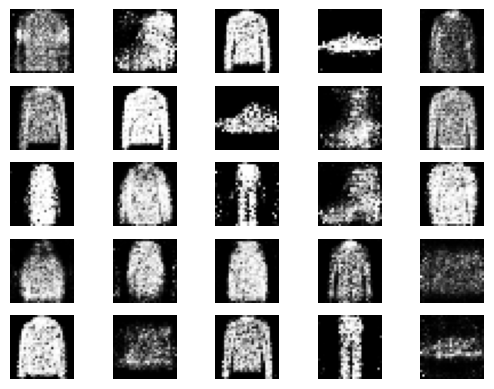

1/1 [==============================] - 0s 26ms/step
10801 [Discriminator loss: 0.671247, acc.: 60.94%] [Generator loss: 1.256108]
1/1 [==============================] - 0s 26ms/step
10802 [Discriminator loss: 0.620919, acc.: 62.50%] [Generator loss: 1.060920]
1/1 [==============================] - 0s 30ms/step
10803 [Discriminator loss: 0.605972, acc.: 65.62%] [Generator loss: 1.194127]
1/1 [==============================] - 0s 25ms/step
10804 [Discriminator loss: 0.595491, acc.: 67.19%] [Generator loss: 1.139201]
1/1 [==============================] - 0s 26ms/step
10805 [Discriminator loss: 0.508890, acc.: 81.25%] [Generator loss: 1.081728]
1/1 [==============================] - 0s 31ms/step
10806 [Discriminator loss: 0.529105, acc.: 76.56%] [Generator loss: 1.073225]
1/1 [==============================] - 0s 31ms/step
10807 [Discriminator loss: 0.478666, acc.: 81.25%] [Generator loss: 1.142051]
1/1 [==============================] - 0s 33ms/step
10808 [Discriminator loss: 0.735551, a

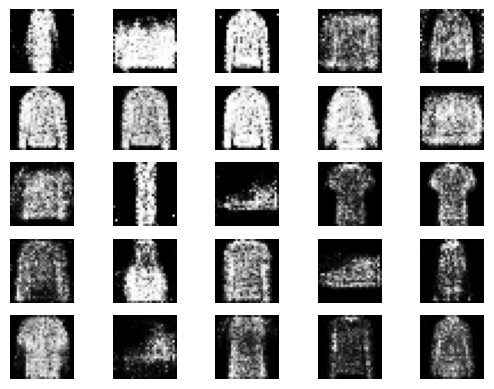

1/1 [==============================] - 0s 36ms/step
11001 [Discriminator loss: 0.618400, acc.: 68.75%] [Generator loss: 0.961874]
1/1 [==============================] - 0s 31ms/step
11002 [Discriminator loss: 0.557871, acc.: 67.19%] [Generator loss: 1.176568]
1/1 [==============================] - 0s 45ms/step
11003 [Discriminator loss: 0.554429, acc.: 67.19%] [Generator loss: 1.130572]
1/1 [==============================] - 0s 32ms/step
11004 [Discriminator loss: 0.550372, acc.: 75.00%] [Generator loss: 1.264338]
1/1 [==============================] - 0s 32ms/step
11005 [Discriminator loss: 0.592699, acc.: 70.31%] [Generator loss: 1.142764]
1/1 [==============================] - 0s 36ms/step
11006 [Discriminator loss: 0.694438, acc.: 62.50%] [Generator loss: 1.102816]
1/1 [==============================] - 0s 34ms/step
11007 [Discriminator loss: 0.571633, acc.: 65.62%] [Generator loss: 1.245566]
1/1 [==============================] - 0s 32ms/step
11008 [Discriminator loss: 0.630219, a

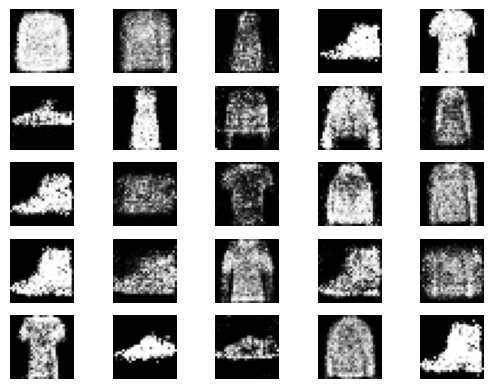

1/1 [==============================] - 0s 25ms/step
11201 [Discriminator loss: 0.565764, acc.: 68.75%] [Generator loss: 1.270476]
1/1 [==============================] - 0s 23ms/step
11202 [Discriminator loss: 0.580971, acc.: 65.62%] [Generator loss: 1.186484]
1/1 [==============================] - 0s 24ms/step
11203 [Discriminator loss: 0.530200, acc.: 75.00%] [Generator loss: 1.325078]
1/1 [==============================] - 0s 23ms/step
11204 [Discriminator loss: 0.603503, acc.: 65.62%] [Generator loss: 1.242677]
1/1 [==============================] - 0s 24ms/step
11205 [Discriminator loss: 0.548668, acc.: 71.88%] [Generator loss: 1.198137]
1/1 [==============================] - 0s 25ms/step
11206 [Discriminator loss: 0.598101, acc.: 65.62%] [Generator loss: 1.123937]
1/1 [==============================] - 0s 27ms/step
11207 [Discriminator loss: 0.539493, acc.: 62.50%] [Generator loss: 1.075423]
1/1 [==============================] - 0s 29ms/step
11208 [Discriminator loss: 0.593879, a

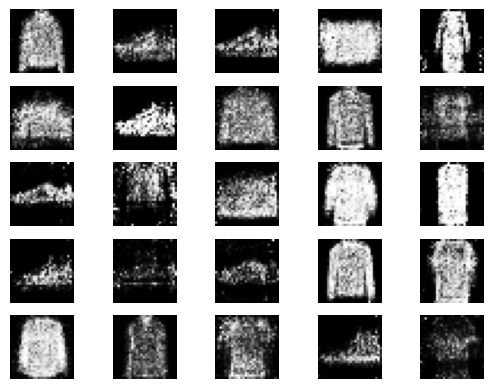

1/1 [==============================] - 0s 33ms/step
11401 [Discriminator loss: 0.580487, acc.: 73.44%] [Generator loss: 1.179325]
1/1 [==============================] - 0s 29ms/step
11402 [Discriminator loss: 0.463823, acc.: 79.69%] [Generator loss: 1.156848]
1/1 [==============================] - 0s 30ms/step
11403 [Discriminator loss: 0.525491, acc.: 73.44%] [Generator loss: 1.176572]
1/1 [==============================] - 0s 33ms/step
11404 [Discriminator loss: 0.641130, acc.: 64.06%] [Generator loss: 1.071749]
1/1 [==============================] - 0s 33ms/step
11405 [Discriminator loss: 0.644717, acc.: 57.81%] [Generator loss: 1.202136]
1/1 [==============================] - 0s 29ms/step
11406 [Discriminator loss: 0.527330, acc.: 76.56%] [Generator loss: 1.187040]
1/1 [==============================] - 0s 43ms/step
11407 [Discriminator loss: 0.644505, acc.: 51.56%] [Generator loss: 1.173879]
1/1 [==============================] - 0s 30ms/step
11408 [Discriminator loss: 0.729659, a

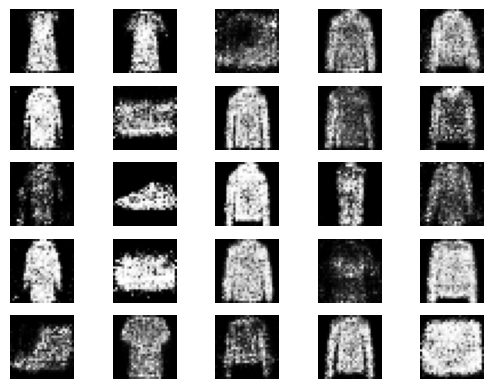

1/1 [==============================] - 0s 24ms/step
11601 [Discriminator loss: 0.613950, acc.: 70.31%] [Generator loss: 1.160807]
1/1 [==============================] - 0s 23ms/step
11602 [Discriminator loss: 0.550113, acc.: 71.88%] [Generator loss: 1.193381]
1/1 [==============================] - 0s 22ms/step
11603 [Discriminator loss: 0.649442, acc.: 65.62%] [Generator loss: 1.158125]
1/1 [==============================] - 0s 24ms/step
11604 [Discriminator loss: 0.591753, acc.: 68.75%] [Generator loss: 1.174696]
1/1 [==============================] - 0s 27ms/step
11605 [Discriminator loss: 0.445731, acc.: 75.00%] [Generator loss: 1.376661]
1/1 [==============================] - 0s 23ms/step
11606 [Discriminator loss: 0.570297, acc.: 68.75%] [Generator loss: 1.104527]
1/1 [==============================] - 0s 24ms/step
11607 [Discriminator loss: 0.723943, acc.: 59.38%] [Generator loss: 1.070357]
1/1 [==============================] - 0s 24ms/step
11608 [Discriminator loss: 0.578265, a

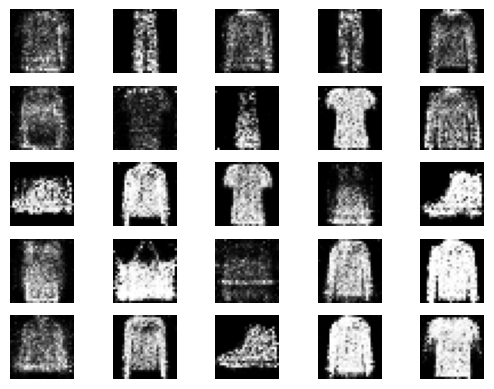

1/1 [==============================] - 0s 31ms/step
11801 [Discriminator loss: 0.571735, acc.: 70.31%] [Generator loss: 1.227504]
1/1 [==============================] - 0s 39ms/step
11802 [Discriminator loss: 0.547078, acc.: 71.88%] [Generator loss: 1.137656]
1/1 [==============================] - 0s 53ms/step
11803 [Discriminator loss: 0.648562, acc.: 56.25%] [Generator loss: 1.171290]
1/1 [==============================] - 0s 56ms/step
11804 [Discriminator loss: 0.560647, acc.: 70.31%] [Generator loss: 1.213833]
1/1 [==============================] - 0s 72ms/step
11805 [Discriminator loss: 0.569930, acc.: 65.62%] [Generator loss: 1.186872]
1/1 [==============================] - 0s 56ms/step
11806 [Discriminator loss: 0.588385, acc.: 68.75%] [Generator loss: 1.205749]
1/1 [==============================] - 0s 48ms/step
11807 [Discriminator loss: 0.579589, acc.: 62.50%] [Generator loss: 1.313481]
1/1 [==============================] - 0s 71ms/step
11808 [Discriminator loss: 0.597303, a

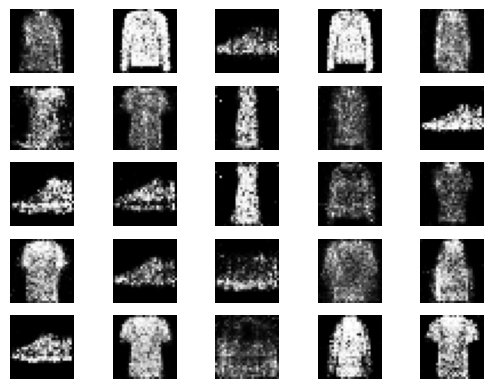

1/1 [==============================] - 0s 25ms/step
12001 [Discriminator loss: 0.535720, acc.: 78.12%] [Generator loss: 1.079964]
1/1 [==============================] - 0s 26ms/step
12002 [Discriminator loss: 0.532668, acc.: 78.12%] [Generator loss: 1.186161]
1/1 [==============================] - 0s 22ms/step
12003 [Discriminator loss: 0.531308, acc.: 79.69%] [Generator loss: 1.182152]
1/1 [==============================] - 0s 25ms/step
12004 [Discriminator loss: 0.700953, acc.: 57.81%] [Generator loss: 1.073026]
1/1 [==============================] - 0s 26ms/step
12005 [Discriminator loss: 0.626645, acc.: 68.75%] [Generator loss: 1.275180]
1/1 [==============================] - 0s 28ms/step
12006 [Discriminator loss: 0.560939, acc.: 68.75%] [Generator loss: 1.231990]
1/1 [==============================] - 0s 29ms/step
12007 [Discriminator loss: 0.660797, acc.: 57.81%] [Generator loss: 1.254055]
1/1 [==============================] - 0s 25ms/step
12008 [Discriminator loss: 0.602171, a

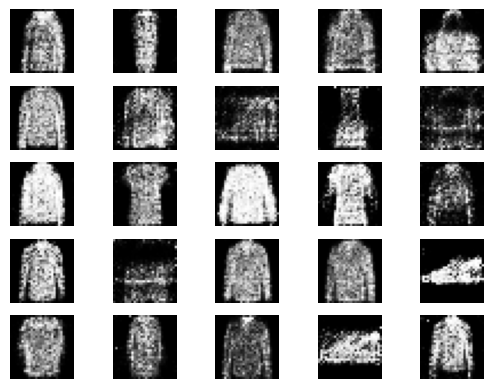

1/1 [==============================] - 0s 33ms/step
12201 [Discriminator loss: 0.665797, acc.: 62.50%] [Generator loss: 1.136861]
1/1 [==============================] - 0s 23ms/step
12202 [Discriminator loss: 0.559554, acc.: 71.88%] [Generator loss: 1.296315]
1/1 [==============================] - 0s 27ms/step
12203 [Discriminator loss: 0.615276, acc.: 67.19%] [Generator loss: 1.125296]
1/1 [==============================] - 0s 24ms/step
12204 [Discriminator loss: 0.699293, acc.: 48.44%] [Generator loss: 1.153660]
1/1 [==============================] - 0s 22ms/step
12205 [Discriminator loss: 0.564099, acc.: 73.44%] [Generator loss: 1.237814]
1/1 [==============================] - 0s 30ms/step
12206 [Discriminator loss: 0.583737, acc.: 68.75%] [Generator loss: 1.155745]
1/1 [==============================] - 0s 22ms/step
12207 [Discriminator loss: 0.568803, acc.: 73.44%] [Generator loss: 1.166467]
1/1 [==============================] - 0s 24ms/step
12208 [Discriminator loss: 0.561658, a

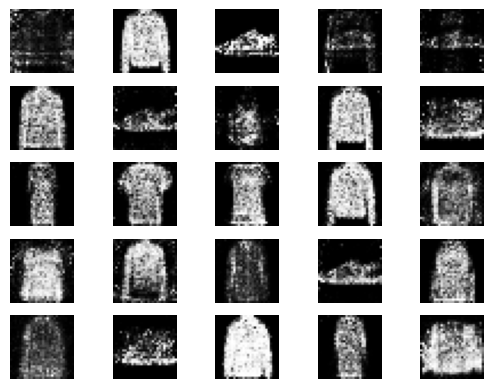

1/1 [==============================] - 0s 52ms/step
12401 [Discriminator loss: 0.543511, acc.: 70.31%] [Generator loss: 1.134178]
1/1 [==============================] - 0s 62ms/step
12402 [Discriminator loss: 0.518123, acc.: 78.12%] [Generator loss: 1.296281]
1/1 [==============================] - 0s 61ms/step
12403 [Discriminator loss: 0.489486, acc.: 73.44%] [Generator loss: 1.171351]
1/1 [==============================] - 0s 48ms/step
12404 [Discriminator loss: 0.478209, acc.: 73.44%] [Generator loss: 1.199947]
1/1 [==============================] - 0s 47ms/step
12405 [Discriminator loss: 0.475617, acc.: 82.81%] [Generator loss: 1.225061]
1/1 [==============================] - 0s 39ms/step
12406 [Discriminator loss: 0.605608, acc.: 62.50%] [Generator loss: 1.227367]
1/1 [==============================] - 0s 32ms/step
12407 [Discriminator loss: 0.586005, acc.: 68.75%] [Generator loss: 1.197523]
1/1 [==============================] - 0s 34ms/step
12408 [Discriminator loss: 0.646235, a

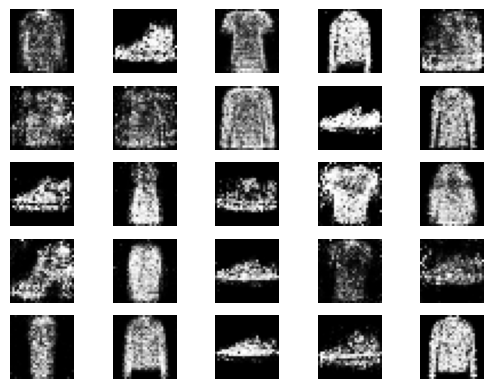

1/1 [==============================] - 0s 27ms/step
12601 [Discriminator loss: 0.545302, acc.: 70.31%] [Generator loss: 1.164052]
1/1 [==============================] - 0s 29ms/step
12602 [Discriminator loss: 0.628374, acc.: 64.06%] [Generator loss: 1.087084]
1/1 [==============================] - 0s 26ms/step
12603 [Discriminator loss: 0.604348, acc.: 68.75%] [Generator loss: 1.100733]
1/1 [==============================] - 0s 25ms/step
12604 [Discriminator loss: 0.547481, acc.: 64.06%] [Generator loss: 1.137951]
1/1 [==============================] - 0s 24ms/step
12605 [Discriminator loss: 0.452915, acc.: 79.69%] [Generator loss: 1.237882]
1/1 [==============================] - 0s 24ms/step
12606 [Discriminator loss: 0.659128, acc.: 60.94%] [Generator loss: 1.032454]
1/1 [==============================] - 0s 25ms/step
12607 [Discriminator loss: 0.699646, acc.: 59.38%] [Generator loss: 0.983883]
1/1 [==============================] - 0s 32ms/step
12608 [Discriminator loss: 0.597012, a

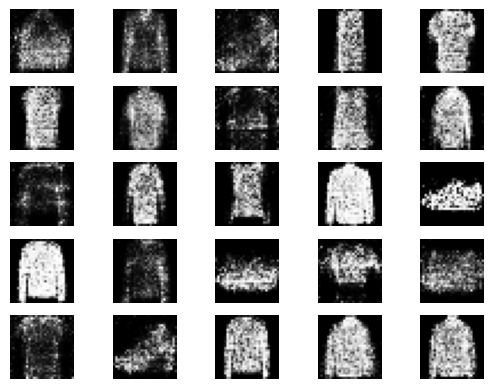

1/1 [==============================] - 0s 42ms/step
12801 [Discriminator loss: 0.533552, acc.: 78.12%] [Generator loss: 1.212802]
1/1 [==============================] - 0s 35ms/step
12802 [Discriminator loss: 0.629070, acc.: 60.94%] [Generator loss: 1.219016]
1/1 [==============================] - 0s 31ms/step
12803 [Discriminator loss: 0.649308, acc.: 64.06%] [Generator loss: 1.131101]
1/1 [==============================] - 0s 33ms/step
12804 [Discriminator loss: 0.462800, acc.: 78.12%] [Generator loss: 1.112027]
1/1 [==============================] - 0s 32ms/step
12805 [Discriminator loss: 0.563842, acc.: 67.19%] [Generator loss: 1.164139]
1/1 [==============================] - 0s 34ms/step
12806 [Discriminator loss: 0.507116, acc.: 75.00%] [Generator loss: 1.081197]
1/1 [==============================] - 0s 39ms/step
12807 [Discriminator loss: 0.628081, acc.: 59.38%] [Generator loss: 1.126438]
1/1 [==============================] - 0s 39ms/step
12808 [Discriminator loss: 0.586648, a

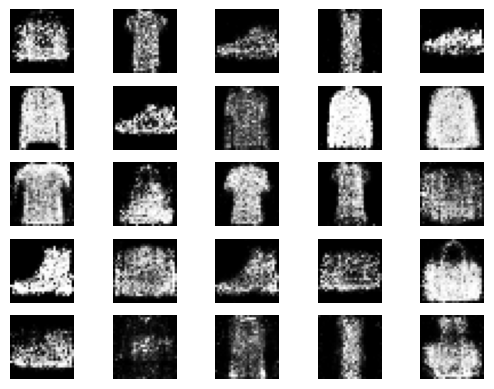

1/1 [==============================] - 0s 26ms/step
13001 [Discriminator loss: 0.476253, acc.: 75.00%] [Generator loss: 1.250438]
1/1 [==============================] - 0s 24ms/step
13002 [Discriminator loss: 0.660682, acc.: 65.62%] [Generator loss: 1.063095]
1/1 [==============================] - 0s 27ms/step
13003 [Discriminator loss: 0.525625, acc.: 73.44%] [Generator loss: 1.243674]
1/1 [==============================] - 0s 39ms/step
13004 [Discriminator loss: 0.493723, acc.: 78.12%] [Generator loss: 1.390654]
1/1 [==============================] - 0s 21ms/step
13005 [Discriminator loss: 0.531034, acc.: 73.44%] [Generator loss: 1.252182]
1/1 [==============================] - 0s 27ms/step
13006 [Discriminator loss: 0.576507, acc.: 70.31%] [Generator loss: 1.229599]
1/1 [==============================] - 0s 23ms/step
13007 [Discriminator loss: 0.479040, acc.: 75.00%] [Generator loss: 1.281444]
1/1 [==============================] - 0s 23ms/step
13008 [Discriminator loss: 0.620679, a

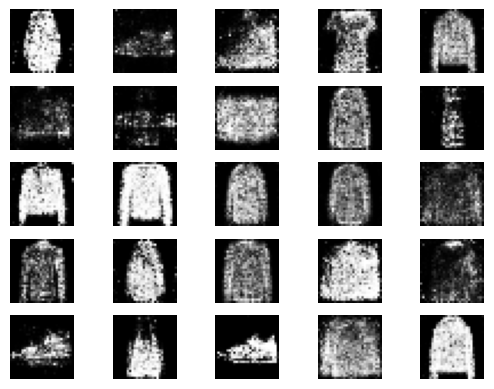

1/1 [==============================] - 0s 39ms/step
13201 [Discriminator loss: 0.560930, acc.: 67.19%] [Generator loss: 1.331751]
1/1 [==============================] - 0s 59ms/step
13202 [Discriminator loss: 0.711562, acc.: 56.25%] [Generator loss: 1.184098]
1/1 [==============================] - 0s 56ms/step
13203 [Discriminator loss: 0.599254, acc.: 68.75%] [Generator loss: 1.008685]
1/1 [==============================] - 0s 44ms/step
13204 [Discriminator loss: 0.653424, acc.: 56.25%] [Generator loss: 1.076277]
1/1 [==============================] - 0s 43ms/step
13205 [Discriminator loss: 0.510004, acc.: 76.56%] [Generator loss: 1.123955]
1/1 [==============================] - 0s 46ms/step
13206 [Discriminator loss: 0.512478, acc.: 75.00%] [Generator loss: 1.293973]
1/1 [==============================] - 0s 71ms/step
13207 [Discriminator loss: 0.602319, acc.: 68.75%] [Generator loss: 1.182423]
1/1 [==============================] - 0s 44ms/step
13208 [Discriminator loss: 0.578011, a

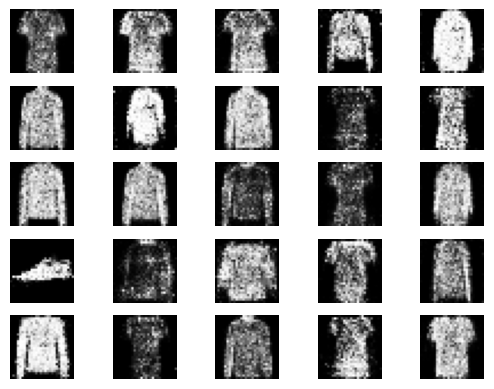

1/1 [==============================] - 0s 27ms/step
13401 [Discriminator loss: 0.541066, acc.: 73.44%] [Generator loss: 1.378425]
1/1 [==============================] - 0s 25ms/step
13402 [Discriminator loss: 0.525203, acc.: 73.44%] [Generator loss: 1.346071]
1/1 [==============================] - 0s 40ms/step
13403 [Discriminator loss: 0.631858, acc.: 67.19%] [Generator loss: 1.292592]
1/1 [==============================] - 0s 27ms/step
13404 [Discriminator loss: 0.593751, acc.: 67.19%] [Generator loss: 1.197349]
1/1 [==============================] - 0s 39ms/step
13405 [Discriminator loss: 0.677066, acc.: 56.25%] [Generator loss: 1.195234]
1/1 [==============================] - 0s 46ms/step
13406 [Discriminator loss: 0.587973, acc.: 71.88%] [Generator loss: 1.077225]
1/1 [==============================] - 0s 42ms/step
13407 [Discriminator loss: 0.561332, acc.: 68.75%] [Generator loss: 0.996895]
1/1 [==============================] - 0s 43ms/step
13408 [Discriminator loss: 0.542204, a

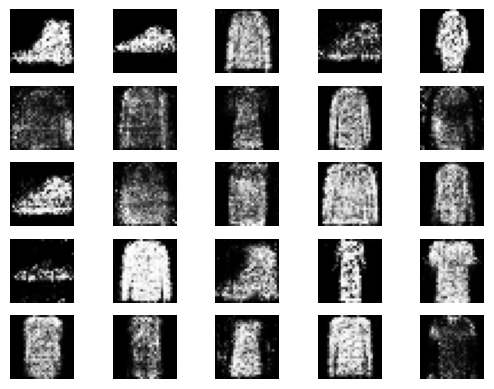

1/1 [==============================] - 0s 33ms/step
13601 [Discriminator loss: 0.512466, acc.: 78.12%] [Generator loss: 1.378582]
1/1 [==============================] - 0s 31ms/step
13602 [Discriminator loss: 0.461596, acc.: 84.38%] [Generator loss: 1.257972]
1/1 [==============================] - 0s 33ms/step
13603 [Discriminator loss: 0.637932, acc.: 59.38%] [Generator loss: 1.173313]
1/1 [==============================] - 0s 35ms/step
13604 [Discriminator loss: 0.568465, acc.: 67.19%] [Generator loss: 1.284816]
1/1 [==============================] - 0s 33ms/step
13605 [Discriminator loss: 0.558529, acc.: 70.31%] [Generator loss: 1.089623]
1/1 [==============================] - 0s 44ms/step
13606 [Discriminator loss: 0.644210, acc.: 64.06%] [Generator loss: 1.177240]
1/1 [==============================] - 0s 33ms/step
13607 [Discriminator loss: 0.606900, acc.: 73.44%] [Generator loss: 1.089323]
1/1 [==============================] - 0s 33ms/step
13608 [Discriminator loss: 0.558746, a

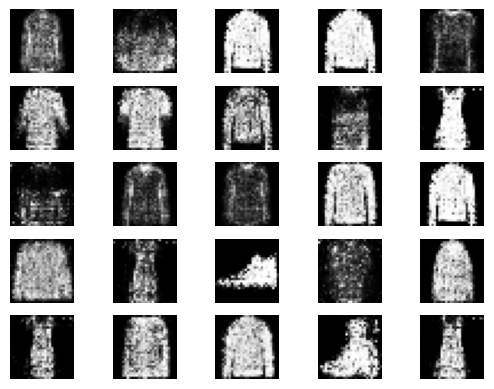

1/1 [==============================] - 0s 25ms/step
13801 [Discriminator loss: 0.581091, acc.: 62.50%] [Generator loss: 1.156525]
1/1 [==============================] - 0s 43ms/step
13802 [Discriminator loss: 0.570391, acc.: 70.31%] [Generator loss: 1.134853]
1/1 [==============================] - 0s 34ms/step
13803 [Discriminator loss: 0.577501, acc.: 67.19%] [Generator loss: 1.157495]
1/1 [==============================] - 0s 24ms/step
13804 [Discriminator loss: 0.556959, acc.: 76.56%] [Generator loss: 1.137073]
1/1 [==============================] - 0s 25ms/step
13805 [Discriminator loss: 0.510794, acc.: 73.44%] [Generator loss: 1.252963]
1/1 [==============================] - 0s 24ms/step
13806 [Discriminator loss: 0.553885, acc.: 70.31%] [Generator loss: 1.041365]
1/1 [==============================] - 0s 24ms/step
13807 [Discriminator loss: 0.631480, acc.: 64.06%] [Generator loss: 1.229731]
1/1 [==============================] - 0s 25ms/step
13808 [Discriminator loss: 0.580949, a

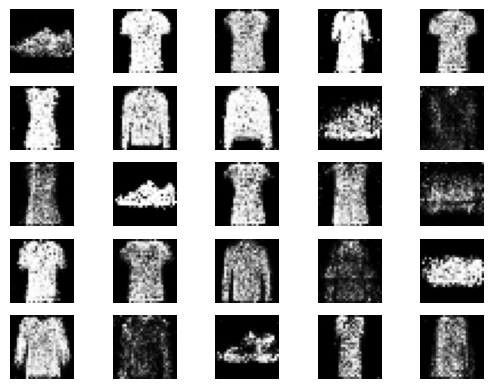

1/1 [==============================] - 0s 31ms/step
14001 [Discriminator loss: 0.540246, acc.: 68.75%] [Generator loss: 1.251976]
1/1 [==============================] - 0s 28ms/step
14002 [Discriminator loss: 0.562049, acc.: 70.31%] [Generator loss: 1.244194]
1/1 [==============================] - 0s 42ms/step
14003 [Discriminator loss: 0.503857, acc.: 73.44%] [Generator loss: 1.203960]
1/1 [==============================] - 0s 30ms/step
14004 [Discriminator loss: 0.498081, acc.: 73.44%] [Generator loss: 1.271635]
1/1 [==============================] - 0s 35ms/step
14005 [Discriminator loss: 0.529903, acc.: 71.88%] [Generator loss: 1.295636]
1/1 [==============================] - 0s 30ms/step
14006 [Discriminator loss: 0.542883, acc.: 70.31%] [Generator loss: 1.216892]
1/1 [==============================] - 0s 29ms/step
14007 [Discriminator loss: 0.549320, acc.: 73.44%] [Generator loss: 1.277463]
1/1 [==============================] - 0s 28ms/step
14008 [Discriminator loss: 0.595588, a

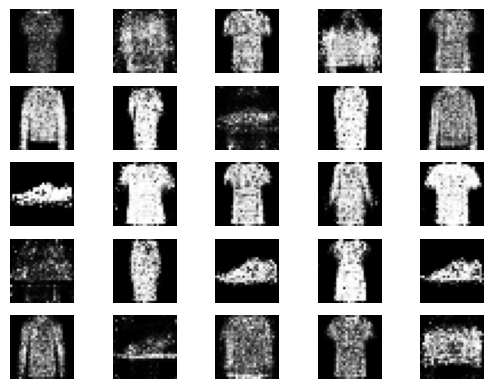

1/1 [==============================] - 0s 24ms/step
14201 [Discriminator loss: 0.591791, acc.: 64.06%] [Generator loss: 1.079064]
1/1 [==============================] - 0s 23ms/step
14202 [Discriminator loss: 0.627393, acc.: 65.62%] [Generator loss: 1.144548]
1/1 [==============================] - 0s 24ms/step
14203 [Discriminator loss: 0.433542, acc.: 85.94%] [Generator loss: 1.051838]
1/1 [==============================] - 0s 25ms/step
14204 [Discriminator loss: 0.536693, acc.: 70.31%] [Generator loss: 1.180421]
1/1 [==============================] - 0s 23ms/step
14205 [Discriminator loss: 0.654033, acc.: 64.06%] [Generator loss: 1.246354]
1/1 [==============================] - 0s 23ms/step
14206 [Discriminator loss: 0.592044, acc.: 62.50%] [Generator loss: 1.105569]
1/1 [==============================] - 0s 26ms/step
14207 [Discriminator loss: 0.568297, acc.: 65.62%] [Generator loss: 1.172788]
1/1 [==============================] - 0s 26ms/step
14208 [Discriminator loss: 0.536046, a

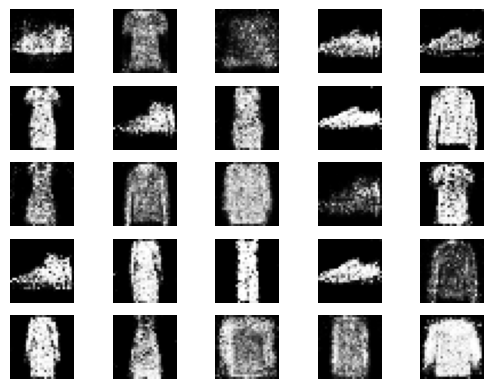

1/1 [==============================] - 0s 23ms/step
14401 [Discriminator loss: 0.668109, acc.: 59.38%] [Generator loss: 1.125343]
1/1 [==============================] - 0s 34ms/step
14402 [Discriminator loss: 0.563924, acc.: 73.44%] [Generator loss: 1.194652]
1/1 [==============================] - 0s 35ms/step
14403 [Discriminator loss: 0.530712, acc.: 78.12%] [Generator loss: 1.141700]
1/1 [==============================] - 0s 45ms/step
14404 [Discriminator loss: 0.594123, acc.: 71.88%] [Generator loss: 1.076599]
1/1 [==============================] - 0s 43ms/step
14405 [Discriminator loss: 0.558672, acc.: 70.31%] [Generator loss: 1.138789]
1/1 [==============================] - 0s 46ms/step
14406 [Discriminator loss: 0.495978, acc.: 79.69%] [Generator loss: 1.180777]
1/1 [==============================] - 0s 62ms/step
14407 [Discriminator loss: 0.521449, acc.: 75.00%] [Generator loss: 1.371222]
1/1 [==============================] - 0s 31ms/step
14408 [Discriminator loss: 0.639516, a

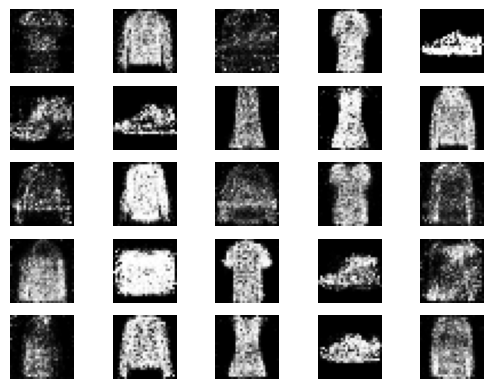

1/1 [==============================] - 0s 36ms/step
14601 [Discriminator loss: 0.551127, acc.: 68.75%] [Generator loss: 1.144571]
1/1 [==============================] - 0s 42ms/step
14602 [Discriminator loss: 0.596900, acc.: 73.44%] [Generator loss: 1.213845]
1/1 [==============================] - 0s 34ms/step
14603 [Discriminator loss: 0.612169, acc.: 67.19%] [Generator loss: 1.138542]
1/1 [==============================] - 0s 34ms/step
14604 [Discriminator loss: 0.518523, acc.: 73.44%] [Generator loss: 1.098211]
1/1 [==============================] - 0s 32ms/step
14605 [Discriminator loss: 0.554093, acc.: 65.62%] [Generator loss: 1.279594]
1/1 [==============================] - 0s 30ms/step
14606 [Discriminator loss: 0.486119, acc.: 76.56%] [Generator loss: 1.308388]
1/1 [==============================] - 0s 38ms/step
14607 [Discriminator loss: 0.555965, acc.: 64.06%] [Generator loss: 1.143450]
1/1 [==============================] - 0s 33ms/step
14608 [Discriminator loss: 0.595472, a

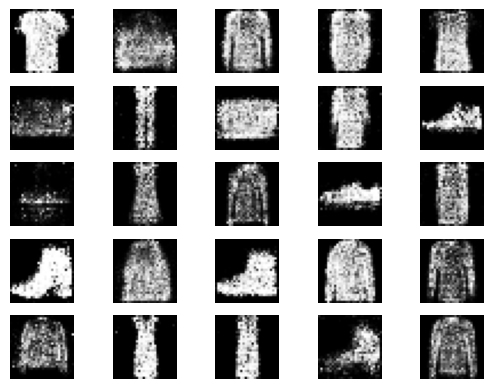

1/1 [==============================] - 0s 23ms/step
14801 [Discriminator loss: 0.565305, acc.: 68.75%] [Generator loss: 1.260036]
1/1 [==============================] - 0s 24ms/step
14802 [Discriminator loss: 0.579761, acc.: 75.00%] [Generator loss: 1.151690]
1/1 [==============================] - 0s 25ms/step
14803 [Discriminator loss: 0.642156, acc.: 64.06%] [Generator loss: 1.288319]
1/1 [==============================] - 0s 28ms/step
14804 [Discriminator loss: 0.624891, acc.: 67.19%] [Generator loss: 1.144853]
1/1 [==============================] - 0s 26ms/step
14805 [Discriminator loss: 0.508552, acc.: 76.56%] [Generator loss: 1.216724]
1/1 [==============================] - 0s 27ms/step
14806 [Discriminator loss: 0.589292, acc.: 64.06%] [Generator loss: 1.082789]
1/1 [==============================] - 0s 25ms/step
14807 [Discriminator loss: 0.538523, acc.: 71.88%] [Generator loss: 1.059633]
1/1 [==============================] - 0s 41ms/step
14808 [Discriminator loss: 0.651394, a

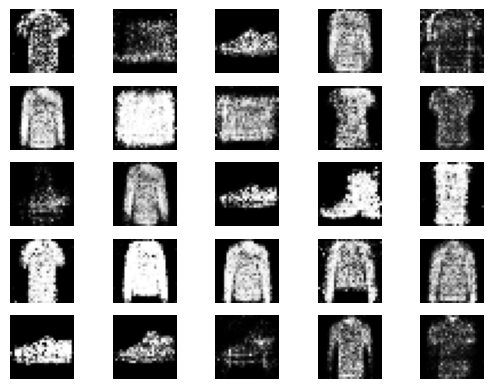

1/1 [==============================] - 0s 37ms/step
15001 [Discriminator loss: 0.638111, acc.: 59.38%] [Generator loss: 1.163745]
1/1 [==============================] - 0s 44ms/step
15002 [Discriminator loss: 0.584585, acc.: 67.19%] [Generator loss: 1.113618]
1/1 [==============================] - 0s 36ms/step
15003 [Discriminator loss: 0.521025, acc.: 71.88%] [Generator loss: 1.180760]
1/1 [==============================] - 0s 44ms/step
15004 [Discriminator loss: 0.578056, acc.: 71.88%] [Generator loss: 1.336637]
1/1 [==============================] - 0s 51ms/step
15005 [Discriminator loss: 0.594818, acc.: 71.88%] [Generator loss: 1.220052]
1/1 [==============================] - 0s 74ms/step
15006 [Discriminator loss: 0.559675, acc.: 70.31%] [Generator loss: 1.359614]
1/1 [==============================] - 0s 50ms/step
15007 [Discriminator loss: 0.545939, acc.: 68.75%] [Generator loss: 1.003598]
1/1 [==============================] - 0s 33ms/step
15008 [Discriminator loss: 0.599980, a

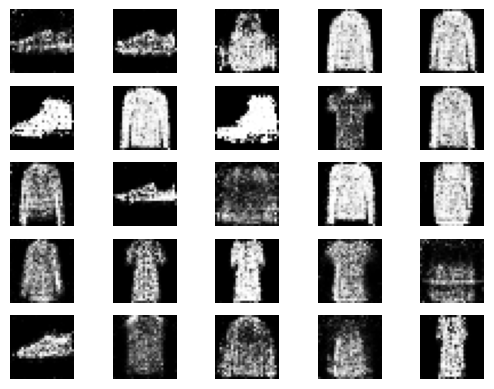

1/1 [==============================] - 0s 24ms/step
15201 [Discriminator loss: 0.555145, acc.: 68.75%] [Generator loss: 1.268399]
1/1 [==============================] - 0s 23ms/step
15202 [Discriminator loss: 0.625337, acc.: 59.38%] [Generator loss: 1.134367]
1/1 [==============================] - 0s 26ms/step
15203 [Discriminator loss: 0.525658, acc.: 70.31%] [Generator loss: 1.185249]
1/1 [==============================] - 0s 24ms/step
15204 [Discriminator loss: 0.581003, acc.: 76.56%] [Generator loss: 1.134484]
1/1 [==============================] - 0s 25ms/step
15205 [Discriminator loss: 0.652237, acc.: 57.81%] [Generator loss: 1.096345]
1/1 [==============================] - 0s 26ms/step
15206 [Discriminator loss: 0.624277, acc.: 65.62%] [Generator loss: 1.131599]
1/1 [==============================] - 0s 25ms/step
15207 [Discriminator loss: 0.593430, acc.: 65.62%] [Generator loss: 1.060372]
1/1 [==============================] - 0s 25ms/step
15208 [Discriminator loss: 0.589643, a

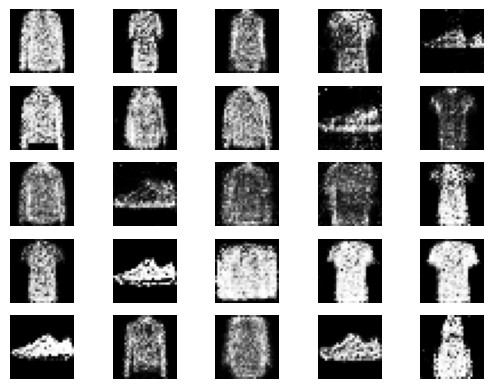

1/1 [==============================] - 0s 32ms/step
15401 [Discriminator loss: 0.571963, acc.: 68.75%] [Generator loss: 1.083006]
1/1 [==============================] - 0s 31ms/step
15402 [Discriminator loss: 0.671568, acc.: 59.38%] [Generator loss: 1.149423]
1/1 [==============================] - 0s 34ms/step
15403 [Discriminator loss: 0.646866, acc.: 67.19%] [Generator loss: 0.983291]
1/1 [==============================] - 0s 31ms/step
15404 [Discriminator loss: 0.558621, acc.: 73.44%] [Generator loss: 1.046006]
1/1 [==============================] - 0s 56ms/step
15405 [Discriminator loss: 0.604782, acc.: 70.31%] [Generator loss: 1.140998]
1/1 [==============================] - 0s 39ms/step
15406 [Discriminator loss: 0.582933, acc.: 65.62%] [Generator loss: 1.228157]
1/1 [==============================] - 0s 34ms/step
15407 [Discriminator loss: 0.650333, acc.: 68.75%] [Generator loss: 1.171961]
1/1 [==============================] - 0s 34ms/step
15408 [Discriminator loss: 0.556595, a

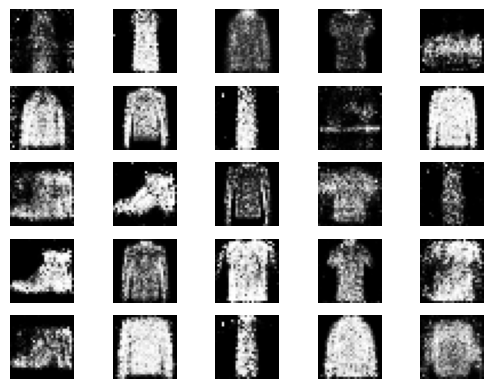

1/1 [==============================] - 0s 32ms/step
15601 [Discriminator loss: 0.555509, acc.: 71.88%] [Generator loss: 1.322619]
1/1 [==============================] - 0s 44ms/step
15602 [Discriminator loss: 0.627875, acc.: 65.62%] [Generator loss: 1.459709]
1/1 [==============================] - 0s 49ms/step
15603 [Discriminator loss: 0.511434, acc.: 81.25%] [Generator loss: 1.279457]
1/1 [==============================] - 0s 56ms/step
15604 [Discriminator loss: 0.467862, acc.: 82.81%] [Generator loss: 1.270815]
1/1 [==============================] - 0s 45ms/step
15605 [Discriminator loss: 0.505485, acc.: 71.88%] [Generator loss: 1.338753]
1/1 [==============================] - 0s 25ms/step
15606 [Discriminator loss: 0.443769, acc.: 81.25%] [Generator loss: 1.361781]
1/1 [==============================] - 0s 29ms/step
15607 [Discriminator loss: 0.589310, acc.: 71.88%] [Generator loss: 1.267868]
1/1 [==============================] - 0s 25ms/step
15608 [Discriminator loss: 0.510511, a

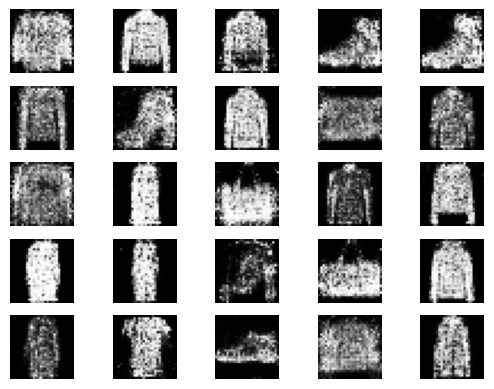

1/1 [==============================] - 0s 34ms/step
15801 [Discriminator loss: 0.634869, acc.: 64.06%] [Generator loss: 1.155742]
1/1 [==============================] - 0s 52ms/step
15802 [Discriminator loss: 0.611841, acc.: 68.75%] [Generator loss: 1.260288]
1/1 [==============================] - 0s 42ms/step
15803 [Discriminator loss: 0.544094, acc.: 70.31%] [Generator loss: 1.466355]
1/1 [==============================] - 0s 34ms/step
15804 [Discriminator loss: 0.617629, acc.: 67.19%] [Generator loss: 1.302732]
1/1 [==============================] - 0s 34ms/step
15805 [Discriminator loss: 0.671556, acc.: 62.50%] [Generator loss: 1.248045]
1/1 [==============================] - 0s 33ms/step
15806 [Discriminator loss: 0.614991, acc.: 67.19%] [Generator loss: 1.110979]
1/1 [==============================] - 0s 34ms/step
15807 [Discriminator loss: 0.651781, acc.: 65.62%] [Generator loss: 1.176563]
1/1 [==============================] - 0s 46ms/step
15808 [Discriminator loss: 0.625919, a

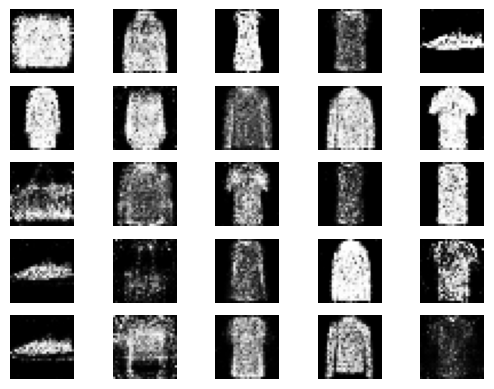

1/1 [==============================] - 0s 25ms/step
16001 [Discriminator loss: 0.530092, acc.: 75.00%] [Generator loss: 1.124466]
1/1 [==============================] - 0s 33ms/step
16002 [Discriminator loss: 0.610121, acc.: 59.38%] [Generator loss: 1.104855]
1/1 [==============================] - 0s 23ms/step
16003 [Discriminator loss: 0.635192, acc.: 64.06%] [Generator loss: 1.058246]
1/1 [==============================] - 0s 30ms/step
16004 [Discriminator loss: 0.586699, acc.: 67.19%] [Generator loss: 1.004624]
1/1 [==============================] - 0s 27ms/step
16005 [Discriminator loss: 0.573807, acc.: 67.19%] [Generator loss: 1.145262]
1/1 [==============================] - 0s 27ms/step
16006 [Discriminator loss: 0.549329, acc.: 75.00%] [Generator loss: 1.171687]
1/1 [==============================] - 0s 26ms/step
16007 [Discriminator loss: 0.598347, acc.: 59.38%] [Generator loss: 1.180961]
1/1 [==============================] - 0s 25ms/step
16008 [Discriminator loss: 0.480114, a

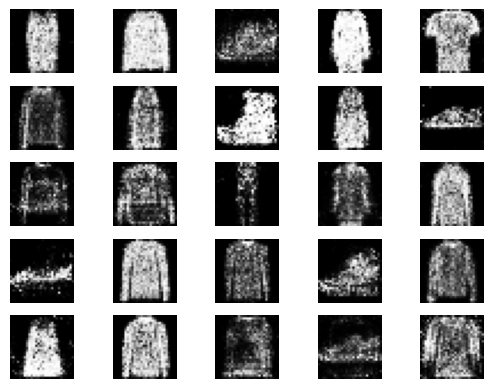

1/1 [==============================] - 0s 36ms/step
16201 [Discriminator loss: 0.576833, acc.: 64.06%] [Generator loss: 1.221031]
1/1 [==============================] - 0s 30ms/step
16202 [Discriminator loss: 0.572338, acc.: 75.00%] [Generator loss: 1.171093]
1/1 [==============================] - 0s 30ms/step
16203 [Discriminator loss: 0.553050, acc.: 71.88%] [Generator loss: 1.108466]
1/1 [==============================] - 0s 33ms/step
16204 [Discriminator loss: 0.547064, acc.: 71.88%] [Generator loss: 1.186430]
1/1 [==============================] - 0s 32ms/step
16205 [Discriminator loss: 0.514112, acc.: 79.69%] [Generator loss: 1.190973]
1/1 [==============================] - 0s 31ms/step
16206 [Discriminator loss: 0.512114, acc.: 73.44%] [Generator loss: 1.327851]
1/1 [==============================] - 0s 34ms/step
16207 [Discriminator loss: 0.676648, acc.: 57.81%] [Generator loss: 1.040751]
1/1 [==============================] - 0s 32ms/step
16208 [Discriminator loss: 0.627366, a

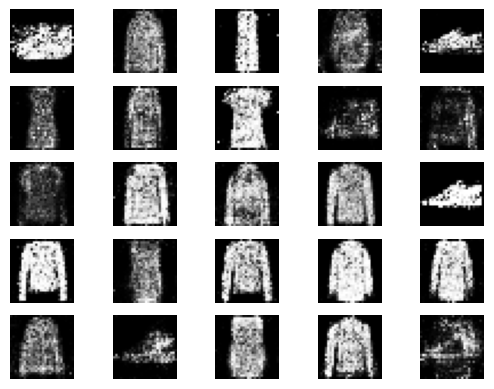

1/1 [==============================] - 0s 30ms/step
16401 [Discriminator loss: 0.549113, acc.: 68.75%] [Generator loss: 1.111228]
1/1 [==============================] - 0s 24ms/step
16402 [Discriminator loss: 0.578226, acc.: 65.62%] [Generator loss: 1.325094]
1/1 [==============================] - 0s 25ms/step
16403 [Discriminator loss: 0.488208, acc.: 79.69%] [Generator loss: 1.198496]
1/1 [==============================] - 0s 44ms/step
16404 [Discriminator loss: 0.617068, acc.: 62.50%] [Generator loss: 1.342732]
1/1 [==============================] - 0s 32ms/step
16405 [Discriminator loss: 0.551072, acc.: 70.31%] [Generator loss: 1.282017]
1/1 [==============================] - 0s 36ms/step
16406 [Discriminator loss: 0.582045, acc.: 68.75%] [Generator loss: 1.207162]
1/1 [==============================] - 0s 68ms/step
16407 [Discriminator loss: 0.531799, acc.: 68.75%] [Generator loss: 1.166034]
1/1 [==============================] - 0s 47ms/step
16408 [Discriminator loss: 0.601443, a

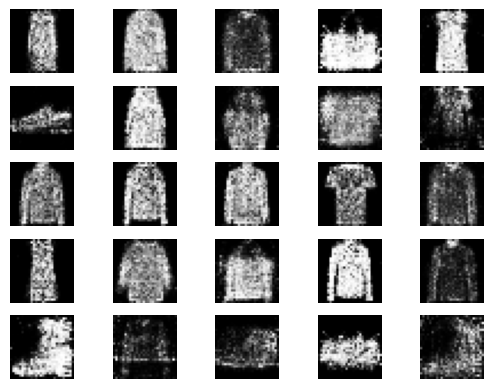

1/1 [==============================] - 0s 32ms/step
16601 [Discriminator loss: 0.548334, acc.: 73.44%] [Generator loss: 1.284366]
1/1 [==============================] - 0s 31ms/step
16602 [Discriminator loss: 0.521846, acc.: 75.00%] [Generator loss: 1.085205]
1/1 [==============================] - 0s 37ms/step
16603 [Discriminator loss: 0.573509, acc.: 71.88%] [Generator loss: 1.197482]
1/1 [==============================] - 0s 51ms/step
16604 [Discriminator loss: 0.515320, acc.: 75.00%] [Generator loss: 1.249660]
1/1 [==============================] - 0s 32ms/step
16605 [Discriminator loss: 0.517374, acc.: 71.88%] [Generator loss: 1.174061]
1/1 [==============================] - 0s 37ms/step
16606 [Discriminator loss: 0.550227, acc.: 70.31%] [Generator loss: 1.240083]
1/1 [==============================] - 0s 32ms/step
16607 [Discriminator loss: 0.617917, acc.: 62.50%] [Generator loss: 1.135417]
1/1 [==============================] - 0s 40ms/step
16608 [Discriminator loss: 0.581569, a

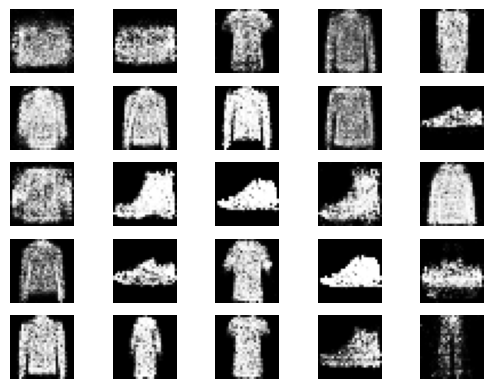

1/1 [==============================] - 0s 29ms/step
16801 [Discriminator loss: 0.480788, acc.: 78.12%] [Generator loss: 1.295949]
1/1 [==============================] - 0s 25ms/step
16802 [Discriminator loss: 0.520321, acc.: 75.00%] [Generator loss: 1.463972]
1/1 [==============================] - 0s 31ms/step
16803 [Discriminator loss: 0.522120, acc.: 70.31%] [Generator loss: 1.215411]
1/1 [==============================] - 0s 25ms/step
16804 [Discriminator loss: 0.669959, acc.: 62.50%] [Generator loss: 1.197221]
1/1 [==============================] - 0s 29ms/step
16805 [Discriminator loss: 0.578089, acc.: 67.19%] [Generator loss: 1.130336]
1/1 [==============================] - 0s 25ms/step
16806 [Discriminator loss: 0.610406, acc.: 70.31%] [Generator loss: 1.226476]
1/1 [==============================] - 0s 26ms/step
16807 [Discriminator loss: 0.523785, acc.: 73.44%] [Generator loss: 1.208230]
1/1 [==============================] - 0s 24ms/step
16808 [Discriminator loss: 0.594637, a

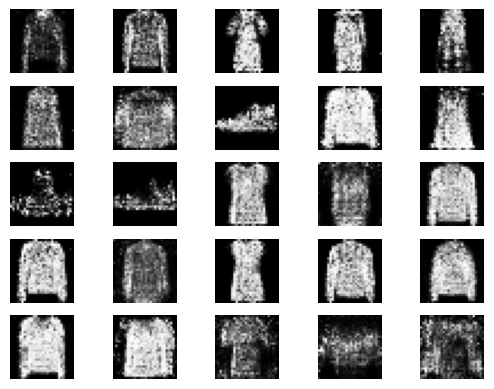

1/1 [==============================] - 0s 58ms/step
17001 [Discriminator loss: 0.562867, acc.: 67.19%] [Generator loss: 1.280638]
1/1 [==============================] - 0s 57ms/step
17002 [Discriminator loss: 0.606052, acc.: 67.19%] [Generator loss: 1.276082]
1/1 [==============================] - 0s 23ms/step
17003 [Discriminator loss: 0.578321, acc.: 70.31%] [Generator loss: 1.322772]
1/1 [==============================] - 0s 23ms/step
17004 [Discriminator loss: 0.610374, acc.: 70.31%] [Generator loss: 1.133062]
1/1 [==============================] - 0s 27ms/step
17005 [Discriminator loss: 0.602403, acc.: 65.62%] [Generator loss: 1.153834]
1/1 [==============================] - 0s 26ms/step
17006 [Discriminator loss: 0.653003, acc.: 53.12%] [Generator loss: 1.046403]
1/1 [==============================] - 0s 37ms/step
17007 [Discriminator loss: 0.604802, acc.: 68.75%] [Generator loss: 0.996018]
1/1 [==============================] - 0s 27ms/step
17008 [Discriminator loss: 0.581346, a

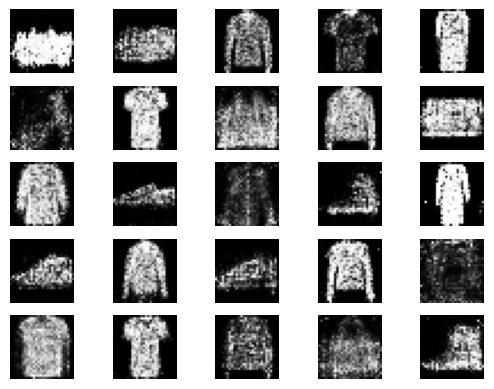

1/1 [==============================] - 0s 32ms/step
17201 [Discriminator loss: 0.523933, acc.: 68.75%] [Generator loss: 1.219917]
1/1 [==============================] - 0s 31ms/step
17202 [Discriminator loss: 0.498609, acc.: 78.12%] [Generator loss: 1.174859]
1/1 [==============================] - 0s 35ms/step
17203 [Discriminator loss: 0.533882, acc.: 70.31%] [Generator loss: 1.114687]
1/1 [==============================] - 0s 35ms/step
17204 [Discriminator loss: 0.592137, acc.: 68.75%] [Generator loss: 1.166145]
1/1 [==============================] - 0s 39ms/step
17205 [Discriminator loss: 0.554342, acc.: 78.12%] [Generator loss: 1.096248]
1/1 [==============================] - 0s 36ms/step
17206 [Discriminator loss: 0.515239, acc.: 73.44%] [Generator loss: 1.019294]
1/1 [==============================] - 0s 34ms/step
17207 [Discriminator loss: 0.532048, acc.: 76.56%] [Generator loss: 1.162822]
1/1 [==============================] - 0s 33ms/step
17208 [Discriminator loss: 0.541647, a

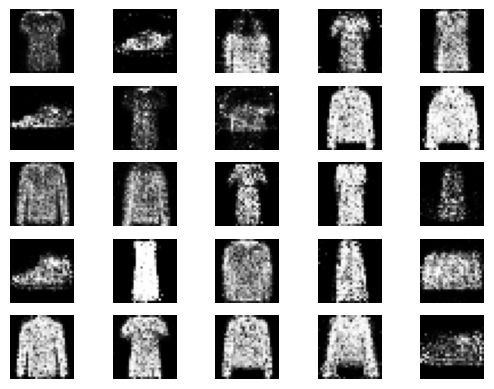

1/1 [==============================] - 0s 29ms/step
17401 [Discriminator loss: 0.527416, acc.: 75.00%] [Generator loss: 1.077261]
1/1 [==============================] - 0s 23ms/step
17402 [Discriminator loss: 0.677546, acc.: 62.50%] [Generator loss: 1.149839]
1/1 [==============================] - 0s 24ms/step
17403 [Discriminator loss: 0.572279, acc.: 68.75%] [Generator loss: 1.320852]
1/1 [==============================] - 0s 32ms/step
17404 [Discriminator loss: 0.538025, acc.: 71.88%] [Generator loss: 1.250958]
1/1 [==============================] - 0s 23ms/step
17405 [Discriminator loss: 0.564542, acc.: 68.75%] [Generator loss: 1.130978]
1/1 [==============================] - 0s 28ms/step
17406 [Discriminator loss: 0.600417, acc.: 68.75%] [Generator loss: 1.191648]
1/1 [==============================] - 0s 27ms/step
17407 [Discriminator loss: 0.515907, acc.: 70.31%] [Generator loss: 1.261389]
1/1 [==============================] - 0s 25ms/step
17408 [Discriminator loss: 0.611382, a

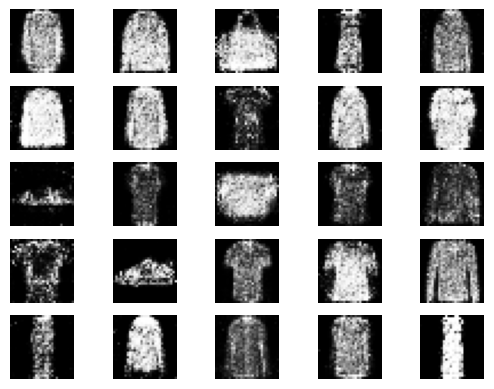

1/1 [==============================] - 0s 44ms/step
17601 [Discriminator loss: 0.606769, acc.: 68.75%] [Generator loss: 1.148858]
1/1 [==============================] - 0s 67ms/step
17602 [Discriminator loss: 0.547898, acc.: 70.31%] [Generator loss: 1.152295]
1/1 [==============================] - 0s 30ms/step
17603 [Discriminator loss: 0.511893, acc.: 73.44%] [Generator loss: 1.187986]
1/1 [==============================] - 0s 31ms/step
17604 [Discriminator loss: 0.529265, acc.: 75.00%] [Generator loss: 1.231341]
1/1 [==============================] - 0s 40ms/step
17605 [Discriminator loss: 0.547711, acc.: 70.31%] [Generator loss: 1.282864]
1/1 [==============================] - 0s 33ms/step
17606 [Discriminator loss: 0.531499, acc.: 75.00%] [Generator loss: 1.191076]
1/1 [==============================] - 0s 34ms/step
17607 [Discriminator loss: 0.641146, acc.: 60.94%] [Generator loss: 1.220128]
1/1 [==============================] - 0s 32ms/step
17608 [Discriminator loss: 0.477878, a

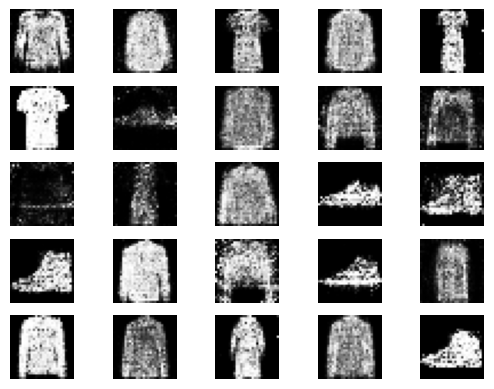

1/1 [==============================] - 0s 42ms/step
17801 [Discriminator loss: 0.571690, acc.: 62.50%] [Generator loss: 1.385359]
1/1 [==============================] - 0s 23ms/step
17802 [Discriminator loss: 0.569287, acc.: 68.75%] [Generator loss: 1.249527]
1/1 [==============================] - 0s 24ms/step
17803 [Discriminator loss: 0.574875, acc.: 67.19%] [Generator loss: 1.313458]
1/1 [==============================] - 0s 25ms/step
17804 [Discriminator loss: 0.556582, acc.: 73.44%] [Generator loss: 1.206554]
1/1 [==============================] - 0s 32ms/step
17805 [Discriminator loss: 0.516160, acc.: 73.44%] [Generator loss: 1.341153]
1/1 [==============================] - 0s 25ms/step
17806 [Discriminator loss: 0.614720, acc.: 73.44%] [Generator loss: 1.246175]
1/1 [==============================] - 0s 25ms/step
17807 [Discriminator loss: 0.610490, acc.: 65.62%] [Generator loss: 1.208721]
1/1 [==============================] - 0s 24ms/step
17808 [Discriminator loss: 0.555172, a

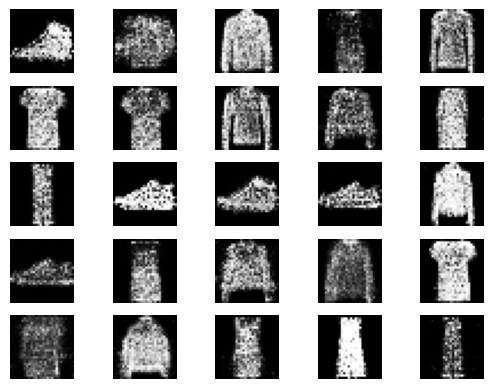

1/1 [==============================] - 0s 71ms/step
18001 [Discriminator loss: 0.513132, acc.: 67.19%] [Generator loss: 1.313304]
1/1 [==============================] - 0s 38ms/step
18002 [Discriminator loss: 0.522204, acc.: 76.56%] [Generator loss: 1.241121]
1/1 [==============================] - 0s 36ms/step
18003 [Discriminator loss: 0.576021, acc.: 73.44%] [Generator loss: 1.195519]
1/1 [==============================] - 0s 47ms/step
18004 [Discriminator loss: 0.606460, acc.: 68.75%] [Generator loss: 1.167339]
1/1 [==============================] - 0s 40ms/step
18005 [Discriminator loss: 0.551533, acc.: 76.56%] [Generator loss: 1.269735]
1/1 [==============================] - 0s 53ms/step
18006 [Discriminator loss: 0.586851, acc.: 65.62%] [Generator loss: 1.147248]
1/1 [==============================] - 0s 34ms/step
18007 [Discriminator loss: 0.506127, acc.: 76.56%] [Generator loss: 1.258280]
1/1 [==============================] - 0s 33ms/step
18008 [Discriminator loss: 0.566300, a

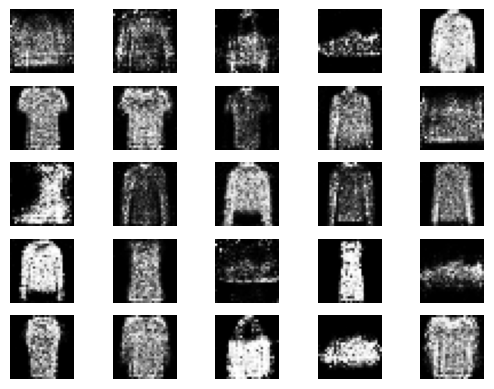

1/1 [==============================] - 0s 27ms/step
18201 [Discriminator loss: 0.581564, acc.: 67.19%] [Generator loss: 1.191481]
1/1 [==============================] - 0s 29ms/step
18202 [Discriminator loss: 0.644644, acc.: 57.81%] [Generator loss: 1.052948]
1/1 [==============================] - 0s 25ms/step
18203 [Discriminator loss: 0.526532, acc.: 71.88%] [Generator loss: 1.204275]
1/1 [==============================] - 0s 29ms/step
18204 [Discriminator loss: 0.585840, acc.: 68.75%] [Generator loss: 1.030945]
1/1 [==============================] - 0s 40ms/step
18205 [Discriminator loss: 0.557947, acc.: 68.75%] [Generator loss: 1.158923]
1/1 [==============================] - 0s 42ms/step
18206 [Discriminator loss: 0.626302, acc.: 67.19%] [Generator loss: 1.232639]
1/1 [==============================] - 0s 47ms/step
18207 [Discriminator loss: 0.618959, acc.: 65.62%] [Generator loss: 1.215313]
1/1 [==============================] - 0s 43ms/step
18208 [Discriminator loss: 0.626495, a

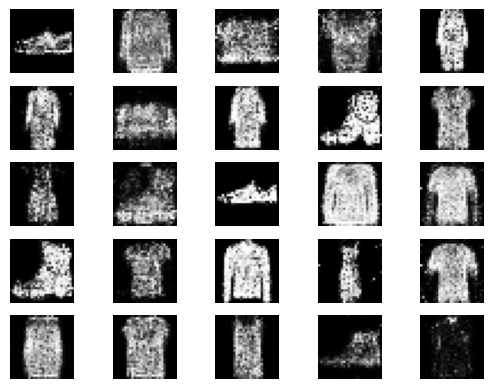

1/1 [==============================] - 0s 29ms/step
18401 [Discriminator loss: 0.648897, acc.: 59.38%] [Generator loss: 1.289454]
1/1 [==============================] - 0s 33ms/step
18402 [Discriminator loss: 0.518415, acc.: 68.75%] [Generator loss: 1.199760]
1/1 [==============================] - 0s 49ms/step
18403 [Discriminator loss: 0.619906, acc.: 59.38%] [Generator loss: 1.129129]
1/1 [==============================] - 0s 29ms/step
18404 [Discriminator loss: 0.572198, acc.: 67.19%] [Generator loss: 1.214095]
1/1 [==============================] - 0s 37ms/step
18405 [Discriminator loss: 0.572074, acc.: 70.31%] [Generator loss: 1.103251]
1/1 [==============================] - 0s 33ms/step
18406 [Discriminator loss: 0.532399, acc.: 73.44%] [Generator loss: 1.179958]
1/1 [==============================] - 0s 32ms/step
18407 [Discriminator loss: 0.611169, acc.: 73.44%] [Generator loss: 1.237353]
1/1 [==============================] - 0s 40ms/step
18408 [Discriminator loss: 0.581886, a

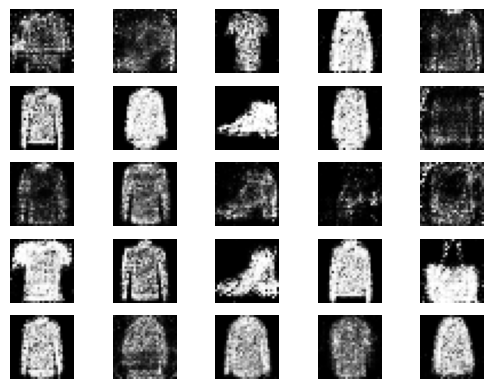

1/1 [==============================] - 0s 24ms/step
18601 [Discriminator loss: 0.473777, acc.: 78.12%] [Generator loss: 1.099422]
1/1 [==============================] - 0s 26ms/step
18602 [Discriminator loss: 0.663748, acc.: 60.94%] [Generator loss: 1.257848]
1/1 [==============================] - 0s 32ms/step
18603 [Discriminator loss: 0.534799, acc.: 73.44%] [Generator loss: 1.040790]
1/1 [==============================] - 0s 31ms/step
18604 [Discriminator loss: 0.561680, acc.: 68.75%] [Generator loss: 1.278552]
1/1 [==============================] - 0s 27ms/step
18605 [Discriminator loss: 0.586756, acc.: 64.06%] [Generator loss: 1.161956]
1/1 [==============================] - 0s 28ms/step
18606 [Discriminator loss: 0.462599, acc.: 76.56%] [Generator loss: 1.144760]
1/1 [==============================] - 0s 35ms/step
18607 [Discriminator loss: 0.739956, acc.: 50.00%] [Generator loss: 1.113243]
1/1 [==============================] - 0s 29ms/step
18608 [Discriminator loss: 0.584671, a

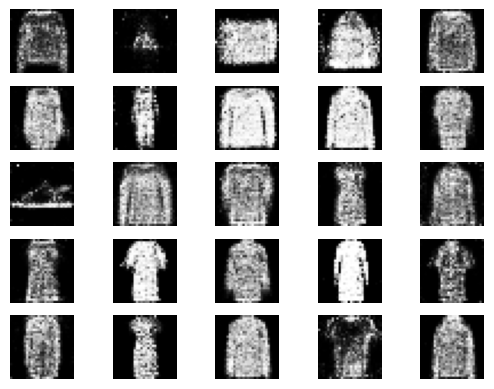

1/1 [==============================] - 0s 43ms/step
18801 [Discriminator loss: 0.584753, acc.: 75.00%] [Generator loss: 1.307171]
1/1 [==============================] - 0s 54ms/step
18802 [Discriminator loss: 0.534982, acc.: 71.88%] [Generator loss: 1.365812]
1/1 [==============================] - 0s 57ms/step
18803 [Discriminator loss: 0.478993, acc.: 73.44%] [Generator loss: 1.316426]
1/1 [==============================] - 0s 77ms/step
18804 [Discriminator loss: 0.615376, acc.: 64.06%] [Generator loss: 1.335453]
1/1 [==============================] - 0s 32ms/step
18805 [Discriminator loss: 0.619120, acc.: 62.50%] [Generator loss: 1.287168]
1/1 [==============================] - 0s 29ms/step
18806 [Discriminator loss: 0.682858, acc.: 64.06%] [Generator loss: 1.126063]
1/1 [==============================] - 0s 31ms/step
18807 [Discriminator loss: 0.601809, acc.: 64.06%] [Generator loss: 1.119130]
1/1 [==============================] - 0s 39ms/step
18808 [Discriminator loss: 0.661809, a

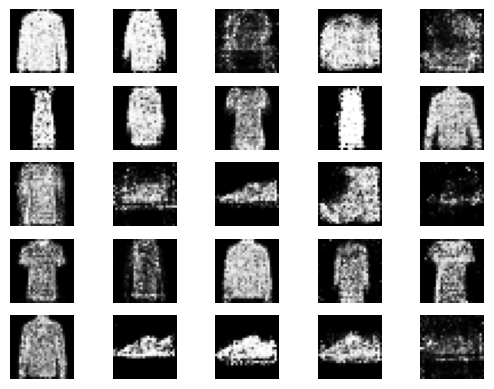

1/1 [==============================] - 0s 24ms/step
19001 [Discriminator loss: 0.516344, acc.: 73.44%] [Generator loss: 1.144798]
1/1 [==============================] - 0s 25ms/step
19002 [Discriminator loss: 0.604177, acc.: 59.38%] [Generator loss: 1.129620]
1/1 [==============================] - 0s 23ms/step
19003 [Discriminator loss: 0.596467, acc.: 68.75%] [Generator loss: 1.181153]
1/1 [==============================] - 0s 26ms/step
19004 [Discriminator loss: 0.556331, acc.: 65.62%] [Generator loss: 1.273387]
1/1 [==============================] - 0s 25ms/step
19005 [Discriminator loss: 0.551802, acc.: 68.75%] [Generator loss: 1.105803]
1/1 [==============================] - 0s 24ms/step
19006 [Discriminator loss: 0.656869, acc.: 68.75%] [Generator loss: 1.212321]
1/1 [==============================] - 0s 23ms/step
19007 [Discriminator loss: 0.507243, acc.: 71.88%] [Generator loss: 1.088388]
1/1 [==============================] - 0s 33ms/step
19008 [Discriminator loss: 0.456342, a

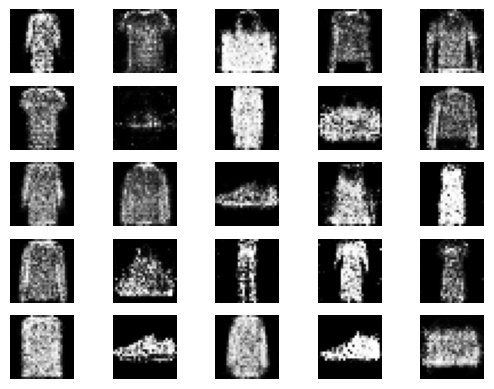

1/1 [==============================] - 0s 24ms/step
19201 [Discriminator loss: 0.550088, acc.: 73.44%] [Generator loss: 1.126102]
1/1 [==============================] - 0s 26ms/step
19202 [Discriminator loss: 0.582016, acc.: 68.75%] [Generator loss: 1.222939]
1/1 [==============================] - 0s 25ms/step
19203 [Discriminator loss: 0.549542, acc.: 73.44%] [Generator loss: 1.198366]
1/1 [==============================] - 0s 23ms/step
19204 [Discriminator loss: 0.617275, acc.: 64.06%] [Generator loss: 1.198366]
1/1 [==============================] - 0s 25ms/step
19205 [Discriminator loss: 0.619813, acc.: 59.38%] [Generator loss: 1.085861]
1/1 [==============================] - 0s 22ms/step
19206 [Discriminator loss: 0.559243, acc.: 70.31%] [Generator loss: 1.298812]
1/1 [==============================] - 0s 25ms/step
19207 [Discriminator loss: 0.577283, acc.: 75.00%] [Generator loss: 1.098513]
1/1 [==============================] - 0s 22ms/step
19208 [Discriminator loss: 0.496761, a

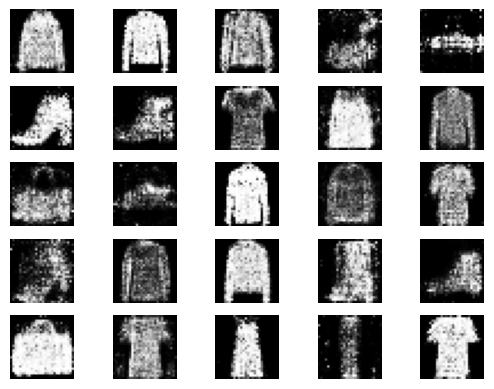

1/1 [==============================] - 0s 43ms/step
19401 [Discriminator loss: 0.510513, acc.: 76.56%] [Generator loss: 1.304326]
1/1 [==============================] - 0s 79ms/step
19402 [Discriminator loss: 0.552496, acc.: 71.88%] [Generator loss: 1.175769]
1/1 [==============================] - 0s 59ms/step
19403 [Discriminator loss: 0.692778, acc.: 68.75%] [Generator loss: 1.155694]
1/1 [==============================] - 0s 37ms/step
19404 [Discriminator loss: 0.570150, acc.: 73.44%] [Generator loss: 1.386083]
1/1 [==============================] - 0s 37ms/step
19405 [Discriminator loss: 0.537686, acc.: 71.88%] [Generator loss: 1.167431]
1/1 [==============================] - 0s 29ms/step
19406 [Discriminator loss: 0.537228, acc.: 75.00%] [Generator loss: 1.193635]
1/1 [==============================] - 0s 29ms/step
19407 [Discriminator loss: 0.633839, acc.: 65.62%] [Generator loss: 1.234506]
1/1 [==============================] - 0s 27ms/step
19408 [Discriminator loss: 0.456841, a

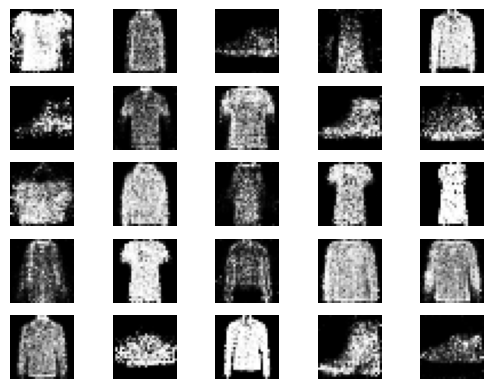

1/1 [==============================] - 0s 26ms/step
19601 [Discriminator loss: 0.590799, acc.: 67.19%] [Generator loss: 1.287989]
1/1 [==============================] - 0s 34ms/step
19602 [Discriminator loss: 0.526306, acc.: 73.44%] [Generator loss: 1.297181]
1/1 [==============================] - 0s 23ms/step
19603 [Discriminator loss: 0.512610, acc.: 78.12%] [Generator loss: 1.372663]
1/1 [==============================] - 0s 23ms/step
19604 [Discriminator loss: 0.632813, acc.: 65.62%] [Generator loss: 1.230414]
1/1 [==============================] - 0s 22ms/step
19605 [Discriminator loss: 0.584744, acc.: 68.75%] [Generator loss: 1.114589]
1/1 [==============================] - 0s 23ms/step
19606 [Discriminator loss: 0.536224, acc.: 76.56%] [Generator loss: 1.122451]
1/1 [==============================] - 0s 27ms/step
19607 [Discriminator loss: 0.537930, acc.: 73.44%] [Generator loss: 1.190872]
1/1 [==============================] - 0s 24ms/step
19608 [Discriminator loss: 0.580733, a

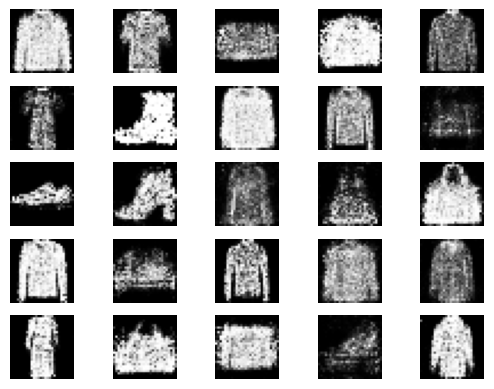

1/1 [==============================] - 0s 28ms/step
19801 [Discriminator loss: 0.592993, acc.: 64.06%] [Generator loss: 1.316623]
1/1 [==============================] - 0s 35ms/step
19802 [Discriminator loss: 0.589111, acc.: 68.75%] [Generator loss: 1.115827]
1/1 [==============================] - 0s 30ms/step
19803 [Discriminator loss: 0.555901, acc.: 75.00%] [Generator loss: 1.335989]
1/1 [==============================] - 0s 28ms/step
19804 [Discriminator loss: 0.542903, acc.: 70.31%] [Generator loss: 1.277336]
1/1 [==============================] - 0s 41ms/step
19805 [Discriminator loss: 0.585263, acc.: 71.88%] [Generator loss: 1.090533]
1/1 [==============================] - 0s 36ms/step
19806 [Discriminator loss: 0.624982, acc.: 62.50%] [Generator loss: 1.144562]
1/1 [==============================] - 0s 30ms/step
19807 [Discriminator loss: 0.470802, acc.: 84.38%] [Generator loss: 1.273689]
1/1 [==============================] - 0s 35ms/step
19808 [Discriminator loss: 0.585068, a

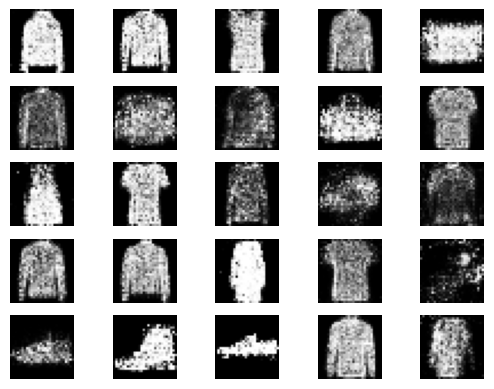

1/1 [==============================] - 0s 28ms/step
20001 [Discriminator loss: 0.692210, acc.: 62.50%] [Generator loss: 1.216125]
1/1 [==============================] - 0s 25ms/step
20002 [Discriminator loss: 0.518806, acc.: 71.88%] [Generator loss: 1.079163]
1/1 [==============================] - 0s 34ms/step
20003 [Discriminator loss: 0.526986, acc.: 68.75%] [Generator loss: 1.046008]
1/1 [==============================] - 0s 26ms/step
20004 [Discriminator loss: 0.641793, acc.: 64.06%] [Generator loss: 1.066120]
1/1 [==============================] - 0s 26ms/step
20005 [Discriminator loss: 0.619103, acc.: 71.88%] [Generator loss: 1.080894]
1/1 [==============================] - 0s 25ms/step
20006 [Discriminator loss: 0.599298, acc.: 70.31%] [Generator loss: 1.028565]
1/1 [==============================] - 0s 26ms/step
20007 [Discriminator loss: 0.653865, acc.: 59.38%] [Generator loss: 1.006503]
1/1 [==============================] - 0s 37ms/step
20008 [Discriminator loss: 0.643512, a

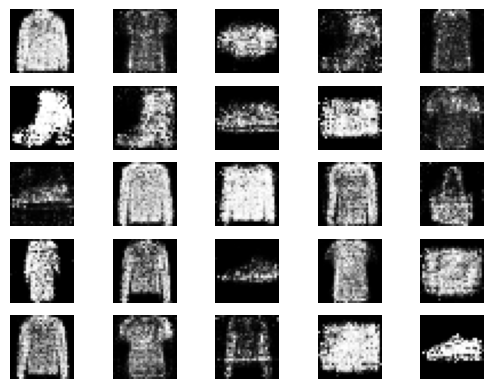

1/1 [==============================] - 0s 30ms/step
20201 [Discriminator loss: 0.558197, acc.: 65.62%] [Generator loss: 1.287034]
1/1 [==============================] - 0s 28ms/step
20202 [Discriminator loss: 0.562061, acc.: 62.50%] [Generator loss: 1.218629]
1/1 [==============================] - 0s 28ms/step
20203 [Discriminator loss: 0.586261, acc.: 62.50%] [Generator loss: 1.143086]
1/1 [==============================] - 0s 28ms/step
20204 [Discriminator loss: 0.562365, acc.: 71.88%] [Generator loss: 1.249270]
1/1 [==============================] - 0s 35ms/step
20205 [Discriminator loss: 0.552616, acc.: 71.88%] [Generator loss: 1.140842]
1/1 [==============================] - 0s 39ms/step
20206 [Discriminator loss: 0.562516, acc.: 68.75%] [Generator loss: 1.136436]
1/1 [==============================] - 0s 31ms/step
20207 [Discriminator loss: 0.558907, acc.: 70.31%] [Generator loss: 1.243894]
1/1 [==============================] - 0s 29ms/step
20208 [Discriminator loss: 0.516643, a

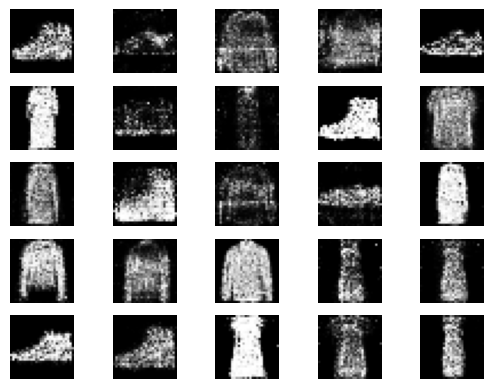

1/1 [==============================] - 0s 31ms/step
20401 [Discriminator loss: 0.605081, acc.: 65.62%] [Generator loss: 1.163674]
1/1 [==============================] - 0s 24ms/step
20402 [Discriminator loss: 0.532771, acc.: 76.56%] [Generator loss: 1.204918]
1/1 [==============================] - 0s 23ms/step
20403 [Discriminator loss: 0.554369, acc.: 70.31%] [Generator loss: 1.148039]
1/1 [==============================] - 0s 26ms/step
20404 [Discriminator loss: 0.612135, acc.: 68.75%] [Generator loss: 1.386198]
1/1 [==============================] - 0s 24ms/step
20405 [Discriminator loss: 0.653010, acc.: 60.94%] [Generator loss: 1.129293]
1/1 [==============================] - 0s 23ms/step
20406 [Discriminator loss: 0.579181, acc.: 76.56%] [Generator loss: 1.185793]
1/1 [==============================] - 0s 23ms/step
20407 [Discriminator loss: 0.483874, acc.: 73.44%] [Generator loss: 1.270514]
1/1 [==============================] - 0s 25ms/step
20408 [Discriminator loss: 0.587342, a

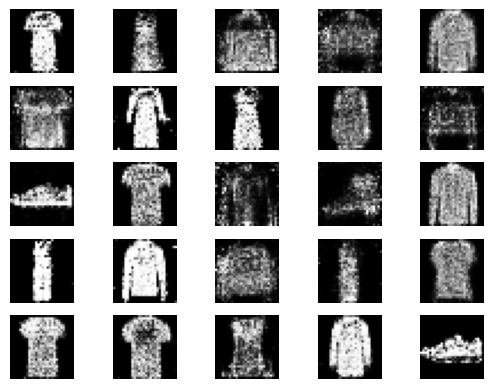

1/1 [==============================] - 0s 34ms/step
20601 [Discriminator loss: 0.569488, acc.: 71.88%] [Generator loss: 1.182297]
1/1 [==============================] - 0s 30ms/step
20602 [Discriminator loss: 0.482921, acc.: 78.12%] [Generator loss: 1.179273]
1/1 [==============================] - 0s 48ms/step
20603 [Discriminator loss: 0.540509, acc.: 70.31%] [Generator loss: 1.230288]
1/1 [==============================] - 0s 30ms/step
20604 [Discriminator loss: 0.604733, acc.: 65.62%] [Generator loss: 1.243070]
1/1 [==============================] - 0s 37ms/step
20605 [Discriminator loss: 0.604212, acc.: 59.38%] [Generator loss: 1.171984]
1/1 [==============================] - 0s 33ms/step
20606 [Discriminator loss: 0.637275, acc.: 62.50%] [Generator loss: 1.256965]
1/1 [==============================] - 0s 38ms/step
20607 [Discriminator loss: 0.523544, acc.: 73.44%] [Generator loss: 1.380528]
1/1 [==============================] - 0s 35ms/step
20608 [Discriminator loss: 0.522689, a

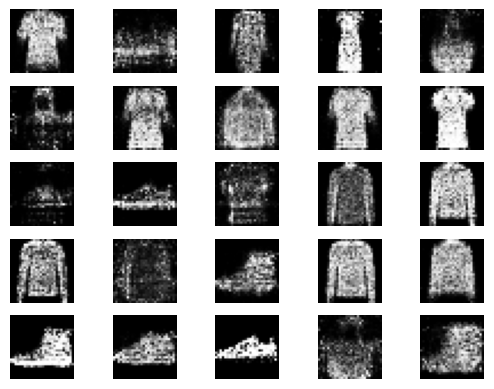

1/1 [==============================] - 0s 24ms/step
20801 [Discriminator loss: 0.603010, acc.: 64.06%] [Generator loss: 1.126697]
1/1 [==============================] - 0s 22ms/step
20802 [Discriminator loss: 0.526393, acc.: 70.31%] [Generator loss: 1.181087]
1/1 [==============================] - 0s 23ms/step
20803 [Discriminator loss: 0.627160, acc.: 57.81%] [Generator loss: 1.065758]
1/1 [==============================] - 0s 27ms/step
20804 [Discriminator loss: 0.490495, acc.: 79.69%] [Generator loss: 1.097398]
1/1 [==============================] - 0s 23ms/step
20805 [Discriminator loss: 0.563237, acc.: 71.88%] [Generator loss: 1.102352]
1/1 [==============================] - 0s 23ms/step
20806 [Discriminator loss: 0.643054, acc.: 59.38%] [Generator loss: 1.078333]
1/1 [==============================] - 0s 23ms/step
20807 [Discriminator loss: 0.514912, acc.: 70.31%] [Generator loss: 1.162094]
1/1 [==============================] - 0s 24ms/step
20808 [Discriminator loss: 0.611411, a

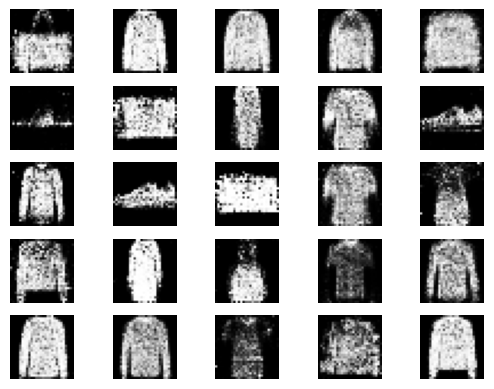

1/1 [==============================] - 0s 33ms/step
21001 [Discriminator loss: 0.549650, acc.: 62.50%] [Generator loss: 1.304636]
1/1 [==============================] - 0s 29ms/step
21002 [Discriminator loss: 0.493937, acc.: 75.00%] [Generator loss: 1.149995]
1/1 [==============================] - 0s 53ms/step
21003 [Discriminator loss: 0.505706, acc.: 79.69%] [Generator loss: 1.261651]
1/1 [==============================] - 0s 29ms/step
21004 [Discriminator loss: 0.556343, acc.: 75.00%] [Generator loss: 1.068178]
1/1 [==============================] - 0s 23ms/step
21005 [Discriminator loss: 0.580539, acc.: 70.31%] [Generator loss: 1.115835]
1/1 [==============================] - 0s 35ms/step
21006 [Discriminator loss: 0.543902, acc.: 67.19%] [Generator loss: 1.019716]
1/1 [==============================] - 0s 25ms/step
21007 [Discriminator loss: 0.588513, acc.: 64.06%] [Generator loss: 1.151216]
1/1 [==============================] - 0s 26ms/step
21008 [Discriminator loss: 0.517716, a

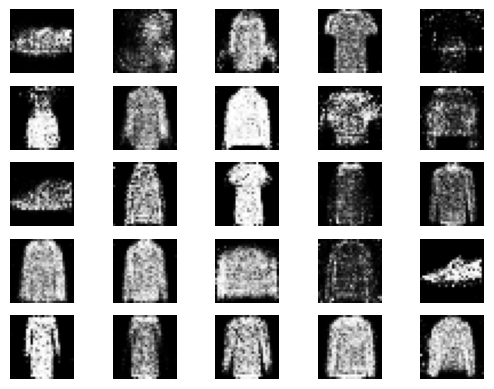

1/1 [==============================] - 0s 30ms/step
21201 [Discriminator loss: 0.717331, acc.: 57.81%] [Generator loss: 1.128031]
1/1 [==============================] - 0s 28ms/step
21202 [Discriminator loss: 0.642149, acc.: 60.94%] [Generator loss: 1.287814]
1/1 [==============================] - 0s 29ms/step
21203 [Discriminator loss: 0.539701, acc.: 73.44%] [Generator loss: 1.262639]
1/1 [==============================] - 0s 28ms/step
21204 [Discriminator loss: 0.517605, acc.: 70.31%] [Generator loss: 1.335472]
1/1 [==============================] - 0s 33ms/step
21205 [Discriminator loss: 0.653101, acc.: 60.94%] [Generator loss: 1.321644]
1/1 [==============================] - 0s 33ms/step
21206 [Discriminator loss: 0.560156, acc.: 71.88%] [Generator loss: 1.127916]
1/1 [==============================] - 0s 27ms/step
21207 [Discriminator loss: 0.624788, acc.: 65.62%] [Generator loss: 1.131372]
1/1 [==============================] - 0s 28ms/step
21208 [Discriminator loss: 0.645013, a

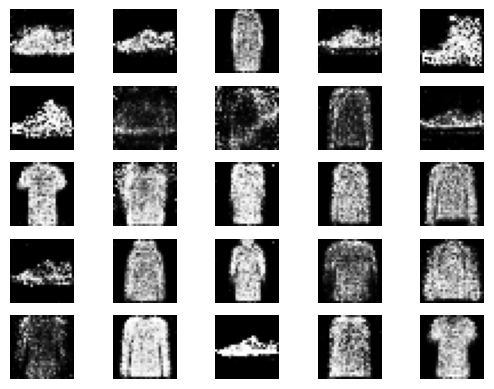

1/1 [==============================] - 0s 34ms/step
21401 [Discriminator loss: 0.578588, acc.: 67.19%] [Generator loss: 1.264694]
1/1 [==============================] - 0s 25ms/step
21402 [Discriminator loss: 0.543975, acc.: 78.12%] [Generator loss: 1.446811]
1/1 [==============================] - 0s 22ms/step
21403 [Discriminator loss: 0.552227, acc.: 71.88%] [Generator loss: 1.278925]
1/1 [==============================] - 0s 24ms/step
21404 [Discriminator loss: 0.561090, acc.: 70.31%] [Generator loss: 1.281714]
1/1 [==============================] - 0s 24ms/step
21405 [Discriminator loss: 0.587541, acc.: 67.19%] [Generator loss: 1.220154]
1/1 [==============================] - 0s 23ms/step
21406 [Discriminator loss: 0.688655, acc.: 60.94%] [Generator loss: 1.278763]
1/1 [==============================] - 0s 23ms/step
21407 [Discriminator loss: 0.526158, acc.: 73.44%] [Generator loss: 1.168756]
1/1 [==============================] - 0s 22ms/step
21408 [Discriminator loss: 0.543010, a

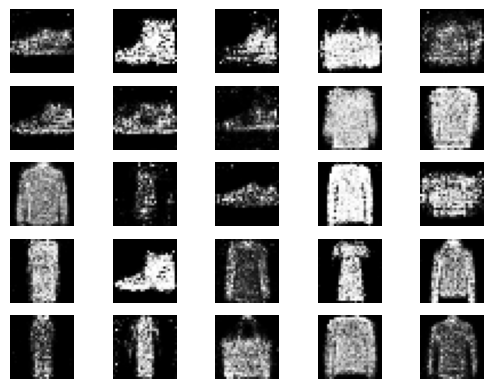

1/1 [==============================] - 0s 81ms/step
21601 [Discriminator loss: 0.638698, acc.: 60.94%] [Generator loss: 1.299598]
1/1 [==============================] - 0s 38ms/step
21602 [Discriminator loss: 0.537169, acc.: 68.75%] [Generator loss: 1.240505]
1/1 [==============================] - 0s 40ms/step
21603 [Discriminator loss: 0.662566, acc.: 62.50%] [Generator loss: 1.123700]
1/1 [==============================] - 0s 57ms/step
21604 [Discriminator loss: 0.614893, acc.: 64.06%] [Generator loss: 1.183192]
1/1 [==============================] - 0s 56ms/step
21605 [Discriminator loss: 0.487467, acc.: 76.56%] [Generator loss: 1.176250]
1/1 [==============================] - 0s 50ms/step
21606 [Discriminator loss: 0.551556, acc.: 65.62%] [Generator loss: 1.310405]
1/1 [==============================] - 0s 31ms/step
21607 [Discriminator loss: 0.536413, acc.: 73.44%] [Generator loss: 1.379432]
1/1 [==============================] - 0s 33ms/step
21608 [Discriminator loss: 0.584727, a

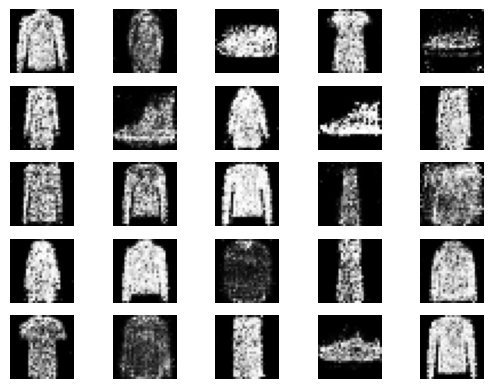

1/1 [==============================] - 0s 25ms/step
21801 [Discriminator loss: 0.513485, acc.: 76.56%] [Generator loss: 1.183053]
1/1 [==============================] - 0s 24ms/step
21802 [Discriminator loss: 0.669416, acc.: 57.81%] [Generator loss: 1.177963]
1/1 [==============================] - 0s 23ms/step
21803 [Discriminator loss: 0.560423, acc.: 75.00%] [Generator loss: 1.278909]
1/1 [==============================] - 0s 28ms/step
21804 [Discriminator loss: 0.581184, acc.: 68.75%] [Generator loss: 1.257185]
1/1 [==============================] - 0s 27ms/step
21805 [Discriminator loss: 0.585923, acc.: 62.50%] [Generator loss: 1.327667]
1/1 [==============================] - 0s 27ms/step
21806 [Discriminator loss: 0.589036, acc.: 67.19%] [Generator loss: 1.325561]
1/1 [==============================] - 0s 21ms/step
21807 [Discriminator loss: 0.683696, acc.: 62.50%] [Generator loss: 1.250708]
1/1 [==============================] - 0s 23ms/step
21808 [Discriminator loss: 0.595168, a

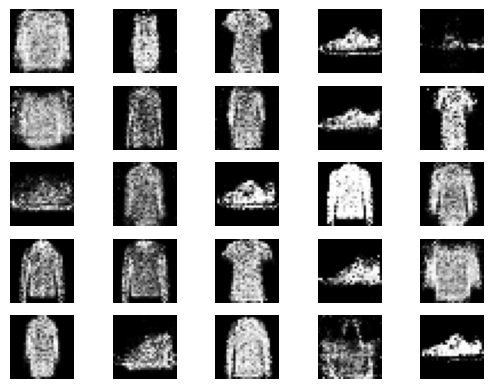

1/1 [==============================] - 0s 28ms/step
22001 [Discriminator loss: 0.590975, acc.: 68.75%] [Generator loss: 1.348912]
1/1 [==============================] - 0s 34ms/step
22002 [Discriminator loss: 0.540555, acc.: 78.12%] [Generator loss: 1.231061]
1/1 [==============================] - 0s 43ms/step
22003 [Discriminator loss: 0.584442, acc.: 67.19%] [Generator loss: 1.241372]
1/1 [==============================] - 0s 37ms/step
22004 [Discriminator loss: 0.511997, acc.: 73.44%] [Generator loss: 1.285005]
1/1 [==============================] - 0s 29ms/step
22005 [Discriminator loss: 0.563482, acc.: 70.31%] [Generator loss: 1.170293]
1/1 [==============================] - 0s 29ms/step
22006 [Discriminator loss: 0.507508, acc.: 76.56%] [Generator loss: 1.193370]
1/1 [==============================] - 0s 29ms/step
22007 [Discriminator loss: 0.507713, acc.: 76.56%] [Generator loss: 1.267870]
1/1 [==============================] - 0s 33ms/step
22008 [Discriminator loss: 0.573544, a

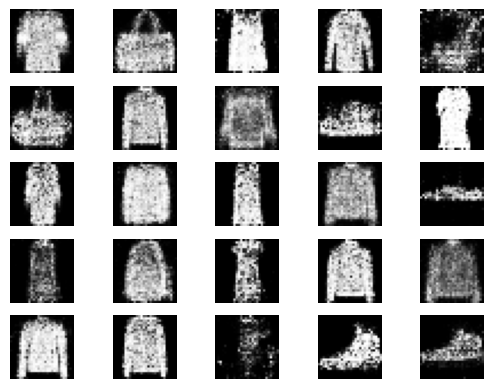

1/1 [==============================] - 0s 24ms/step
22201 [Discriminator loss: 0.617893, acc.: 68.75%] [Generator loss: 1.129235]
1/1 [==============================] - 0s 24ms/step
22202 [Discriminator loss: 0.500911, acc.: 79.69%] [Generator loss: 1.162439]
1/1 [==============================] - 0s 25ms/step
22203 [Discriminator loss: 0.570289, acc.: 68.75%] [Generator loss: 1.244434]
1/1 [==============================] - 0s 33ms/step
22204 [Discriminator loss: 0.623118, acc.: 59.38%] [Generator loss: 1.159376]
1/1 [==============================] - 0s 45ms/step
22205 [Discriminator loss: 0.452669, acc.: 81.25%] [Generator loss: 1.194737]
1/1 [==============================] - 0s 59ms/step
22206 [Discriminator loss: 0.487596, acc.: 76.56%] [Generator loss: 1.236049]
1/1 [==============================] - 0s 36ms/step
22207 [Discriminator loss: 0.540845, acc.: 67.19%] [Generator loss: 1.394046]
1/1 [==============================] - 0s 47ms/step
22208 [Discriminator loss: 0.480047, a

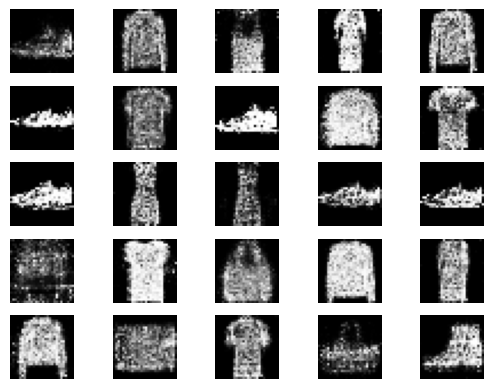

1/1 [==============================] - 0s 34ms/step
22401 [Discriminator loss: 0.516557, acc.: 73.44%] [Generator loss: 1.141976]
1/1 [==============================] - 0s 35ms/step
22402 [Discriminator loss: 0.617376, acc.: 64.06%] [Generator loss: 1.212613]
1/1 [==============================] - 0s 35ms/step
22403 [Discriminator loss: 0.617345, acc.: 60.94%] [Generator loss: 1.024842]
1/1 [==============================] - 0s 34ms/step
22404 [Discriminator loss: 0.484544, acc.: 73.44%] [Generator loss: 1.165332]
1/1 [==============================] - 0s 37ms/step
22405 [Discriminator loss: 0.588349, acc.: 67.19%] [Generator loss: 1.101021]
1/1 [==============================] - 0s 40ms/step
22406 [Discriminator loss: 0.565050, acc.: 65.62%] [Generator loss: 1.211851]
1/1 [==============================] - 0s 33ms/step
22407 [Discriminator loss: 0.579399, acc.: 64.06%] [Generator loss: 1.236454]
1/1 [==============================] - 0s 29ms/step
22408 [Discriminator loss: 0.491575, a

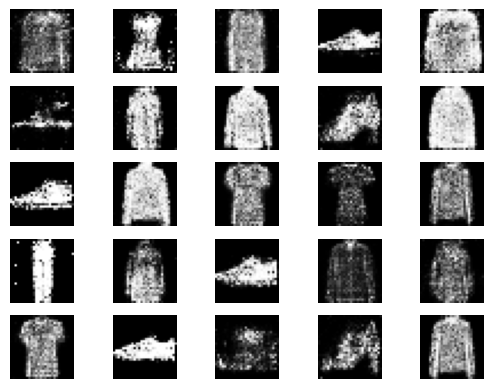

1/1 [==============================] - 0s 25ms/step
22601 [Discriminator loss: 0.583092, acc.: 62.50%] [Generator loss: 1.264311]
1/1 [==============================] - 0s 23ms/step
22602 [Discriminator loss: 0.541250, acc.: 70.31%] [Generator loss: 1.329827]
1/1 [==============================] - 0s 23ms/step
22603 [Discriminator loss: 0.653657, acc.: 64.06%] [Generator loss: 1.195862]
1/1 [==============================] - 0s 23ms/step
22604 [Discriminator loss: 0.526983, acc.: 73.44%] [Generator loss: 1.311317]
1/1 [==============================] - 0s 27ms/step
22605 [Discriminator loss: 0.563643, acc.: 78.12%] [Generator loss: 1.375538]
1/1 [==============================] - 0s 24ms/step
22606 [Discriminator loss: 0.563782, acc.: 65.62%] [Generator loss: 1.240839]
1/1 [==============================] - 0s 23ms/step
22607 [Discriminator loss: 0.470599, acc.: 78.12%] [Generator loss: 1.161460]
1/1 [==============================] - 0s 37ms/step
22608 [Discriminator loss: 0.605898, a

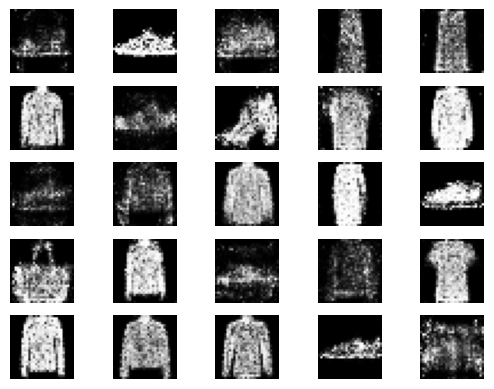

1/1 [==============================] - 0s 39ms/step
22801 [Discriminator loss: 0.522223, acc.: 75.00%] [Generator loss: 1.191539]
1/1 [==============================] - 0s 58ms/step
22802 [Discriminator loss: 0.596966, acc.: 65.62%] [Generator loss: 1.168802]
1/1 [==============================] - 0s 57ms/step
22803 [Discriminator loss: 0.591668, acc.: 62.50%] [Generator loss: 1.070775]
1/1 [==============================] - 0s 69ms/step
22804 [Discriminator loss: 0.589271, acc.: 60.94%] [Generator loss: 1.208283]
1/1 [==============================] - 0s 35ms/step
22805 [Discriminator loss: 0.579093, acc.: 71.88%] [Generator loss: 1.251767]
1/1 [==============================] - 0s 39ms/step
22806 [Discriminator loss: 0.638286, acc.: 57.81%] [Generator loss: 1.288223]
1/1 [==============================] - 0s 56ms/step
22807 [Discriminator loss: 0.626763, acc.: 62.50%] [Generator loss: 1.317007]
1/1 [==============================] - 0s 32ms/step
22808 [Discriminator loss: 0.504257, a

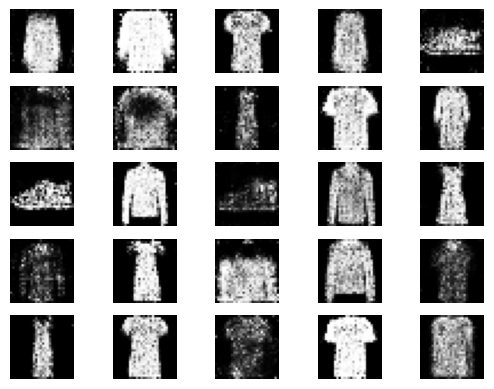

1/1 [==============================] - 0s 24ms/step
23001 [Discriminator loss: 0.556657, acc.: 67.19%] [Generator loss: 1.181990]
1/1 [==============================] - 0s 23ms/step
23002 [Discriminator loss: 0.643525, acc.: 67.19%] [Generator loss: 1.043194]
1/1 [==============================] - 0s 56ms/step
23003 [Discriminator loss: 0.571080, acc.: 70.31%] [Generator loss: 1.106492]
1/1 [==============================] - 0s 29ms/step
23004 [Discriminator loss: 0.503405, acc.: 71.88%] [Generator loss: 1.014072]
1/1 [==============================] - 0s 26ms/step
23005 [Discriminator loss: 0.590407, acc.: 65.62%] [Generator loss: 1.220856]
1/1 [==============================] - 0s 38ms/step
23006 [Discriminator loss: 0.593998, acc.: 68.75%] [Generator loss: 1.244836]
1/1 [==============================] - 0s 29ms/step
23007 [Discriminator loss: 0.524843, acc.: 71.88%] [Generator loss: 1.206308]
1/1 [==============================] - 0s 26ms/step
23008 [Discriminator loss: 0.426030, a

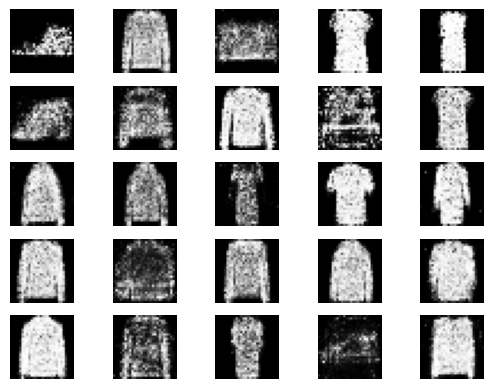

1/1 [==============================] - 0s 25ms/step
23201 [Discriminator loss: 0.593648, acc.: 59.38%] [Generator loss: 1.180511]
1/1 [==============================] - 0s 23ms/step
23202 [Discriminator loss: 0.561353, acc.: 62.50%] [Generator loss: 1.024520]
1/1 [==============================] - 0s 23ms/step
23203 [Discriminator loss: 0.460231, acc.: 81.25%] [Generator loss: 1.041861]
1/1 [==============================] - 0s 30ms/step
23204 [Discriminator loss: 0.672844, acc.: 56.25%] [Generator loss: 1.163924]
1/1 [==============================] - 0s 27ms/step
23205 [Discriminator loss: 0.512079, acc.: 75.00%] [Generator loss: 1.281024]
1/1 [==============================] - 0s 36ms/step
23206 [Discriminator loss: 0.530295, acc.: 67.19%] [Generator loss: 1.441765]
1/1 [==============================] - 0s 28ms/step
23207 [Discriminator loss: 0.459326, acc.: 79.69%] [Generator loss: 1.171942]
1/1 [==============================] - 0s 23ms/step
23208 [Discriminator loss: 0.588587, a

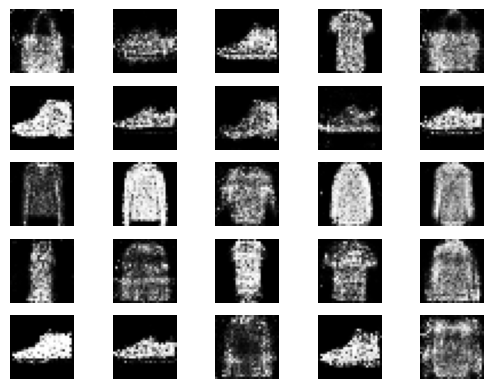

1/1 [==============================] - 0s 34ms/step
23401 [Discriminator loss: 0.508551, acc.: 76.56%] [Generator loss: 1.417299]
1/1 [==============================] - 0s 25ms/step
23402 [Discriminator loss: 0.699058, acc.: 57.81%] [Generator loss: 1.274903]
1/1 [==============================] - 0s 24ms/step
23403 [Discriminator loss: 0.606523, acc.: 65.62%] [Generator loss: 1.353050]
1/1 [==============================] - 0s 29ms/step
23404 [Discriminator loss: 0.551106, acc.: 68.75%] [Generator loss: 1.439602]
1/1 [==============================] - 0s 29ms/step
23405 [Discriminator loss: 0.559911, acc.: 71.88%] [Generator loss: 1.110750]
1/1 [==============================] - 0s 35ms/step
23406 [Discriminator loss: 0.586582, acc.: 65.62%] [Generator loss: 1.222579]
1/1 [==============================] - 0s 31ms/step
23407 [Discriminator loss: 0.549643, acc.: 70.31%] [Generator loss: 1.294839]
1/1 [==============================] - 0s 42ms/step
23408 [Discriminator loss: 0.500154, a

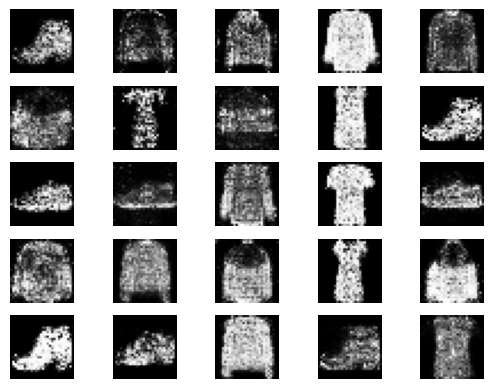

1/1 [==============================] - 0s 27ms/step
23601 [Discriminator loss: 0.479349, acc.: 76.56%] [Generator loss: 1.147892]
1/1 [==============================] - 0s 37ms/step
23602 [Discriminator loss: 0.520334, acc.: 73.44%] [Generator loss: 1.173415]
1/1 [==============================] - 0s 28ms/step
23603 [Discriminator loss: 0.515286, acc.: 75.00%] [Generator loss: 1.104384]
1/1 [==============================] - 0s 22ms/step
23604 [Discriminator loss: 0.581649, acc.: 68.75%] [Generator loss: 1.231926]
1/1 [==============================] - 0s 28ms/step
23605 [Discriminator loss: 0.574105, acc.: 71.88%] [Generator loss: 1.211788]
1/1 [==============================] - 0s 23ms/step
23606 [Discriminator loss: 0.614898, acc.: 59.38%] [Generator loss: 1.237639]
1/1 [==============================] - 0s 24ms/step
23607 [Discriminator loss: 0.597140, acc.: 71.88%] [Generator loss: 1.341640]
1/1 [==============================] - 0s 24ms/step
23608 [Discriminator loss: 0.485831, a

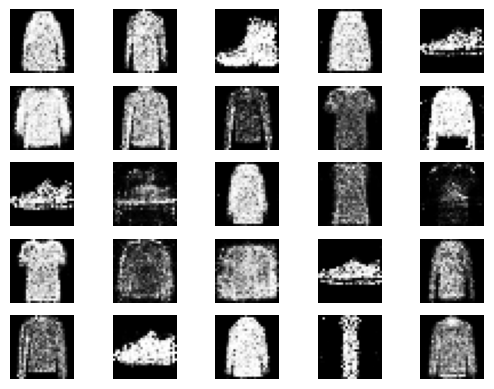

1/1 [==============================] - 0s 31ms/step
23801 [Discriminator loss: 0.658953, acc.: 57.81%] [Generator loss: 1.172992]
1/1 [==============================] - 0s 31ms/step
23802 [Discriminator loss: 0.563482, acc.: 67.19%] [Generator loss: 1.165066]
1/1 [==============================] - 0s 35ms/step
23803 [Discriminator loss: 0.636612, acc.: 59.38%] [Generator loss: 1.136331]
1/1 [==============================] - 0s 35ms/step
23804 [Discriminator loss: 0.647762, acc.: 59.38%] [Generator loss: 1.148370]
1/1 [==============================] - 0s 31ms/step
23805 [Discriminator loss: 0.581379, acc.: 68.75%] [Generator loss: 1.260880]
1/1 [==============================] - 0s 33ms/step
23806 [Discriminator loss: 0.495269, acc.: 71.88%] [Generator loss: 1.322375]
1/1 [==============================] - 0s 30ms/step
23807 [Discriminator loss: 0.499451, acc.: 76.56%] [Generator loss: 1.225964]
1/1 [==============================] - 0s 39ms/step
23808 [Discriminator loss: 0.489360, a

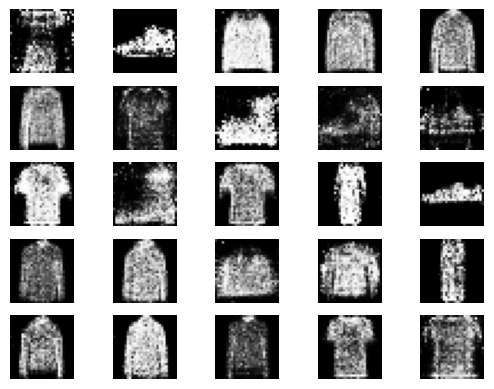

1/1 [==============================] - 0s 24ms/step
24001 [Discriminator loss: 0.489502, acc.: 71.88%] [Generator loss: 1.211279]
1/1 [==============================] - 0s 25ms/step
24002 [Discriminator loss: 0.568744, acc.: 70.31%] [Generator loss: 1.337269]
1/1 [==============================] - 0s 23ms/step
24003 [Discriminator loss: 0.622294, acc.: 62.50%] [Generator loss: 1.282365]
1/1 [==============================] - 0s 28ms/step
24004 [Discriminator loss: 0.549529, acc.: 71.88%] [Generator loss: 1.249808]
1/1 [==============================] - 0s 22ms/step
24005 [Discriminator loss: 0.477413, acc.: 81.25%] [Generator loss: 1.294844]
1/1 [==============================] - 0s 23ms/step
24006 [Discriminator loss: 0.578536, acc.: 64.06%] [Generator loss: 1.311345]
1/1 [==============================] - 0s 24ms/step
24007 [Discriminator loss: 0.603085, acc.: 64.06%] [Generator loss: 1.295472]
1/1 [==============================] - 0s 24ms/step
24008 [Discriminator loss: 0.594229, a

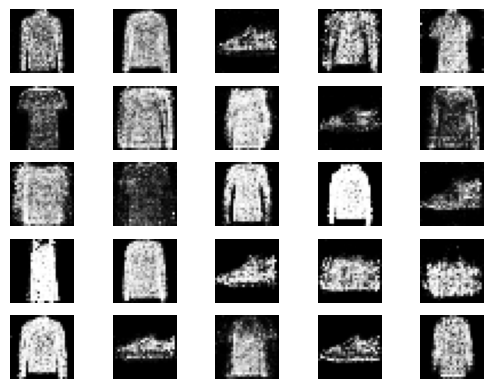

1/1 [==============================] - 0s 29ms/step
24201 [Discriminator loss: 0.565808, acc.: 62.50%] [Generator loss: 1.139507]
1/1 [==============================] - 0s 36ms/step
24202 [Discriminator loss: 0.507857, acc.: 75.00%] [Generator loss: 1.309151]
1/1 [==============================] - 0s 33ms/step
24203 [Discriminator loss: 0.596360, acc.: 65.62%] [Generator loss: 1.249995]
1/1 [==============================] - 0s 34ms/step
24204 [Discriminator loss: 0.569503, acc.: 76.56%] [Generator loss: 1.356842]
1/1 [==============================] - 0s 34ms/step
24205 [Discriminator loss: 0.580740, acc.: 64.06%] [Generator loss: 1.124433]
1/1 [==============================] - 0s 32ms/step
24206 [Discriminator loss: 0.584254, acc.: 62.50%] [Generator loss: 1.211657]
1/1 [==============================] - 0s 39ms/step
24207 [Discriminator loss: 0.539797, acc.: 71.88%] [Generator loss: 1.275745]
1/1 [==============================] - 0s 32ms/step
24208 [Discriminator loss: 0.469554, a

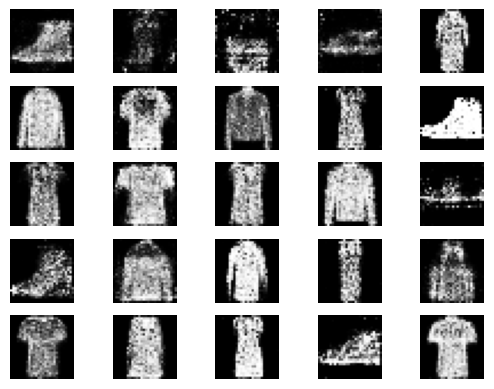

1/1 [==============================] - 0s 24ms/step
24401 [Discriminator loss: 0.607042, acc.: 68.75%] [Generator loss: 1.199830]
1/1 [==============================] - 0s 25ms/step
24402 [Discriminator loss: 0.588107, acc.: 68.75%] [Generator loss: 1.116525]
1/1 [==============================] - 0s 27ms/step
24403 [Discriminator loss: 0.558040, acc.: 68.75%] [Generator loss: 1.175488]
1/1 [==============================] - 0s 25ms/step
24404 [Discriminator loss: 0.541194, acc.: 71.88%] [Generator loss: 1.102352]
1/1 [==============================] - 0s 22ms/step
24405 [Discriminator loss: 0.590857, acc.: 67.19%] [Generator loss: 1.189327]
1/1 [==============================] - 0s 24ms/step
24406 [Discriminator loss: 0.622649, acc.: 68.75%] [Generator loss: 1.159353]
1/1 [==============================] - 0s 28ms/step
24407 [Discriminator loss: 0.567584, acc.: 70.31%] [Generator loss: 1.123589]
1/1 [==============================] - 0s 22ms/step
24408 [Discriminator loss: 0.539683, a

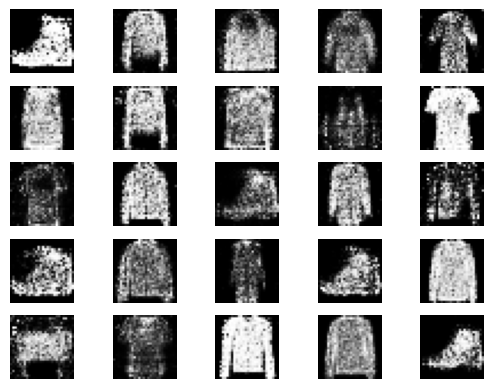

1/1 [==============================] - 0s 33ms/step
24601 [Discriminator loss: 0.531220, acc.: 73.44%] [Generator loss: 1.137823]
1/1 [==============================] - 0s 41ms/step
24602 [Discriminator loss: 0.492409, acc.: 76.56%] [Generator loss: 1.477650]
1/1 [==============================] - 0s 31ms/step
24603 [Discriminator loss: 0.513566, acc.: 70.31%] [Generator loss: 1.543437]
1/1 [==============================] - 0s 35ms/step
24604 [Discriminator loss: 0.511834, acc.: 71.88%] [Generator loss: 1.407620]
1/1 [==============================] - 0s 34ms/step
24605 [Discriminator loss: 0.473076, acc.: 76.56%] [Generator loss: 1.393495]
1/1 [==============================] - 0s 34ms/step
24606 [Discriminator loss: 0.612219, acc.: 65.62%] [Generator loss: 1.321642]
1/1 [==============================] - 0s 36ms/step
24607 [Discriminator loss: 0.505099, acc.: 76.56%] [Generator loss: 1.235363]
1/1 [==============================] - 0s 36ms/step
24608 [Discriminator loss: 0.488343, a

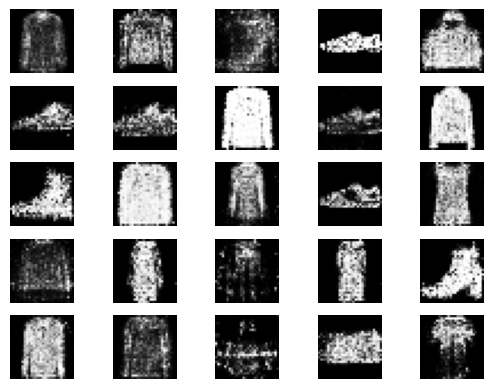

1/1 [==============================] - 0s 37ms/step
24801 [Discriminator loss: 0.468670, acc.: 76.56%] [Generator loss: 1.301952]
1/1 [==============================] - 0s 40ms/step
24802 [Discriminator loss: 0.668860, acc.: 50.00%] [Generator loss: 1.279106]
1/1 [==============================] - 0s 38ms/step
24803 [Discriminator loss: 0.513212, acc.: 71.88%] [Generator loss: 1.201762]
1/1 [==============================] - 0s 31ms/step
24804 [Discriminator loss: 0.637637, acc.: 60.94%] [Generator loss: 1.236316]
1/1 [==============================] - 0s 33ms/step
24805 [Discriminator loss: 0.527715, acc.: 76.56%] [Generator loss: 1.371140]
1/1 [==============================] - 0s 39ms/step
24806 [Discriminator loss: 0.506001, acc.: 73.44%] [Generator loss: 1.242291]
1/1 [==============================] - 0s 38ms/step
24807 [Discriminator loss: 0.466574, acc.: 78.12%] [Generator loss: 1.307544]
1/1 [==============================] - 0s 24ms/step
24808 [Discriminator loss: 0.540405, a

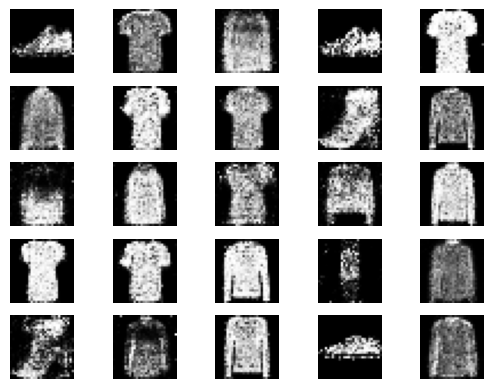

1/1 [==============================] - 0s 27ms/step
25001 [Discriminator loss: 0.540885, acc.: 73.44%] [Generator loss: 1.307565]
1/1 [==============================] - 0s 24ms/step
25002 [Discriminator loss: 0.497011, acc.: 70.31%] [Generator loss: 1.303759]
1/1 [==============================] - 0s 25ms/step
25003 [Discriminator loss: 0.668120, acc.: 60.94%] [Generator loss: 1.237343]
1/1 [==============================] - 0s 23ms/step
25004 [Discriminator loss: 0.593619, acc.: 65.62%] [Generator loss: 1.165553]
1/1 [==============================] - 0s 24ms/step
25005 [Discriminator loss: 0.517189, acc.: 78.12%] [Generator loss: 1.241560]
1/1 [==============================] - 0s 27ms/step
25006 [Discriminator loss: 0.485105, acc.: 76.56%] [Generator loss: 1.287266]
1/1 [==============================] - 0s 24ms/step
25007 [Discriminator loss: 0.447658, acc.: 78.12%] [Generator loss: 1.384731]
1/1 [==============================] - 0s 26ms/step
25008 [Discriminator loss: 0.485822, a

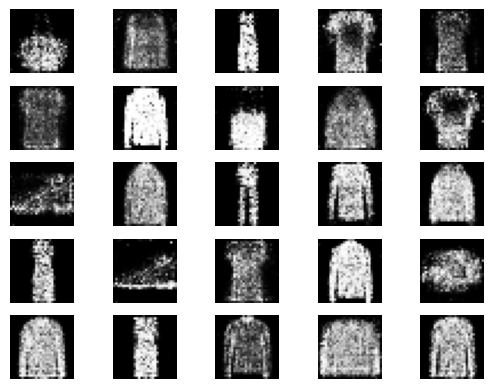

1/1 [==============================] - 0s 32ms/step
25201 [Discriminator loss: 0.602144, acc.: 64.06%] [Generator loss: 1.269800]
1/1 [==============================] - 0s 29ms/step
25202 [Discriminator loss: 0.570538, acc.: 65.62%] [Generator loss: 1.193781]
1/1 [==============================] - 0s 49ms/step
25203 [Discriminator loss: 0.570436, acc.: 70.31%] [Generator loss: 1.243925]
1/1 [==============================] - 0s 34ms/step
25204 [Discriminator loss: 0.592576, acc.: 67.19%] [Generator loss: 1.456663]
1/1 [==============================] - 0s 37ms/step
25205 [Discriminator loss: 0.597135, acc.: 64.06%] [Generator loss: 1.305243]
1/1 [==============================] - 0s 46ms/step
25206 [Discriminator loss: 0.564305, acc.: 68.75%] [Generator loss: 1.199340]
1/1 [==============================] - 0s 31ms/step
25207 [Discriminator loss: 0.536930, acc.: 73.44%] [Generator loss: 1.149345]
1/1 [==============================] - 0s 34ms/step
25208 [Discriminator loss: 0.572960, a

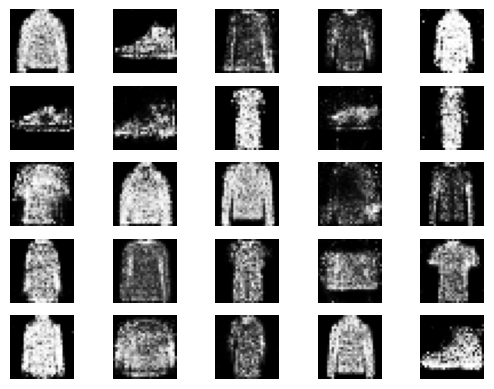

1/1 [==============================] - 0s 25ms/step
25401 [Discriminator loss: 0.572542, acc.: 70.31%] [Generator loss: 1.361549]
1/1 [==============================] - 0s 48ms/step
25402 [Discriminator loss: 0.514660, acc.: 70.31%] [Generator loss: 1.266366]
1/1 [==============================] - 0s 60ms/step
25403 [Discriminator loss: 0.497755, acc.: 68.75%] [Generator loss: 1.341794]
1/1 [==============================] - 0s 34ms/step
25404 [Discriminator loss: 0.577981, acc.: 71.88%] [Generator loss: 1.231457]
1/1 [==============================] - 0s 37ms/step
25405 [Discriminator loss: 0.599082, acc.: 70.31%] [Generator loss: 1.271309]
1/1 [==============================] - 0s 28ms/step
25406 [Discriminator loss: 0.530272, acc.: 76.56%] [Generator loss: 1.342717]
1/1 [==============================] - 0s 30ms/step
25407 [Discriminator loss: 0.547043, acc.: 70.31%] [Generator loss: 1.306174]
1/1 [==============================] - 0s 25ms/step
25408 [Discriminator loss: 0.501500, a

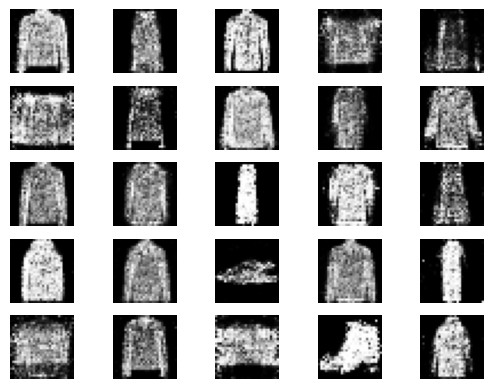

1/1 [==============================] - 0s 43ms/step
25601 [Discriminator loss: 0.573387, acc.: 73.44%] [Generator loss: 1.193509]
1/1 [==============================] - 0s 40ms/step
25602 [Discriminator loss: 0.523537, acc.: 76.56%] [Generator loss: 1.353662]
1/1 [==============================] - 0s 37ms/step
25603 [Discriminator loss: 0.622729, acc.: 68.75%] [Generator loss: 1.269008]
1/1 [==============================] - 0s 34ms/step
25604 [Discriminator loss: 0.502161, acc.: 78.12%] [Generator loss: 1.493021]
1/1 [==============================] - 0s 34ms/step
25605 [Discriminator loss: 0.663687, acc.: 68.75%] [Generator loss: 1.219138]
1/1 [==============================] - 0s 33ms/step
25606 [Discriminator loss: 0.519750, acc.: 70.31%] [Generator loss: 1.401045]
1/1 [==============================] - 0s 30ms/step
25607 [Discriminator loss: 0.505986, acc.: 81.25%] [Generator loss: 1.174619]
1/1 [==============================] - 0s 29ms/step
25608 [Discriminator loss: 0.504069, a

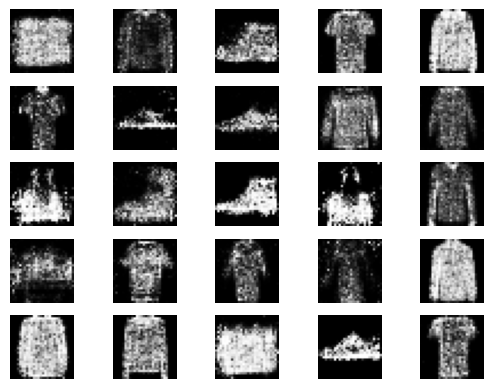

1/1 [==============================] - 0s 39ms/step
25801 [Discriminator loss: 0.630689, acc.: 65.62%] [Generator loss: 1.204584]
1/1 [==============================] - 0s 36ms/step
25802 [Discriminator loss: 0.604712, acc.: 70.31%] [Generator loss: 1.359821]
1/1 [==============================] - 0s 24ms/step
25803 [Discriminator loss: 0.592397, acc.: 65.62%] [Generator loss: 1.274364]
1/1 [==============================] - 0s 25ms/step
25804 [Discriminator loss: 0.541324, acc.: 76.56%] [Generator loss: 1.182613]
1/1 [==============================] - 0s 23ms/step
25805 [Discriminator loss: 0.637192, acc.: 60.94%] [Generator loss: 1.287742]
1/1 [==============================] - 0s 32ms/step
25806 [Discriminator loss: 0.530775, acc.: 78.12%] [Generator loss: 1.118917]
1/1 [==============================] - 0s 24ms/step
25807 [Discriminator loss: 0.600216, acc.: 65.62%] [Generator loss: 1.159948]
1/1 [==============================] - 0s 23ms/step
25808 [Discriminator loss: 0.550299, a

In [ ]:
train(generator,discriminator,gan_model,epochs=30000, batch_size=32, sample_interval=200)


In [107]:
import os

file_path = '/content/drive/MyDrive/0.png'

if os.path.exists(file_path):
    print(f"The file '{file_path}' exists.")
else:
    print(f"The file '{file_path}' does not exist.")

The file '/content/drive/MyDrive/0.png' exists.


In [106]:
import os

file_path = '/content/drive/MyDrive/0.png'
dir_path = os.path.dirname(file_path)

os.makedirs(dir_path, exist_ok=True)

with open(file_path, 'w') as f:
    f.write('Hello, World!')